C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


<bound method Dataset.info of <xarray.Dataset>
Dimensions:  (time: 3782, lon: 161, lat: 161)
Coordinates:
  * time     (time) datetime64[ns] 1990-03-01 1990-03-02 ... 2020-06-30T11:30:00
  * lon      (lon) float64 60.0 60.25 60.5 60.75 61.0 ... 99.25 99.5 99.75 100.0
  * lat      (lat) float64 0.0 0.25 0.5 0.75 1.0 ... 39.0 39.25 39.5 39.75 40.0
Data variables:
    utci     (time, lat, lon) float32 ...
Attributes:
    CDI:          Climate Data Interface version 1.9.9rc1 (https://mpimet.mpg...
    Conventions:  CF-1.6
    history:      Wed Jan 03 16:30:51 2024: cdo invertlat utci_daily.nc utci_...
    CDO:          Climate Data Operators version 1.9.9rc1 (https://mpimet.mpg...>


In [ ]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspace
ds = xr.open_dataset('utci_daily.nc')
print(ds.info)

In [6]:
print(ds.utci)

<xarray.DataArray 'utci' (time: 3782, lat: 161, lon: 161)>
[98033222 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 1990-03-01 1990-03-02 ... 2020-06-30T11:30:00
  * lon      (lon) float64 60.0 60.25 60.5 60.75 61.0 ... 99.25 99.5 99.75 100.0
  * lat      (lat) float64 0.0 0.25 0.5 0.75 1.0 ... 39.0 39.25 39.5 39.75 40.0


In [27]:
import netCDF4 as nc4            # to work with netCDFs
import numpy   as np             # to perform numerics
import time
ncid = nc4.Dataset('utci_daily.nc', 'r')
#print(ncid)
print(ds.variables)
import cartopy.crs as ccrs
import matplotlib.pyplot as plt

Frozen({'time': <xarray.IndexVariable 'time' (time: 3782)>
array(['1990-03-01T00:00:00.000000000', '1990-03-02T00:00:00.000000000',
       '1990-03-03T00:00:00.000000000', ..., '2020-06-28T11:30:00.000000000',
       '2020-06-29T11:30:00.000000000', '2020-06-30T11:30:00.000000000'],
      dtype='datetime64[ns]')
Attributes:
    standard_name:  time
    axis:           T, 'lon': <xarray.IndexVariable 'lon' (lon: 161)>
array([ 60.  ,  60.25,  60.5 ,  60.75,  61.  ,  61.25,  61.5 ,  61.75,  62.  ,
        62.25,  62.5 ,  62.75,  63.  ,  63.25,  63.5 ,  63.75,  64.  ,  64.25,
        64.5 ,  64.75,  65.  ,  65.25,  65.5 ,  65.75,  66.  ,  66.25,  66.5 ,
        66.75,  67.  ,  67.25,  67.5 ,  67.75,  68.  ,  68.25,  68.5 ,  68.75,
        69.  ,  69.25,  69.5 ,  69.75,  70.  ,  70.25,  70.5 ,  70.75,  71.  ,
        71.25,  71.5 ,  71.75,  72.  ,  72.25,  72.5 ,  72.75,  73.  ,  73.25,
        73.5 ,  73.75,  74.  ,  74.25,  74.5 ,  74.75,  75.  ,  75.25,  75.5 ,
        75.75,  76.  ,  76

In [13]:
import netCDF4 as nc

# Load the NetCDF dataset
ncset = nc.Dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_daily.nc')

# Check if 'utci' variable exists in the dataset
if 'utci' in ncset.variables:
    utci_var = ncset.variables['utci']

    # Spatial Resolution (assuming latitude and longitude dimensions)
    if 'lat' in utci_var.dimensions and 'lon' in utci_var.dimensions:
        lat = ncset.variables['lat'][:]
        lon = ncset.variables['lon'][:]
        spatial_resolution = (lat[1] - lat[0], lon[1] - lon[0])  # Assuming regular grid
        print("Spatial Resolution (degrees):", spatial_resolution)

    # Temporal Resolution (assuming time dimension)
    if 'time' in utci_var.dimensions:
        time = ncset.variables['time'][:]
        temporal_resolution = time[1] - time[0]  # Assuming regular time steps
        print("Temporal Resolution:", temporal_resolution, "days")

    # Check for resolution attribute if available
    if 'resolution' in utci_var.ncattrs():
        resolution_info = utci_var.getncattr('resolution')
        print("Resolution Information:", resolution_info)

else:
    print("Variable 'utci' does not exist in the dataset.")

# Close the dataset
ncset.close()


Spatial Resolution (degrees): (0.25, 0.25)
Temporal Resolution: 1.0 days


In [16]:
a= 0.25*111.045
b= 0.25*87.87
print(a,b)

27.76125 21.9675


In [ ]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspec

# Open the .nc file
ds1 = xr.open_dataset('cru_ts4.07.2001.2010.tmp.dat.nc')
ds2 = xr.open_dataset('cru_ts4.07.2011.2020.tmp.dat.nc')

# Select the precipitation variable
t1 = ds1['tmp']
t2 = ds2['tmp']
mm = 'degc'
nn = 'Temperature (degc/day)'

# Create a gridspec
fig = plt.figure(figsize=(10, 6))
gs = gridspec.GridSpec(2, 2, width_ratios=[1, 1])

# Plot the precipitation data for a specific time period (e.g., 2001)
t1_time1 = t1.sel(time=slice('2001-01-01', '2010-12-31'))
t2_time2 = t2.sel(time=slice('2011-01-01', '2020-12-31'))

# Define the difference of two decades
cn = t1_time1.mean(dim='time') - t2_time2.mean(dim='time')

# Plotting mean precipitation over time
ax1 = plt.subplot(gs[0, 0])
pcm1 = ax1.pcolormesh(t1_time1.lon, t1_time1.lat, t1_time1.mean(dim='time'), cmap='Blues')

ax2 = plt.subplot(gs[0, 1])
pcm2 = ax2.pcolormesh(t2_time2.lon, t2_time2.lat, t2_time2.mean(dim='time'), cmap='jet')

# Plot in the first subplot (top-left)
ax1.set_title('Mean Temperature (2001-2010)\n' + mm, fontsize=6)
ax1.set_ylabel('Temperature (degc/day)')
ax1.set_xlabel('Latitude')
ax1.text(0.4521, 0.9, 'decade of 2001-10', color='m', fontsize=9, transform=ax1.transAxes, ha='right', va='bottom')

# Plot in the second subplot (top-right)
ax2.set_title('Mean Temperature (2010-2020)\n' + mm, fontsize=6)
ax2.set_ylabel('Temperature (degc/day)')
ax2.set_xlabel('Latitude')
ax2.text(0.615721, 0.12, 'decade of 2010-20', color='darkred', fontsize=12, transform=ax2.transAxes, ha='right', va='bottom')

# Plot in the third subplot (center of the second row, spanning both columns)
ax3 = plt.subplot(gs[1, :])
pcm3 = ax3.pcolormesh(t1_time1.lon, t1_time1.lat, cn, cmap='bwr')

# Remove x-axis ticks for the third subplot
ax3.set_title('Difference (2001-2010) - (2011-2020)\n' + mm, fontsize=10)
ax3.set_ylabel('Temperature (degc/day)')
ax3.set_xlabel('Latitude')
ax3.text(0.41, 0.907, 'TEMP diff of decades 2001-2020', color='k', fontsize=10, transform=ax3.transAxes, ha='right', va='bottom')

# Add colorbar with label
cbar = plt.colorbar(pcm1, ax=[ax1, ax2, ax3], label=nn)

# Add text annotations
plt.text(0.5, -0.05, 'Data source: TEMP', fontsize=8, transform=fig.transFigure, ha='center')
plt.xlabel('Longitude\n' + nn, fontsize=6)
plt.ylabel('Latitude')

plt.show()

In [7]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs

# Load the dataset
ds = xr.open_dataset('utci_daily.nc')

# Extract data for different time periods
utci = ds['utci']
utci_time1 = utci.sel(time=slice('1990-03-01', '1999-06-30')).mean(dim='time') - 273.16
utci_time2 = utci.sel(time=slice('2000-03-01', '2009-06-30')).mean(dim='time') - 273.16
utci_time3 = utci.sel(time=slice('2010-03-01', '2020-06-30')).mean(dim='time') - 273.16
utci_time4 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time') - 273.16

# Calculate the trend
trend1 = utci_time2 - utci_time1
trend2 = utci_time3 - utci_time2
trend = trend1 + trend2

# Create a gridspec
fig = plt.figure(figsize=(10, 14))
gs = gridspec.GridSpec(1, 1, width_ratios=[1, 1])

# Plotting UTCI for different time periods
ax1 = plt.subplot(gs[0, 0], projection=ccrs.PlateCarree())
pcm1 = ax1.pcolormesh(utci_time1.lon, utci_time1.lat, utci_time1, cmap='jet')
ax1.coastlines()
ax1.set_title('Mean UTCI (1990-1999)')
ax1.set_ylabel('Latitude')
ax1.set_xlabel('Longitude')

ax2 = plt.subplot(gs[0, 1], projection=ccrs.PlateCarree())
pcm2 = ax2.pcolormesh(utci_time2.lon, utci_time2.lat, utci_time2, cmap='jet')
ax2.coastlines()
ax2.set_title('Mean UTCI (2000-2009)')
ax2.set_ylabel('Latitude')
ax2.set_xlabel('Longitude')

ax3 = plt.subplot(gs[1, 0], projection=ccrs.PlateCarree())
pcm3 = ax3.pcolormesh(utci_time3.lon, utci_time3.lat, utci_time3, cmap='jet')
ax3.coastlines()
ax3.set_title('Mean UTCI (2010-2020)')
ax3.set_ylabel('Latitude')
ax3.set_xlabel('Longitude')

ax4 = plt.subplot(gs[1, 1], projection=ccrs.PlateCarree())
pcm4 = ax4.pcolormesh(utci_time4.lon, utci_time4.lat, utci_time4, cmap='jet')
ax4.coastlines()
ax4.set_title('Mean UTCI (1990-2020)')
ax4.set_ylabel('Latitude')
ax4.set_xlabel('Longitude')

ax5 = plt.subplot(gs[2, 0], projection=ccrs.PlateCarree())
pcm5 = ax5.pcolormesh(trend.lon, trend.lat, trend, cmap='jet')
ax5.coastlines()
ax5.set_title('UTCI Trend (1990-2020)')
ax5.set_ylabel('Latitude')
ax5.set_xlabel('longitude')

# Add colorbar
cbar = plt.colorbar(pcm1, ax=[ax1, ax2, ax3, ax4], orientation='horizontal', pad=0.08)
cbar.set_label('UTC (°K/day)')
cbar = plt.colorbar(pcm5, ax=[ax5], orientation='horizontal', pad=0.08)
cbar.set_label('UTC (°K/day)')

# Add line graphs
ax6 = plt.subplot(gs[2, 1])
time_values = np.arange(len(utci_time1))
ax6.plot(time_values, utci_time1, label='1990-1999')
ax6.plot(time_values, utci_time2, label='2000-2009')
ax6.plot(time_values, utci_time3, label='2010-2020')
ax6.plot(time_values, utci_time4, label='1990-2020')
ax6.set_title('Mean UTCI Over Time')
ax6.set_xlabel('Time')
ax6.set_ylabel('Mean UTCI')
ax6.legend()

# Add text annotations
plt.text(0.5, -0.05, 'Data source: UTCI', fontsize=8, transform=fig.transFigure, ha='center')

plt.show()


FileNotFoundError: [Errno 2] No such file or directory: '/home/swami/work/utci_daily.nc'

In [28]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature

# Load the dataset
ds = xr.open_dataset('utci_daily.nc')

# Extract data for different time periods
utci = ds['utci']
utci_time1 = utci.sel(time=slice('1990-03-01', '1999-06-30')).mean(dim='time') - 273.16
utci_time2 = utci.sel(time=slice('2000-03-01', '2009-06-30')).mean(dim='time') - 273.16
utci_time3 = utci.sel(time=slice('2010-03-01', '2020-06-30')).mean(dim='time') - 273.16
utci_time4 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time') - 273.16

print(ds)

<xarray.Dataset>
Dimensions:  (time: 3782, lon: 161, lat: 161)
Coordinates:
  * time     (time) datetime64[ns] 1990-03-01 1990-03-02 ... 2020-06-30T11:30:00
  * lon      (lon) float64 60.0 60.25 60.5 60.75 61.0 ... 99.25 99.5 99.75 100.0
  * lat      (lat) float64 0.0 0.25 0.5 0.75 1.0 ... 39.0 39.25 39.5 39.75 40.0
Data variables:
    utci     (time, lat, lon) float32 ...
Attributes:
    CDI:          Climate Data Interface version 1.9.9rc1 (https://mpimet.mpg...
    Conventions:  CF-1.6
    history:      Wed Jan 03 16:30:51 2024: cdo invertlat utci_daily.nc utci_...
    CDO:          Climate Data Operators version 1.9.9rc1 (https://mpimet.mpg...


C:\Users\S Narayanaswami\AppData\Local\Temp\ipykernel_2760\1707973326.py:36: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax1 = plt.subplot(gs[0, 0])
C:\Users\S Narayanaswami\AppData\Local\Temp\ipykernel_2760\1707973326.py:38: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax2 = plt.subplot(gs[0, 1])
C:\Users\S Narayanaswami\AppData\Local\Temp\ipykernel_2760\1707973326.py:40: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax3 = plt.subplot(gs[1, 0])
C:\Users\S Narayanaswami\AppData\Local\Temp\ipykernel_2760\1707973326.py:42: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6

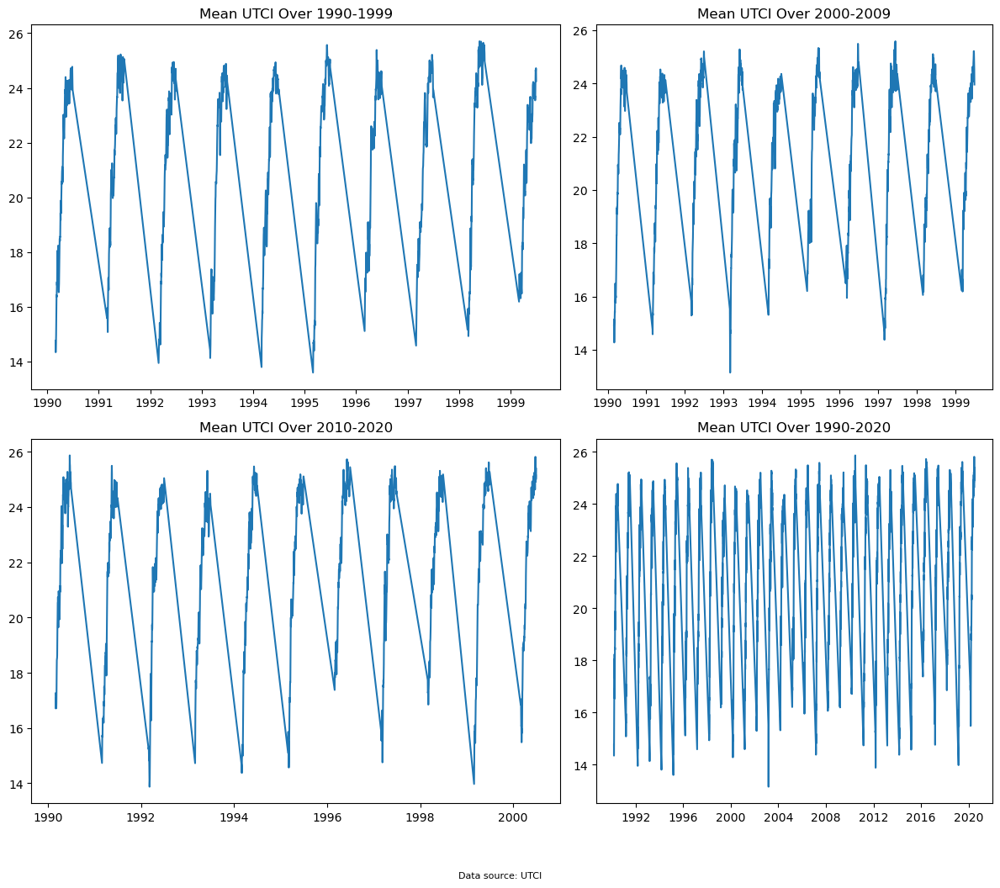

In [44]:
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import numpy as np
import pandas as pd

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_daily.nc')

# Extract data for different time periods
utci = ds['utci'] - 273.16
time = ds['time']

utci1 = utci.sel(time=slice('1990-03-01', '1999-06-30')).mean(dim=('lat', 'lon'))
utci2 = utci.sel(time=slice('2000-03-01', '2009-06-30')).mean(dim=('lat', 'lon'))
utci3 = utci.sel(time=slice('2010-03-01', '2020-06-30')).mean(dim=('lat', 'lon'))
utci4 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim=('lat', 'lon'))

# Convert the time data to a normal 24-hour time format
time = pd.to_datetime(ds.time.values)  # Convert time values to datetime
time_hours = time.hour + time.minute / 60.0  # Extract hours and minutes as decimal hours
time_reversed = time_hours[::-1]  # Reverse the time array if needed

# Slice time_hours based on the y variables
utci1_time_hours = time[:len(utci1)]
utci2_time_hours = time[:len(utci2)]
utci3_time_hours = time[:len(utci3)]
utci4_time_hours = time[:len(utci4)]
#utci4_time_hours = time_hours[:len(utci4)]

# Create an array of dates for x-axis
fig, axs = plt.subplots(nrows=2, ncols=2, figsize=(12, 10))
gs = gridspec.GridSpec(2, 2, width_ratios=[4, 3])

# Add line graphs using sliced time_hours
ax1 = plt.subplot(gs[0, 0])
ax1.plot(utci1_time_hours, utci1, label='1990-1999')
ax2 = plt.subplot(gs[0, 1])
ax2.plot(utci2_time_hours, utci2, label='2000-2009')
ax3 = plt.subplot(gs[1, 0])
ax3.plot(utci3_time_hours, utci3, label='2010-2020')
ax4 = plt.subplot(gs[1, 1])
ax4.plot(utci4_time_hours, utci4, label='1990-2020')

# Set title for each subplot
ax1.set_title('Mean UTCI Over 1990-1999')
ax2.set_title('Mean UTCI Over 2000-2009')
ax3.set_title('Mean UTCI Over 2010-2020')
ax4.set_title('Mean UTCI Over 1990-2020')

# Set common labels
for ax in axs.flat:
    ax.set_xlabel('Time (hours)')
    ax.set_ylabel('Mean UTCI')
    ax.legend()

# Adjust layout and spacing
plt.tight_layout()

# Add text annotations
plt.text(0.5, -0.05, 'Data source: UTCI', fontsize=8, transform=fig.transFigure, ha='center')

# Save figure or display
plt.savefig("C:/Users/S Narayanaswami/OneDrive/Desktop/summer/sumr_work_fig/utci_mean_line_plot.png", dpi=300)
plt.show()


NameError: name 'cbar' is not defined

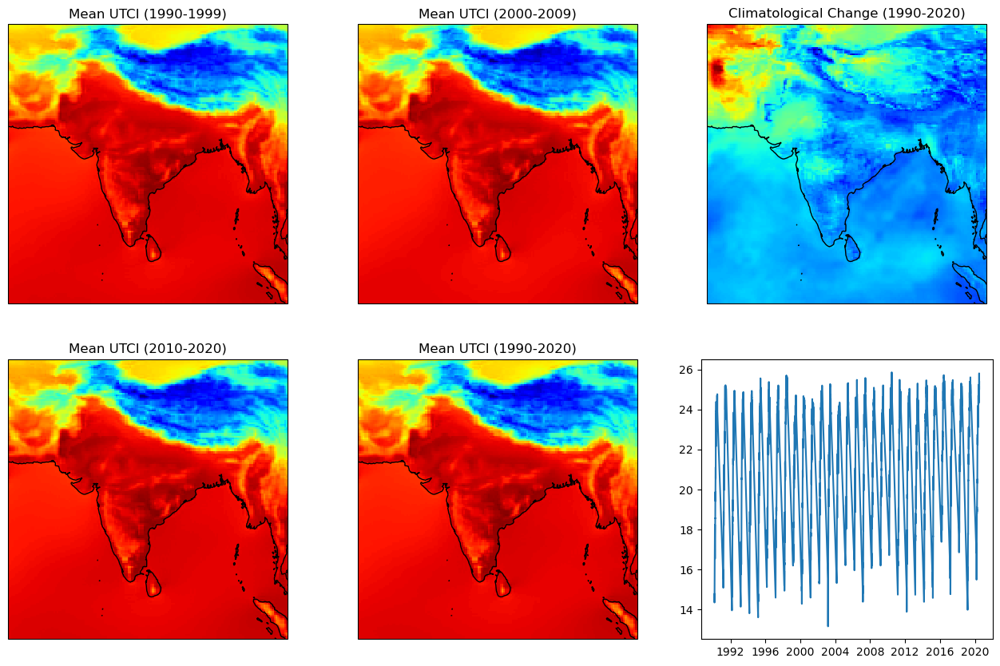

In [132]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_daily.nc')

# Extract data for different time periods
utci = ds['utci'] - 273.16
time = ds['time']

utci_time1 = utci.sel(time=slice('1990-03-01', '1999-06-30')).mean(dim='time')
utci_time2 = utci.sel(time=slice('2000-03-01', '2009-06-30')).mean(dim='time')
utci_time3 = utci.sel(time=slice('2010-03-01', '2020-06-30')).mean(dim='time')
utci_time4 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')
utci44 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim=('lat', 'lon'))

# Convert the time data to a normal 24-hour time format
time = pd.to_datetime(ds.time.values)  # Convert time values to datetime
time_hours = time.hour + time.minute / 60.0  # Extract hours and minutes as decimal hours
time_reversed = time_hours[::-1]  # Reverse the time array if needed

# Slice time_hours based on the y variables
utci1_time_hours = time[:len(utci_time1)]
utci2_time_hours = time[:len(utci_time2)]
utci3_time_hours = time[:len(utci_time3)]
utci4_time_hours = time[:len(utci44)]
#utci4_time_hours = time_hours[:len(utci4)]

# utci_time11 = ds['utci'].sel(time=slice('1990-03-01', '1999-06-30'))# - 273.16

# utci1= np.mean((utci_time11), axis=(1, 2))
# Calculate the trend
trend1 = utci_time2 - utci_time1
trend2 = utci_time3 - utci_time2
trend = trend1 + trend2

# Create a gridspec
fig = plt.figure(figsize=(16, 10))
gs = gridspec.GridSpec(2, 3, width_ratios=[4, 4, 4])
# Plotting UTCI for different time periods
ax1 = plt.subplot(gs[0, 0], projection=ccrs.PlateCarree())
pcm1 = ax1.pcolormesh(utci_time1.lon, utci_time1.lat, utci_time1, cmap='jet')
ax1.coastlines()
ax1.set_title('Mean UTCI (1990-1999)')
ax1.set_ylabel('Latitude')
ax1.set_xlabel('Longitude')

ax2 = plt.subplot(gs[0, 1], projection=ccrs.PlateCarree())
pcm2 = ax2.pcolormesh(utci_time2.lon, utci_time2.lat, utci_time2, cmap='jet')
ax2.coastlines()
ax2.set_title('Mean UTCI (2000-2009)')
ax2.set_ylabel('Latitude')
ax2.set_xlabel('Longitude')

ax3 = plt.subplot(gs[1, 0], projection=ccrs.PlateCarree())
pcm3 = ax3.pcolormesh(utci_time3.lon, utci_time3.lat, utci_time3, cmap='jet')
ax3.coastlines()
ax3.set_title('Mean UTCI (2010-2020)')
ax3.set_ylabel('Latitude')
ax3.set_xlabel('Longitude')

ax4 = plt.subplot(gs[1, 1], projection=ccrs.PlateCarree())
pcm4 = ax4.pcolormesh(utci_time4.lon, utci_time4.lat, utci_time4, cmap='jet')
ax4.coastlines()
ax4.set_title('Mean UTCI (1990-2020)')
ax4.set_ylabel('Latitude')
ax4.set_xlabel('Longitude')

ax5 = plt.subplot(gs[0, 2], projection=ccrs.PlateCarree())
pcm5 = ax5.pcolormesh(trend.lon, trend.lat, trend, cmap='jet')
ax5.coastlines()
ax5.set_title('Climatological Change (1990-2020)')
ax5.set_ylabel('Latitude')
ax5.set_xlabel('longitude')

ax6 = plt.subplot(gs[1, 2])
ax6.plot(utci4_time_hours, utci44, label='1990-2020')
#ax6.set_title('Mean UTCI Over Time')
# cbar = plt.colorbar(pcm6, ax=[ax6], orientation='horizontal', pad=0.08)
# Add line graphs
# ax6 = plt.subplot(gs[1, 2], projection=ccrs.PlateCarree())
# time_values = np.arange(len(utci_time1))
# ax6.plot(utci1, label='none')
# ax6.plot(time_values, utci_time2, l)abel='2000-2009')
# ax6.plot(time_values, utci_time3, label='2010-2020')
# ax6.plot(time_values, utci_time4, label='1990-2020')
# cbar = plt.colorbar(time_values, ax=[ax6], orientation='horizontal', pad=0.08)
cbar.set_label('UTC (°c/day)')
ax6.set_title('Climatological UTCI')
ax6.set_xlabel('Time')
ax6.set_ylabel('Mean UTCI')
ax6.legend()
# Add colorbar
#cbar = plt.colorbar(pcm1, ax=[ax1, ax2, ax3, ax4], orientation='horizontal', extend='both', pad=0, shrink=0.8704, aspect=140)#, location='bottom')
#cbar.set_label('UTC (°c/day)')
#cbar = plt.colorbar(pcm5, ax=[ax5], orientation='vertical',  extend='both', pad=0, shrink=0.7487)#, location='right')
#plt.colorbar(pcm5, shrink=0.5, aspect=20)
#cbar.set_label('UTC (°K/day)')
#fig.colorbar(pcm, ax=axs[0, :2], shrink=0.6, location='bottom')
#fig.colorbar(pcm, ax=[axs[0, 2]], location='bottom')
#fig.colorbar(pcm, ax=axs[1:, :], location='right', shrink=0.6)
#fig.colorbar(pcm, ax=[axs[2, 1]], location='left')
# Add line graphs
#utci1=utci1.sel(time=slice('1990-03-01', '1999-06-30'))
#pcm6=np.mean(utci1, axis=(1,2))
#utci_daily_avg = utci
# Adjust layout and spacing
#plt.tight_layout()
# Add text annotations
plt.text(0.5115, 0.00001, 'Data source: ERA5 UTCIvariable', fontsize=8, transform=fig.transFigure, ha='center')

# monthly_counts = merged_df.groupby('Month').size()
# monthly_counts
# fig, ax = plt.subplots(1, 1)
# fig.set_size_inches(15,7)
# monthly_counts.plot(kind='bar', ax=ax)
# plt.show()
# fig, ax = plt.subplots(1, 1)
# fig.set_size_inches(15,7)

# monthly_counts.plot(kind='bar', ax=ax)
# monthly_counts.plot(kind='line', ax=ax, color='red', marker='o')

# ax.set_title('Total Crime by Month')
# ax.set_ylabel('Total Incidents')

# plt.show()

# # Add text annotations
# plt.text(0.5, -0.05, 'Data source: UTCI', fontsize=8, transform=fig.transFigure, ha='center')

# plt.show()
# line graphs using sliced time_hours
#ax1 = plt.subplot(gs[0, 0])
#ax1.plot(utci1_time_hours, utci1, label='1990-1999')
#ax2 = plt.subplot(gs[0, 1])
#ax2.plot(utci2_time_hours, utci2, label='2000-2009')
#ax3 = plt.subplot(gs[1, 0])
#ax3.plot(utci3_time_hours, utci3, label='2010-2020')
#ax4 = plt.subplot(gs[1, 1])
#ax4.plot(utci4_time_hours, utci4, label='1990-2020')

# Set title for each subplot
#ax1.set_title('Mean UTCI Over 1990-1999')
#ax2.set_title('Mean UTCI Over 2000-2009')
#x3.set_title('Mean UTCI Over 2010-2020')
#ax4.set_title('Mean UTCI Over 1990-2020')

# Set common labels
#for ax in axs.flat:
#    ax.set_xlabel('Time (hours)')
#    ax.set_ylabel('Mean UTCI')
#    ax.legend()



# Add text annotations
#plt.text(0.5, -0.05, 'Data source: UTCI', fontsize=8, transform=fig.transFigure, ha='center')

# Save figure or display
plt.savefig("C:/Users/S Narayanaswami/OneDrive/Desktop/summer/sumr_work_fig/utci_mean_spatiial_line_plot.png", dpi=300)
plt.show()


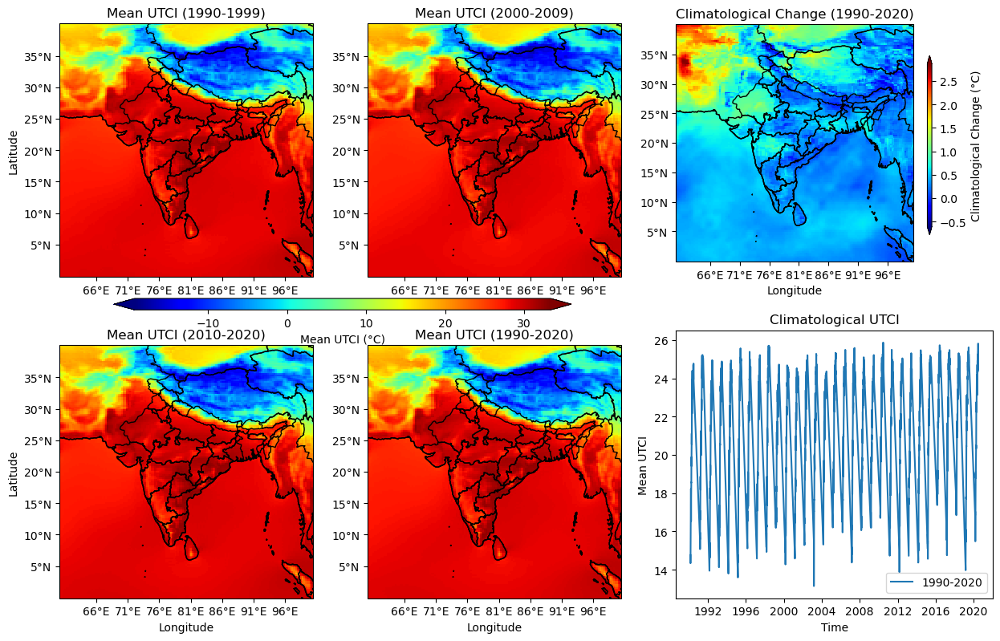

In [131]:
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import pandas as pd
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io import shapereader as shpreader
from cartopy.feature import ShapelyFeature
from cartopy.io.shapereader import Reader

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_daily.nc')

# Extract data for different time periods
utci = ds['utci'] - 273.16
time = ds['time']

utci_time1 = utci.sel(time=slice('1990-03-01', '1999-06-30')).mean(dim='time')
utci_time2 = utci.sel(time=slice('2000-03-01', '2009-06-30')).mean(dim='time')
utci_time3 = utci.sel(time=slice('2010-03-01', '2020-06-30')).mean(dim='time')
utci_time4 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')
utci44 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim=('lat', 'lon'))

# Convert the time data to a normal 24-hour time format
time = pd.to_datetime(ds.time.values)
time_hours = time.hour + time.minute / 60.0
time_reversed = time_hours[::-1]

# Create a gridspec
#fig = plt.figure(figsize=(16, 10))
fig = plt.figure(figsize=(15, 8.35))
gs = gridspec.GridSpec(2, 3, width_ratios=[4, 4, 5])
# Generate your plot here
#plt.figure(figsize=(10, 6))  # Adjust figsize as needed for your plot
#plt.plot([1, 2, 3, 4], [1, 4, 9, 16], 'bo-')  # Example plot

# Plotting UTCI for different time periods
ax1 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
pcm1 = ax1.pcolormesh(utci_time1.lon, utci_time1.lat, utci_time1, cmap='jet')
ax1.coastlines()
ax1.set_title('Mean UTCI (1990-1999)')
ax1.set_ylabel('Latitude')
#ax1.set_xlabel('Longitude')
ax1.annotate('', (4, 4), xycoords='axes fraction', va='center')

ax2 = fig.add_subplot(gs[0, 1], projection=ccrs.PlateCarree())
pcm2 = ax2.pcolormesh(utci_time2.lon, utci_time2.lat, utci_time2, cmap='jet')
ax2.coastlines()
#ax2.set_ylabel('Latitude')
ax2.set_title('Mean UTCI (2000-2009)')
##x2.set_xlabel('Longitude')
ax2.annotate('', (4, 4), xycoords='axes fraction', va='center')

ax3 = fig.add_subplot(gs[1, 0], projection=ccrs.PlateCarree())
pcm3 = ax3.pcolormesh(utci_time3.lon, utci_time3.lat, utci_time3, cmap='jet')
ax3.coastlines()
ax3.set_title('Mean UTCI (2010-2020)')
ax3.set_ylabel('Latitude')
ax3.set_xlabel('Longitude')
ax3.annotate('', (0.1, 0.5), xycoords='axes fraction', va='center')

ax4 = fig.add_subplot(gs[1, 1], projection=ccrs.PlateCarree())
pcm4 = ax4.pcolormesh(utci_time4.lon, utci_time4.lat, utci_time4, cmap='jet')
ax4.coastlines()
ax4.set_title('Mean UTCI (1990-2020)')
#ax4.set_ylabel('Latitude')
ax4.set_xlabel('Longitude')
ax4.annotate('', (0.1, 0.5), xycoords='axes fraction', va='center')

ax5 = fig.add_subplot(gs[0, 2], projection=ccrs.PlateCarree())
pcm5 = ax5.pcolormesh(trend.lon, trend.lat, trend, cmap='jet')
ax5.coastlines()
ax5.set_title('Climatological Change (1990-2020)')
#ax5.set_ylabel('Latitude')
ax5.set_xlabel('Longitude')
ax5.annotate('', (0.1, 0.5), xycoords='axes fraction', va='center')

ax6 = fig.add_subplot(gs[1, 2])
ax6.plot(utci4_time_hours, utci44, label='1990-2020')
ax6.set_title('Climatological UTCI')
ax6.set_xlabel('Time')
ax6.set_ylabel('Mean UTCI')
ax6.annotate('', (0.1, 0.5), xycoords='axes fraction', va='center')
ax6.legend()

# Add colorbars
cbar1 = fig.colorbar(pcm4, ax=[ax1, ax2, ax3, ax4], orientation='horizontal', pad=0.1, aspect=40, extend='both', shrink=0.025)
cbar1.set_label('Mean UTCI (°C)')
cbar1_ax = cbar1.ax
fig.subplots_adjust(bottom=0.00015)  # Adjust the bottom margin to create space for the colorbar
cbar1_ax.set_position([0.17, 0.0097, 0.38, 0.438])  # (L-R, T-B, CBAR LEN, T-B   Adjust the position and size of the colorbar

cbar2 = fig.colorbar(pcm5, ax=ax5, orientation='vertical', pad=0.1, aspect=40, extend='both', shrink=0.5)
cbar2.set_label('Climatological Change (°C)')
cbar2_ax = cbar2.ax
fig.subplots_adjust(bottom=0.00015)  # Adjust the bottom margin to create space for the colorbar
cbar2_ax.set_position([0.84572, 0.45, 0.003725, 0.453])  # (L-R, T-B, CBAR LEN, T-B   Adjust the position and size of the colorbar

# Add longitude and latitude labels
for ax in [ax1, ax2, ax3, ax4, ax5]:
    ax.set_xticks(np.arange(65.7, 97.25, 5), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(5, 37.6, 5), crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)))
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)))

    #ax.set_xticks(np.arange(65.7, 97.25, 5), draw_labels=True, crs=ccrs.PlateCarree())
    #ax.set_yticks(np.arange(5, 37.6, 5), draw_labels=True, crs=ccrs.PlateCarree())
    #ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}'.format(x)))
    #ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}'.format(y)))
    #Add coastlines, states, and gridlines
    ax.coastlines()
    ax.add_feature(cfeature.STATES)
    #ax.gridlines(draw_labels=True)

#plt.tight_layout()
# Add text annotation
#fig.text(0.5, 0, 'Data source: ERA5 UTCI variable', ha='center', fontsize=8)

# Save figure or display
plt.savefig("C:/Users/S Narayanaswami/OneDrive/Desktop/summer/sumr_work_fig/utci_mean_spatial_line_plot.png", dpi=250)#, dpi=plt.gcf().dpi)

plt.show()


In [3]:
import xarray as xr
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import pandas as pd
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
from cartopy.io import shapereader as shpreader
from cartopy.feature import ShapelyFeature
# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
shp = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\summer_project\heat_stress\utci_daily.nc')
t2m = ds['utci'] - 273.16  # Convert temperature from Kelvin to Celsius

# Extract data for different time periods
t2m_time1 = t2m.sel(time=slice('1990-03-01', '2000-06-30')).mean(dim='time')
t2m_time2 = t2m.sel(time=slice('2001-03-01', '2010-06-30')).mean(dim='time')
t2m_time3 = t2m.sel(time=slice('2011-03-01', '2020-06-30')).mean(dim='time')
t2m_time4 = t2m.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')#climatology
utci44 = t2m.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim=('lat', 'lon'))

# Calculate the trends
#trend1 = t2m_time1 - t2m_time4
#trend2 = t2m_time2 - t2m_time4
#trend3 = t2m_time3 - t2m_time4
trend33 = t2m_time3 - t2m_time2
trend22 = t2m_time2 - t2m_time1
a = trend22 + trend33
# Extract latitude and longitude values
lats = ds['lat'].values
lons = ds['lon'].values

# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0

# Apply the mask to the data
t2m_time1_masked = t2m_time1.where(mask == 1)
t2m_time2_masked = t2m_time2.where(mask == 1)
t2m_time3_masked = t2m_time3.where(mask == 1)
t2m_time4_masked = t2m_time4.where(mask == 1)
#trend1_masked = trend1.where(mask == 1)
#trend2_masked = trend2.where(mask == 1)
#trend3_masked = trend3.where(mask == 1)
a_masked = a.where(mask == 1)

time = pd.to_datetime(ds.time.values)
time_hours = time.hour + time.minute / 60.0
time_reversed = time_hours[::-1]
utci4_time_hours = time[:len(utci44)]
levels = np.arange(23, 35.1, 1)
# Create a gridspec
#fig = plt.figure(figsize=(16, 10))
fig = plt.figure(figsize=(15, 8.35))
gs = gridspec.GridSpec(2, 3, width_ratios=[4, 4, 5])
# Generate your plot here
#plt.figure(figsize=(10, 6))  # Adjust figsize as needed for your plot
#plt.plot([1, 2, 3, 4], [1, 4, 9, 16], 'bo-')  # Example plot

# Plotting UTCI for different time periods
ax1 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
#pcm1 = ax1.pcolormesh(utci_time1.lon, utci_time1.lat, utci_time1, cmap='jet')
mpl.rcParams['figure.facecolor'] = 'white'
ax1.add_feature(shp)
#ax1.add_feature(states_feature)
pcm1 = ax1.contourf(lons, lats, t2m_time1_masked, transform=ccrs.PlateCarree(),  levels = levels, cmap='jet', extend='both')
#ax1.add_feature(india_feature)

#ax1.coastlines()
ax1.set_title('Mean UTCI (1990-2000)', fontweight='bold')
ax1.set_ylabel('Latitude', fontweight='bold')
#ax1.set_xlabel('Longitude')
ax1.annotate('', (4, 4), xycoords='axes fraction', va='center')

ax2 = fig.add_subplot(gs[0, 1], projection=ccrs.PlateCarree())
#pcm2 = ax2.pcolormesh(utci_time2.lon, utci_time2.lat, utci_time2, cmap='jet')
mpl.rcParams['figure.facecolor'] = 'white'
ax2.add_feature(shp)
#ax2.add_feature(states_feature)
pcm2 = ax2.contourf(lons, lats, t2m_time2_masked, transform=ccrs.PlateCarree(), levels = levels, cmap='jet', extend='both')

#ax2.coastlines()
#ax2.set_ylabel('Latitude')
ax2.set_title('Mean UTCI (2001-2010)', fontweight='bold')
##x2.set_xlabel('Longitude')
ax2.annotate('', (4, 4), xycoords='axes fraction', va='center')

ax3 = fig.add_subplot(gs[1, 0], projection=ccrs.PlateCarree())
#pcm3 = ax3.pcolormesh(utci_time3.lon, utci_time3.lat, utci_time3, cmap='jet')
mpl.rcParams['figure.facecolor'] = 'white'
ax3.add_feature(shp)
#ax3.add_feature(states_feature)
pcm3 = ax3.contourf(lons, lats, t2m_time3_masked, transform=ccrs.PlateCarree(),  levels = levels, cmap='jet', extend='both')

#ax3.coastlines()
ax3.set_title('Mean UTCI (2011-2020)', fontweight='bold')
ax3.set_ylabel('Latitude', fontweight='bold')
ax3.set_xlabel('Longitude', fontweight='bold')
ax3.annotate('', (0.1, 0.5), xycoords='axes fraction', va='center')

ax4 = fig.add_subplot(gs[1, 1], projection=ccrs.PlateCarree())
#pcm4 = ax4.pcolormesh(utci_time4.lon, utci_time4.lat, utci_time4, cmap='jet')
mpl.rcParams['figure.facecolor'] = 'white'
ax4.add_feature(shp)
#ax3.add_feature(states_feature)
pcm4 = ax4.contourf(lons, lats, t2m_time4_masked, transform=ccrs.PlateCarree(),  levels = levels, cmap='jet', extend='both')

#ax4.coastlines()
ax4.set_title('Mean UTCI (1990-2020)', fontweight='bold')
#ax4.set_ylabel('Latitude')
ax4.set_xlabel('Longitude', fontweight='bold')
ax4.annotate('', (0.1, 0.5), xycoords='axes fraction', va='center')

#ax5 = fig.add_subplot(gs[0, 2], projection=ccrs.PlateCarree())
#pcm5 = ax5.pcolormesh(trend.lon, trend.lat, a_masked, cmap='jet')
#mpl.rcParams['figure.facecolor'] = 'white'
#pcm5 = ax5.contourf(lons, lats, a_masked , transform=ccrs.PlateCarree(), cmap='jet', extend='both')
#ax5.add_feature(shp)
#ax5.coastlines()
#ax5.set_title('Climatological Change (1990-2020)')
#ax5.set_ylabel('Latitude')
#ax5.set_xlabel('Longitude')
#ax5.annotate('', (0.1, 0.5), xycoords='axes fraction', va='center')

ax6 = fig.add_subplot(gs[0, 2])
ax6.plot(utci4_time_hours, utci44, label='1990-2020')
ax6.set_title('Climatological UTCI', fontweight='bold')
ax6.set_xlabel('Time', fontweight='bold')
ax6.set_ylabel('Mean UTCI', fontweight='bold')
ax6.annotate('', (0.1, 0.5), xycoords='axes fraction', va='center')
ax6.legend()

# Add colorbars
cbar1 = fig.colorbar(pcm4, ax=[ax1, ax2, ax3, ax4], orientation='horizontal', pad=0.1, aspect=40, extend='both', shrink=0.025)
cbar1.set_label('Mean UTCI (°C)')
cbar1_ax = cbar1.ax
fig.subplots_adjust(bottom=0.00015)  # Adjust the bottom margin to create space for the colorbar
cbar1_ax.set_position([0.17, 0.0097, 0.38, 0.438])  # (L-R, T-B, CBAR LEN, T-B   Adjust the po,sition and size of the colorbar

cbar2 = fig.colorbar(pcm5, ax=ax5, orientation='vertical', pad=0.1, aspect=40, extend='both', shrink=0.5)
cbar2.set_label('Climatological Change (°C)')
cbar2_ax = cbar2.ax
fig.subplots_adjust(bottom=0.00015)  # Adjust the bottom margin to create space for the colorbar
cbar2_ax.set_position([0.84572, 0.45, 0.003725, 0.453])  # (L-R, T-B, CBAR LEN, T-B   Adjust the position and size of the colorbar

# Add longitude and latitude labels
for ax in [ax1, ax2, ax3, ax4, ax5]:
    ax.set_xticks(np.arange(65.7, 97.25, 5), crs=ccrs.PlateCarree(), fontweight='bold')
    ax.set_yticks(np.arange(5, 37.6, 5), crs=ccrs.PlateCarree(), fontweight='bold')
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)), fontweight='bold')
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)), fontweight='bold')

    #ax.set_xticks(np.arange(65.7, 97.25, 5), draw_labels=True, crs=ccrs.PlateCarree())
    #ax.set_yticks(np.arange(5, 37.6, 5), draw_labels=True, crs=ccrs.PlateCarree())
    #ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}'.format(x)))
    #ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}'.format(y)))
    #Add coastlines, states, and gridlines
    #ax.gridlines(draw_labels=True)

# Add text annotation
#fig.text(0.5, 0, 'Data source: ERA5 UTCI variable', ha='center', fontsize=8)

# Save figure or dispay
#plt.savefig("C:/summer_project/sumr_work_fig/shp_utci_mean_spatial_line_plot.png", dpi=350)#, dpi=plt.gcf().dpi)

plt.show()

ShapefileException: Unable to open C:\summer_project\Admin2.dbf or C:\summer_project\Admin2.shp.

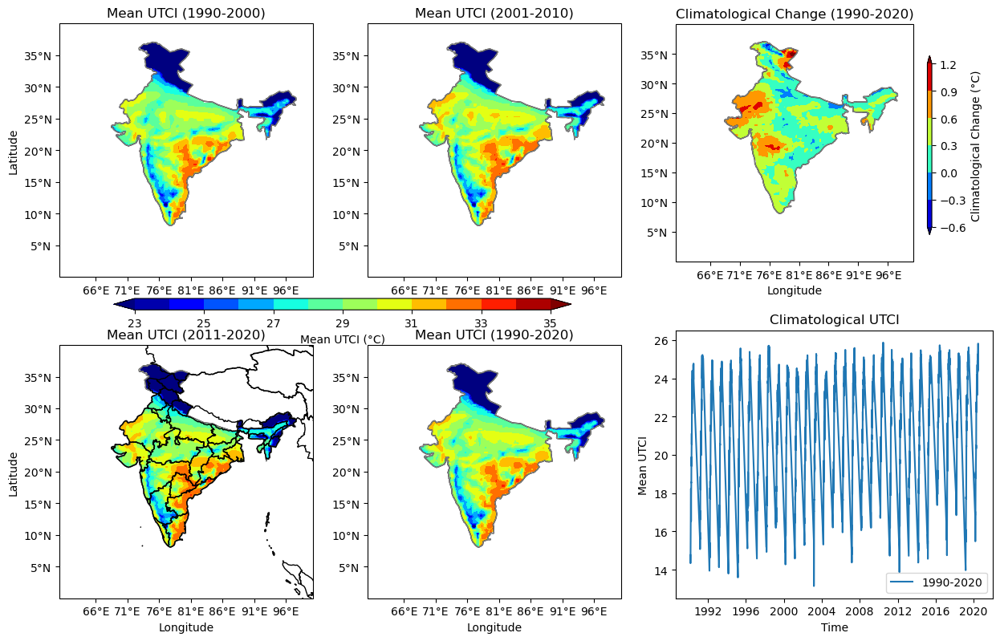

In [1]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspec
from mpl_toolkits.basemap import Basemap
import cartopy as ccrs
# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\utci_daily.nc')
ds


C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


<xarray.Dataset>
Dimensions:  (time: 3782, lon: 161, lat: 161)
Coordinates:
  * time     (time) datetime64[ns] 1990-03-01 1990-03-02 ... 2020-06-30T11:30:00
  * lon      (lon) float64 60.0 60.25 60.5 60.75 61.0 ... 99.25 99.5 99.75 100.0
  * lat      (lat) float64 0.0 0.25 0.5 0.75 1.0 ... 39.0 39.25 39.5 39.75 40.0
Data variables:
    utci     (time, lat, lon) float32 ...
Attributes:
    CDI:          Climate Data Interface version 1.9.9rc1 (https://mpimet.mpg...
    Conventions:  CF-1.6
    history:      Wed Jan 03 16:30:51 2024: cdo invertlat utci_daily.nc utci_...
    CDO:          Climate Data Operators version 1.9.9rc1 (https://mpimet.mpg...

In [9]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspec
from mpl_toolkits.basemap import Basemap
import cartopy as ccrs
# Load the dataset

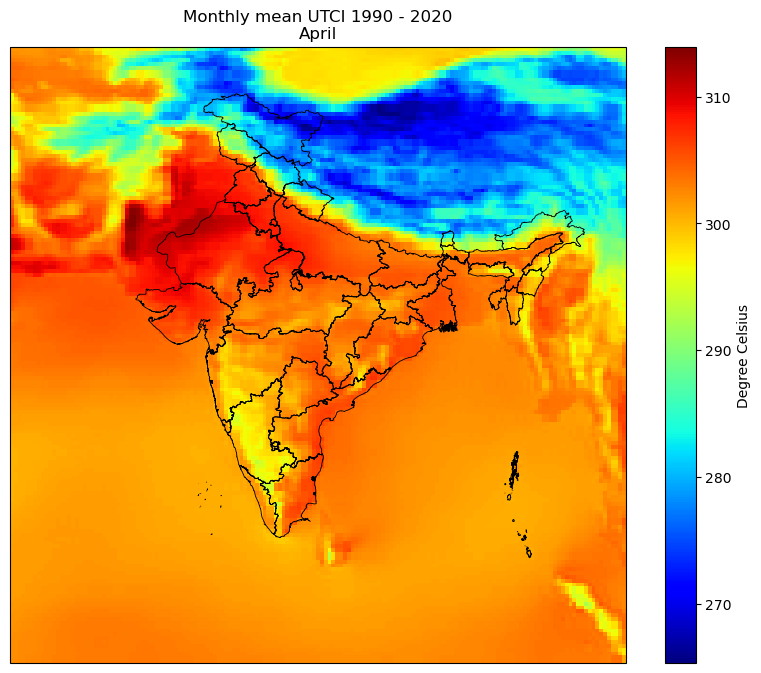

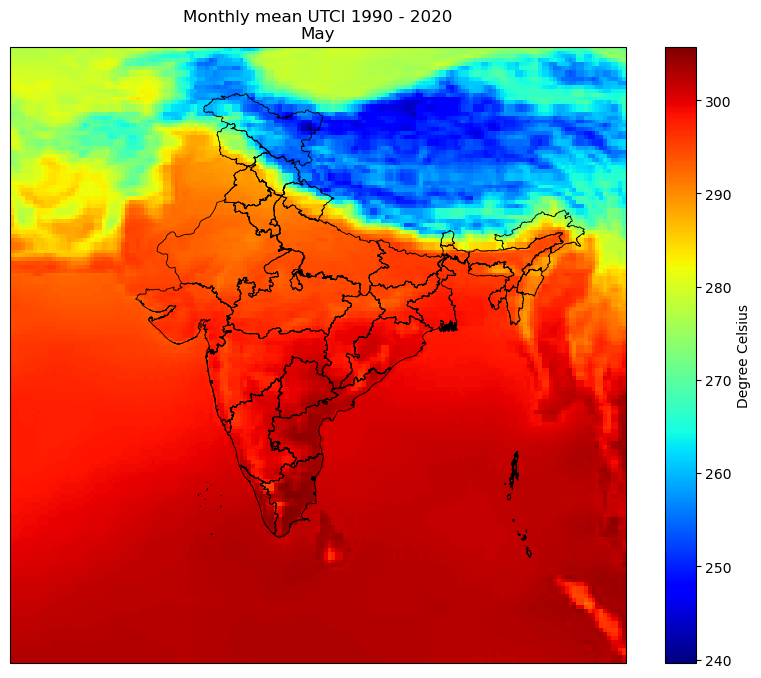

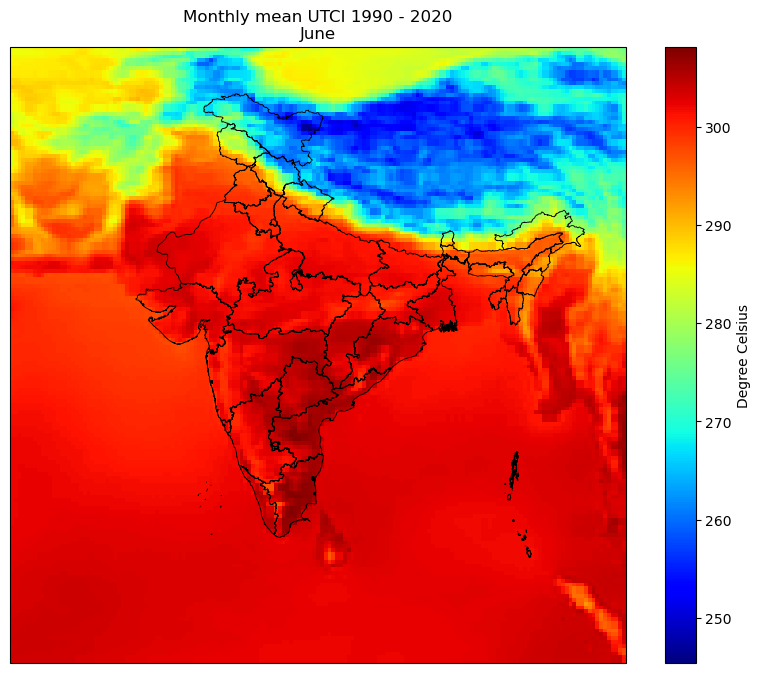

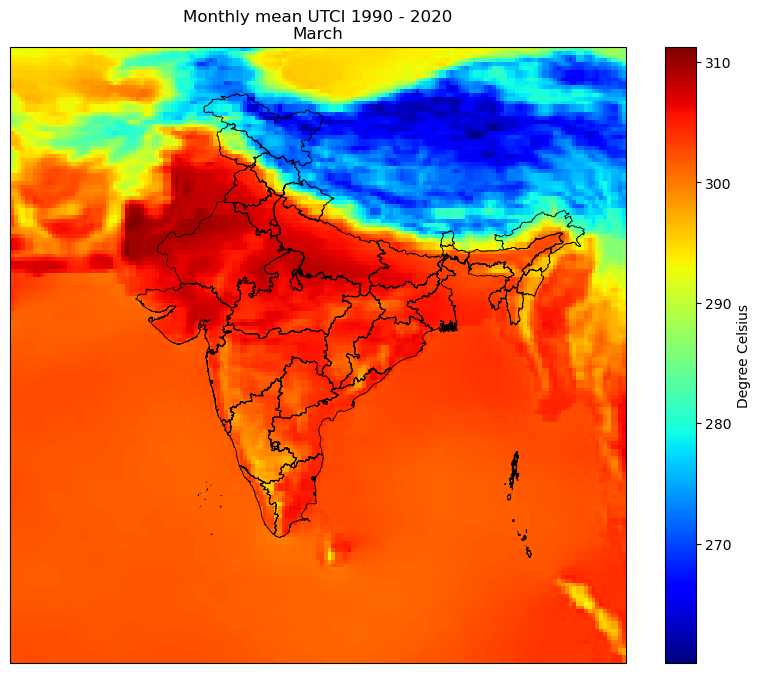

In [12]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature

from cartopy.io import shapereader as shpreader
from cartopy.feature import ShapelyFeature
from cartopy.io.shapereader import Reader
fname = shpreader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
shp = ShapelyFeature(Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp').geometries(),ccrs.PlateCarree(), edgecolor='k', facecolor='white', linewidth=0.6)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\utci_daily.nc')

# Extract data for different time periods
utci = ds['utci'] - 273.16
monthly = ds.resample(time='M').mean()  # Changed 'm' to 'M' for monthly resampling

lats = monthly['lat'].values  # Accessing latitudes directly from the dataset
lons = monthly['lon'].values  # Accessing longitudes directly from the dataset
time = monthly['time'].values
utci_data = monthly['utci'].values

mon = np.arange(3, 7)
nam = ['March', 'April', 'May', 'June']

for i, month_idx in enumerate(mon):
    fig, ax = plt.subplots(1, 1, figsize=(10, 8), subplot_kw={'projection': ccrs.PlateCarree()})

    # Plot the UTCI data
    im = ax.pcolormesh(lons, lats, utci_data[i-1], cmap='jet', shading='auto', transform=ccrs.PlateCarree())

    # Add coastlines, states, and gridlines
    # ax.coastlines()
    # ax.add_feature(cfeature.STATES)
    # ax.gridlines(draw_labels=True)

    # Title and labels
    ax.set_title('Monthly mean UTCI 1990 - 2020\n' + nam[i-3])
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
    ax.add_feature(shp)

    # Add colorbar
    cbar = fig.colorbar(im, ax=ax, location='right', pad=0.05)
    cbar.set_label('Degree Celsius')

    plt.show()


In [5]:
import geopandas as gpd 
import matplotlib.pyplot as plt 
from matplotlib.colors 
import BoundaryNorm, ListedColormap 
import numpy as np 
import xarray as xr
# Load shapefiles hyd_spfile = gpd.read_file('/home/renuka/Build_WRF/DATA/HYD/model_simulations_data/Telangana.shp') 
bhr_spfile = gpd.read_file('/home/renuka/Build_WRF/DATA/model_data/model_data_plotting/Karnataka.shp') 
thr_spfile = gpd.read_file('/home/renuka/Build_WRF/DATA/model_data/THR_SIMULATIONS/chitoor1.shp') 
krl_spfile = gpd.read_file('/home/renuka/Build_WRF/DATA/model_data/KRL_SIMULATIONS/Kerala.shp') 
# Load datasets hyd_isro = xr.open_dataset('/home/renuka/Build_WRF/DATA/HYD/isro_simulations_new/wrfout_d02_isro_hyd_dy.nc')
hyd_usgs = xr.open_dataset('/home/renuka/Build_WRF/DATA/HYD/usgs_simulations_new/wrfout_d02_usgs_hyd_dy.nc') 
thr_isro = xr.open_dataset('/home/renuka/Build_WRF/DATA/model_data/THR_SIMULATIONS/tr_isro_simla_data/wrfout_d02_isro_thr_dy.nc') 
thr_usgs = xr.open_dataset('/home/renuka/Build_WRF/DATA/mode...
I

In [8]:
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.colors import BoundaryNorm, ListedColormap
import numpy as np
import xarray as xr

In [ ]:


# Load shapefiles
hyd_spfile = gpd.read_file('/home/renuka/Build_WRF/DATA/HYD/model_simulations_data/Telangana.shp')
bhr_spfile = gpd.read_file('/home/renuka/Build_WRF/DATA/model_data/model_data_plotting/Karnataka.shp')
thr_spfile = gpd.read_file('/home/renuka/Build_WRF/DATA/model_data/THR_SIMULATIONS/chitoor1.shp')
krl_spfile = gpd.read_file('/home/renuka/Build_WRF/DATA/model_data/KRL_SIMULATIONS/Kerala.shp')

# Load datasets
hyd_isro = xr.open_dataset('/home/renuka/Build_WRF/DATA/HYD/isro_simulations_new/wrfout_d02_isro_hyd_dy.nc')
hyd_usgs = xr.open_dataset('/home/renuka/Build_WRF/DATA/HYD/usgs_simulations_new/wrfout_d02_usgs_hyd_dy.nc')

thr_isro = xr.open_dataset('/home/renuka/Build_WRF/DATA/model_data/THR_SIMULATIONS/tr_isro_simla_data/wrfout_d02_isro_thr_dy.nc')
thr_usgs = xr.open_dataset('/home/renuka/Build_WRF/DATA/model_data/THR_SIMULATIONS/tr_usgs_simla_data/wrfout_d02_usgs_thr_dy.nc')

bhr_isro = xr.open_dataset('/home/renuka/Build_WRF/DATA/model_data/BHR_SIMULATIONS/ISRO_SIMULATION_DATA_SAHOO_ETAL_PHY/d01_wrf_isro_hourly.nc')
bhr_usgs = xr.open_dataset('/home/renuka/Build_WRF/DATA/model_data/BHR_SIMULATIONS/USGS_SIMULATIONS_SAHOO_ET_AL_PHY/d01_wrf_usgs_hourly.nc')

# Set up the colormap and normalization
cmap=ListedColormap(['#FF0000','#FFA500','#FFFF00','#008000','#00FF00','#00FFFF','#0000FF','#800080',
                    '#FF00FF','#FFC0CB','#FFD700','#FFFFE0','#9ACD32','#ADFF2F','#F0E68C','#FFDAB9',
                    '#FFE4C4','#FFF5E3','#F5DEB3','#F4A460','#D2691E','#DA70D6','#ADD8E6','#FFFACD'])

bounds1 = list(range(1, 26))
norm1 = BoundaryNorm(bounds1, cmap.N)

# Create subplots with 2 rows and 3 columns
fig, axs = plt.subplots(3, 2, figsize=(8 ,12), gridspec_kw={'hspace': 0.15, 'wspace': 0.1})

# Plot for HYD location
hyd_spfile.boundary.plot(ax=axs[0, 0], linewidth=2, color='k')
hyd_spfile.boundary.plot(ax=axs[0, 1], linewidth=2, color='k')
hyd_usgs_clip = hyd_usgs.sel(lat=slice(hyd_spfile.bounds.miny.min(), hyd_spfile.bounds.maxy.max()),
                             lon=slice(hyd_spfile.bounds.minx.min(), hyd_spfile.bounds.maxx.max()))
hyd_isro_clip = hyd_isro.sel(lat=slice(hyd_spfile.bounds.miny.min(), hyd_spfile.bounds.maxy.max()),
                             lon=slice(hyd_spfile.bounds.minx.min(), hyd_spfile.bounds.maxx.max()))
im1 = hyd_usgs_clip.lu_index[0, 0, :, :].plot.contourf(ax=axs[0, 0], cmap=cmap, add_colorbar=False, add_labels=False, norm=norm1)
hyd_isro_clip.lu_index[0, 0, :, :].plot.contourf(ax=axs[0, 1], cmap=cmap, add_colorbar=False, add_labels=False, norm=norm1)

# Plot for BHR location
bhr_spfile.boundary.plot(ax=axs[1, 0], linewidth=2, color='k')
bhr_spfile.boundary.plot(ax=axs[1, 1], linewidth=2, color='k')
bhr_usgs_clip = bhr_usgs.sel(lat=slice(bhr_spfile.bounds.miny.min(), bhr_spfile.bounds.maxy.max()),
                             lon=slice(bhr_spfile.bounds.minx.min(), bhr_spfile.bounds.maxx.max()))
bhr_isro_clip = bhr_isro.sel(lat=slice(bhr_spfile.bounds.miny.min(), bhr_spfile.bounds.maxy.max()),
                             lon=slice(bhr_spfile.bounds.minx.min(), bhr_spfile.bounds.maxx.max()))
im2 = bhr_usgs_clip.lu_index[0, 0, :, :].plot.contourf(ax=axs[1, 0], cmap=cmap, add_colorbar=False, add_labels=False, norm=norm1)
bhr_isro_clip.lu_index[0, 0, :, :].plot.contourf(ax=axs[1, 1], cmap=cmap, add_colorbar=False, add_labels=False, norm=norm1)

# Plot for THR location
thr_spfile.boundary.plot(ax=axs[2, 0], linewidth=2, color='k')
thr_spfile.boundary.plot(ax=axs[2, 1], linewidth=2, color='k')
thr_usgs_clip = thr_usgs.sel(lat=slice(thr_spfile.bounds.miny.min(), thr_spfile.bounds.maxy.max()),
                             lon=slice(thr_spfile.bounds.minx.min(), thr_spfile.bounds.maxx.max()))
thr_isro_clip = thr_isro.sel(lat=slice(thr_spfile.bounds.miny.min(), thr_spfile.bounds.maxy.max()),
                             lon=slice(thr_spfile.bounds.minx.min(), thr_spfile.bounds.maxx.max()))
im3 = thr_usgs_clip.lu_index[0, 0, :, :].plot.contourf(ax=axs[2, 0], cmap=cmap, add_colorbar=False, add_labels=False, norm=norm1)
thr_isro_clip.lu_index[0, 0, :, :].plot.contourf(ax=axs[2, 1], cmap=cmap, add_colorbar=False, add_labels=False, norm=norm1)

# Set the color of the tick labels to black
plt.rcParams['xtick.color'] = 'black'
plt.rcParams['ytick.color'] = 'black'    

# Make color bar tick labels bold
plt.rcParams['font.weight'] = 'bold'

# Set titles for the whole first column as USGS and the second column as ISRO only on the top row
axs[0, 0].set_title('1992', fontsize=15, loc='center',fontweight='bold')
axs[0, 1].set_title('2019', fontsize=15, loc='center',fontweight='bold')

# Mark each plot as a), b), c), d), e), f)
axs[0, 0].text(0, 1, 'a)', transform=axs[0, 0].transAxes, fontsize=14, fontweight='bold', va='top')
axs[0, 1].text(0, 1, 'b)', transform=axs[0, 1].transAxes, fontsize=14, fontweight='bold', va='top')
axs[1, 0].text(0, 1, 'c)', transform=axs[1, 0].transAxes, fontsize=14, fontweight='bold', va='top')
axs[1, 1].text(0, 1, 'd)', transform=axs[1, 1].transAxes, fontsize=14, fontweight='bold', va='top')
axs[2, 0].text(0, 1, 'e)', transform=axs[2, 0].transAxes, fontsize=14, fontweight='bold', va='top')
axs[2, 1].text(0, 1, 'f)', transform=axs[2, 1].transAxes, fontsize=14, fontweight='bold', va='top')

# Remove the latitude and longitude values from the plot
axs[0, 1].yaxis.set_visible(False)
axs[1, 1].yaxis.set_visible(False)
axs[2, 1].yaxis.set_visible(False)

# Hide the x-axis labels for all subplots
for ax in axs.flat:
    ax.set_xlabel('')
    ax.set_ylabel('Latitude')
    ax.xaxis.label.set_fontweight('bold')
    ax.yaxis.label.set_fontweight('bold')
    ax.xaxis.set_tick_params(width=2,labelsize=12)
    ax.yaxis.set_tick_params(width=2,labelsize=12)

# Create a colorbar
cbar_ax = fig.add_axes([1.0, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
cbar = plt.colorbar(im2, cax=cbar_ax, ticks=list(range(1, 25)), boundaries=bounds1)

# Add custom tick labels
tick_labels = ['1.Urban', '2.Dry, Crop, & Pasture', '3.Irrigated Crop & Pasture', '4.Mixed Dry land', '5.Grassland Mosaic', '6.Wood & Mosaic',
              '7.Grassland', '8.Shrub','9.Mixed Shrub', '10.Savanna', '11.Deciduous Broad leaf Forest', '12.Deciduous Needle leaf Forest',
              '13.Evergreen Broad leaf', '14.Evergreen Needle leaf', '15.Mixed Forest', '16.Water Bodies',
              '17.Herbaceous Wetland', '18.Wooden Wetland', '19.Barren or Sparsely Vegetated', '20.Herbaceous Tundra',
              '21.Wooded Tundra', '22.Mixed Tundra', '23.Bare Ground Tundra', '24.Snow or Ice']
cbar.set_ticklabels(tick_labels)
#cbar.set_label('LULC Category',fontweight='bold')
plt.tight_layout()
plt.show()

In [2]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\utci_daily.nc') - 273.16

# Extract data for different time periods
utci = ds['utci']
monthly = ds.resample(time='M').mean()  # Changed 'm' to 'M' for monthly resampling

# Extract latitude and longitude values
lats = monthly['lat'].values
lons = monthly['lon'].values
time = monthly['time'].values
utci_data = monthly['utci'].values


C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [3]:
# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)

for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1




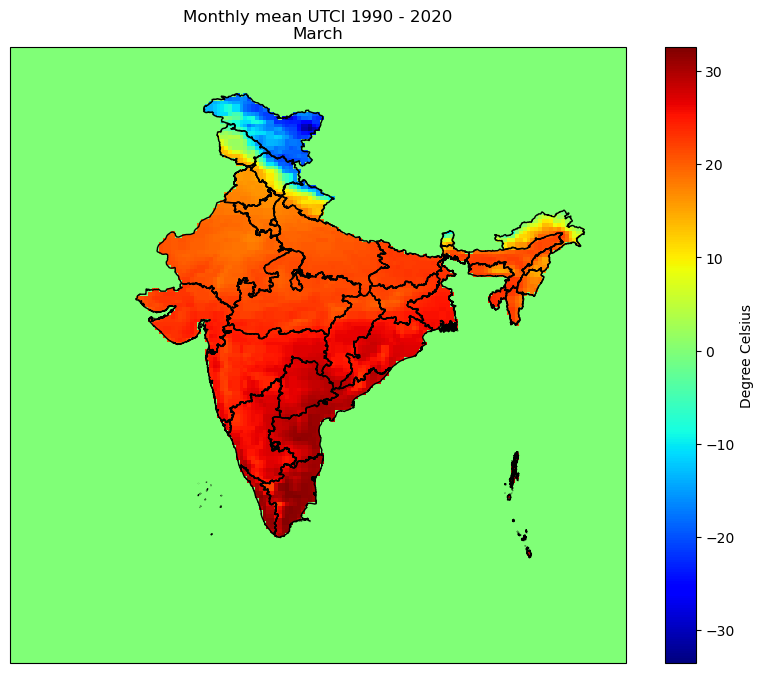

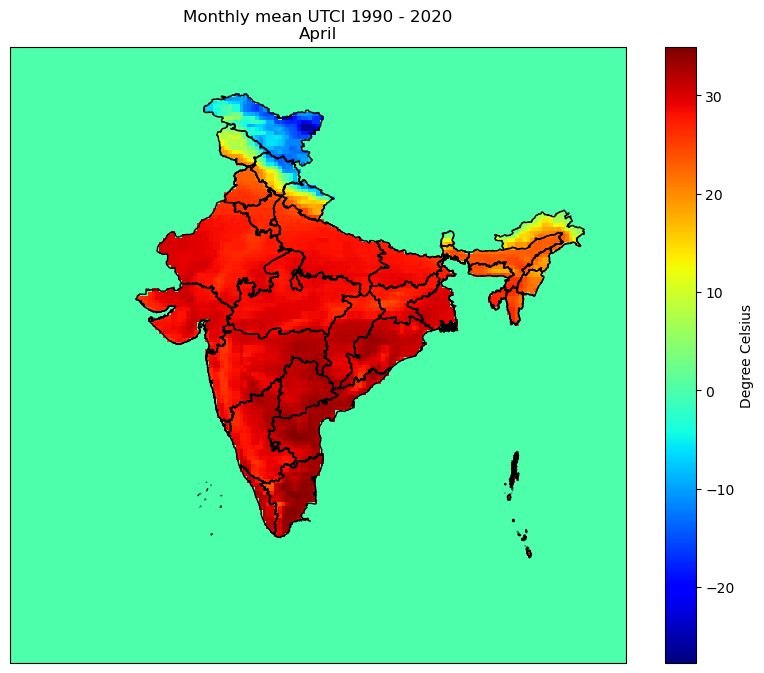

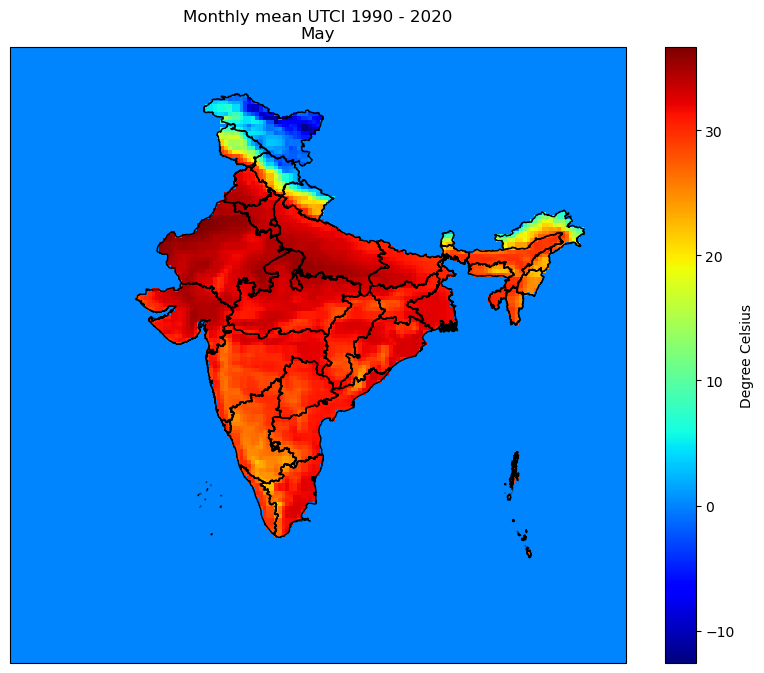

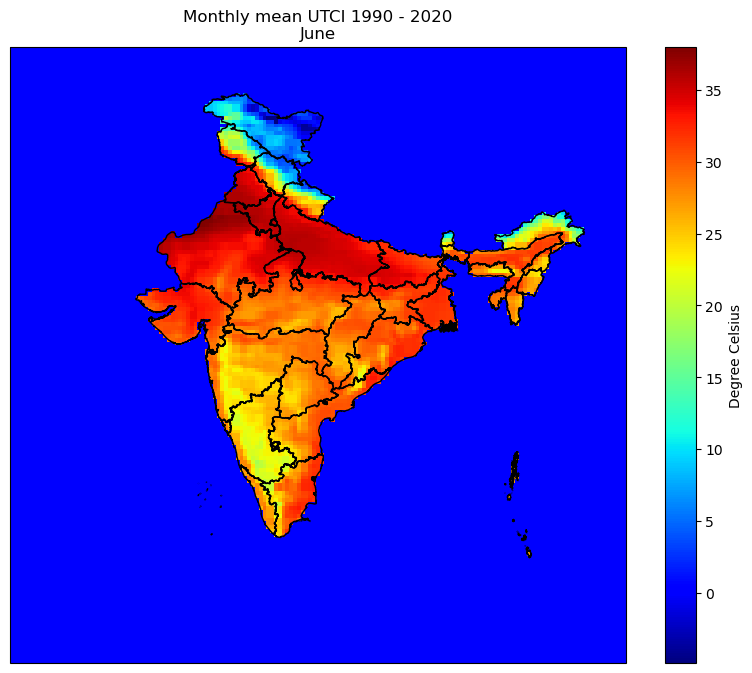

In [4]:
# Apply the mask to the data
utci_data_masked = utci_data * mask[np.newaxis, :, :]

mon = np.arange(3, 7)
nam = ['March', 'April', 'May', 'June']

for i, month_idx in enumerate(mon):
    
    fig, ax = plt.subplots(1, 1, figsize=(10, 8), subplot_kw={'projection': ccrs.PlateCarree()})

    # Plot the masked UTCI data
    im = ax.pcolormesh(lons, lats, utci_data_masked[month_idx-3], cmap='jet', shading='auto', transform=ccrs.PlateCarree())

    # Add India shapefile
    ax.add_feature(india_feature)

    # Title and labels
    ax.set_title('Monthly mean UTCI 1990 - 2020\n' + nam[i])
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

    # Add colorbar
    cbar = fig.colorbar(im, ax=ax, location='right', pad=0.05)
    cbar.set_label('Degree Celsius')
    plt.show()

In [1]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union

india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)


# Load the dataset
# ds = xr.open_dataset('utci_daily.nc')
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\utci_daily.nc')-273.16

# Extract data for different time periods
utci = ds['utci']
utci_time1 = utci.sel(time=slice('1990-03-01', '1999-06-30')).mean(dim='time')
utci_time2 = utci.sel(time=slice('2000-03-01', '2009-06-30')).mean(dim='time')
utci_time3 = utci.sel(time=slice('2010-03-01', '2020-06-30')).mean(dim='time')
utci_time4 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')

# Calculate the trend
trend1 = utci_time2 - utci_time1
trend2 = utci_time3 - utci_time2
trend = trend1 + trend2
lats = utci['lat'].values
lons = utci['lon'].values
time = utci['time'].values
utci_data = ds['utci'].values
# utci_data = utci.values
# Create a mask for the entire region


C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [2]:
print(Point)

<class 'shapely.geometry.point.Point'>


In [3]:
mask = np.zeros((len(lats), len(lons)), dtype=int)

for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1

# Apply the mask to the data
utci_data_masked = utci_data * mask[np.newaxis, :, :]



In [9]:
# Apply the mask to the data
utci_data_masked = utci_data * mask[np.newaxis, :, :]
#print(utci_data_masked)

In [16]:
utci_time1 = utci_data_masked[:, :, 0]
utci_time2 = utci_data_masked[:, :, 1]
utci_time3 = utci_data_masked[:, :, 2]
utci_trend = utci_data_masked[:, :, 3]

C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


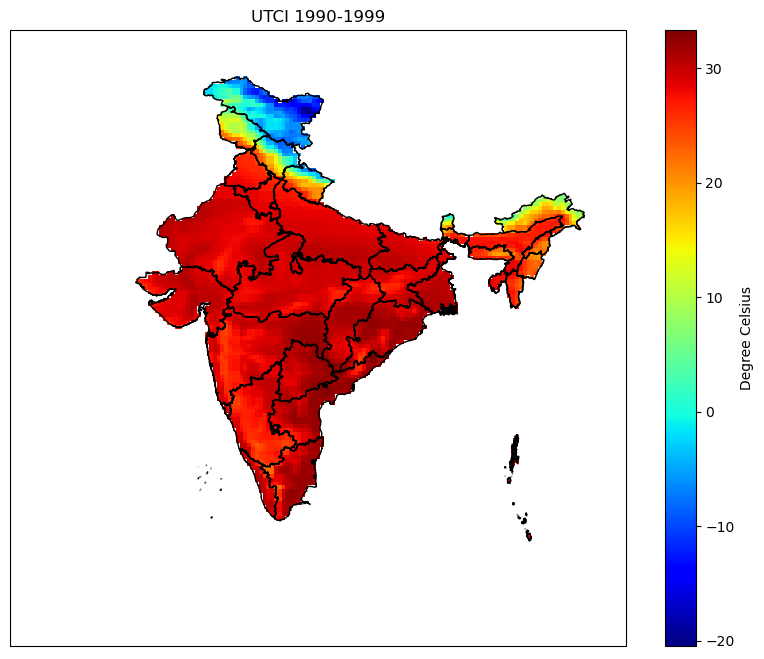

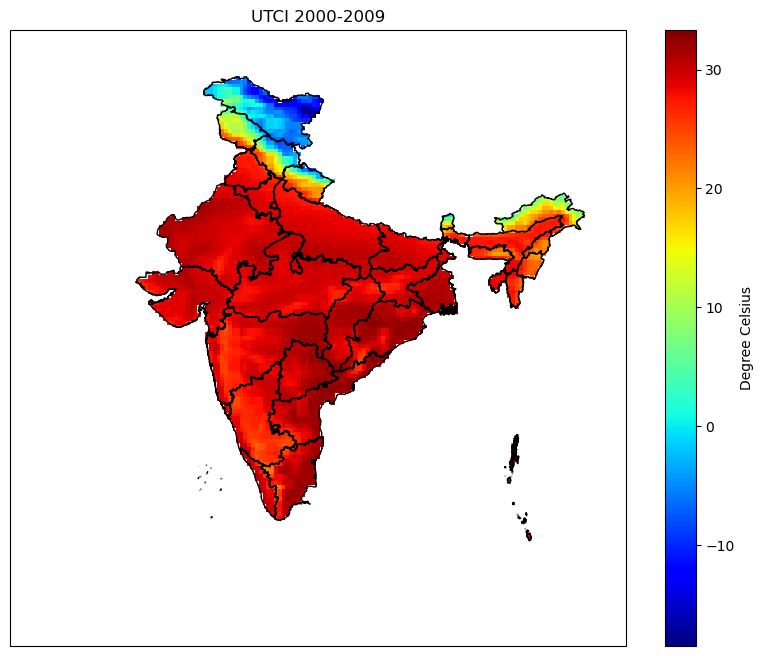

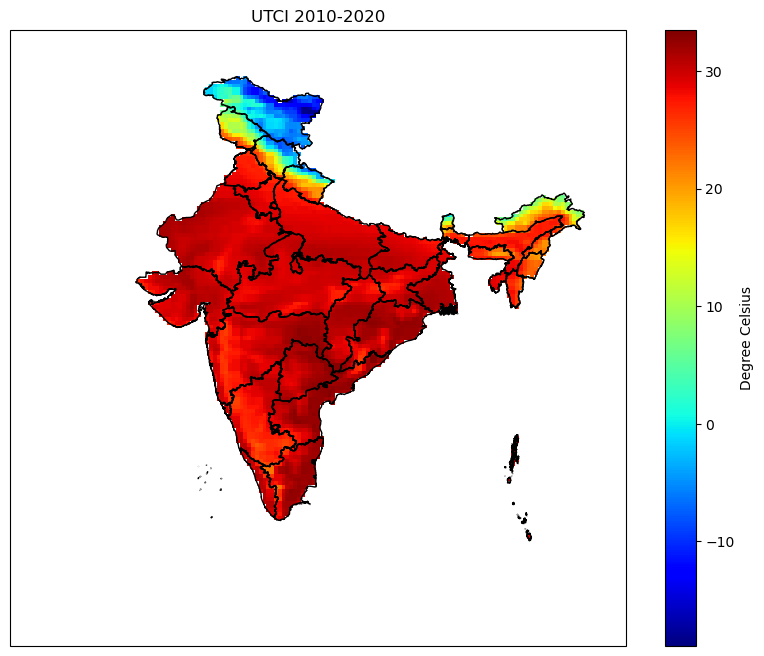

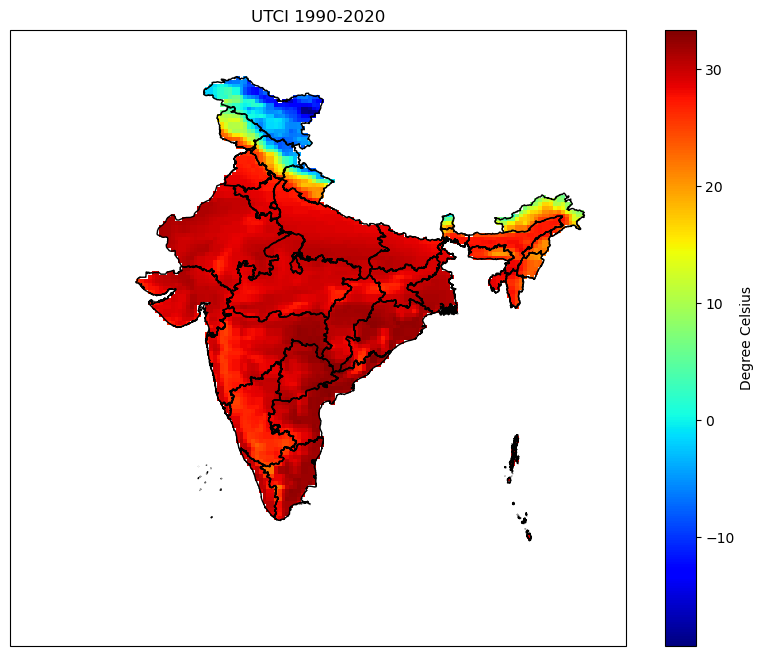

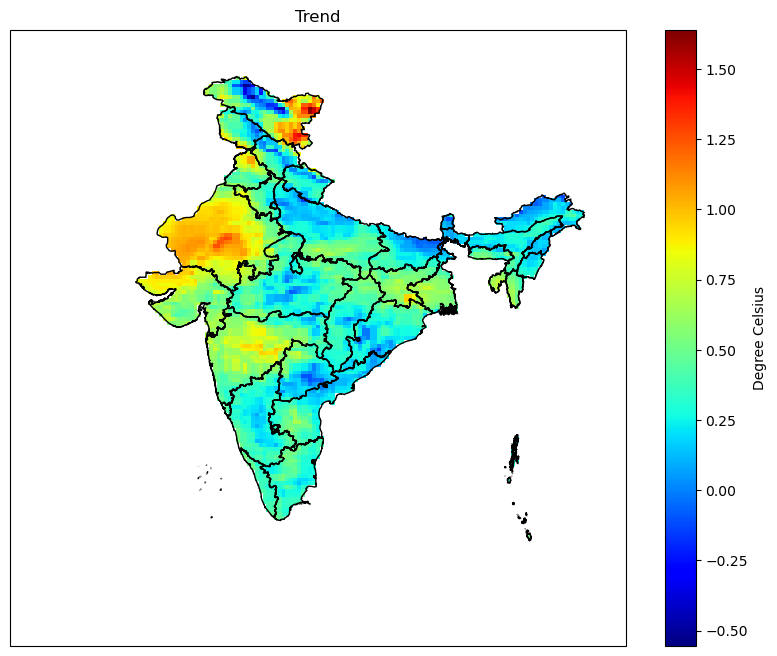

In [1]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io import shapereader
from shapely.geometry import Point
from shapely.ops import unary_union

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\utci_daily.nc')
utci = ds['utci'] - 273.16

# Extract data for different time periods
utci_time1 = utci.sel(time=slice('1990-03-01', '1999-06-30')).mean(dim='time')
utci_time2 = utci.sel(time=slice('2000-03-01', '2009-06-30')).mean(dim='time')
utci_time3 = utci.sel(time=slice('2010-03-01', '2020-06-30')).mean(dim='time')
utci_time4 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')

# Calculate the trend
trend1 = utci_time2 - utci_time1
trend2 = utci_time3 - utci_time2
trend = trend1 + trend2

# Extract latitude and longitude values
lats = ds['lat'].values
lons = ds['lon'].values

# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1

# Apply the mask to the data
utci_time1_masked = utci_time1.where(mask == 1)
utci_time2_masked = utci_time2.where(mask == 1)
utci_time3_masked = utci_time3.where(mask == 1)
utci_time4_masked = utci_time4.where(mask == 1)
trend_masked = trend.where(mask == 1)

# Plot the data
mon = [utci_time1_masked, utci_time2_masked, utci_time3_masked, utci_time4_masked, trend_masked]
titles = ['UTCI 1990-1999', 'UTCI 2000-2009', 'UTCI 2010-2020', 'UTCI 1990-2020', 'Trend']

for i, data in enumerate(mon):
    fig, ax = plt.subplots(1, 1, figsize=(10, 8), subplot_kw={'projection': ccrs.PlateCarree()})

    # Plot the masked UTCI data
    im = ax.pcolormesh(lons, lats, data, cmap='jet', shading='auto', transform=ccrs.PlateCarree())

    # Add India shapefile
    ax.add_feature(india_feature)

    # Title and labels
    ax.set_title(titles[i])
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

    # Add colorbar
    cbar = fig.colorbar(im, ax=ax, location='right', pad=0.05)
    cbar.set_label('Degree Celsius')
    plt.show()


In [ ]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io import shapereader
from shapely.geometry import Point
from shapely.ops import unary_union

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\utci_daily.nc')
utci = ds['utci'] - 273.16

# Extract data for different time periods
utci_time1 = utci.sel(time=slice('1990-03-01', '1999-06-30')).mean(dim='time')
utci_time2 = utci.sel(time=slice('2000-03-01', '2009-06-30')).mean(dim='time')
utci_time3 = utci.sel(time=slice('2010-03-01', '2020-06-30')).mean(dim='time')
utci_time4 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')

# Calculate the trend
trend1 = utci_time2 - utci_time1
trend2 = utci_time3 - utci_time2
trend = trend1 + trend2
trend3 = utci_time4-utci_time1
trend4 = utci_time4-utci_time2
trend5 = utci_time4-utci_time3
# Extract latitude and longitude values
lats = ds['lat'].values
lons = ds['lon'].values

# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1

# Apply the mask to the data
utci_time1_masked = utci_time1.where(mask == 1)
utci_time2_masked = utci_time2.where(mask == 1)
utci_time3_masked = utci_time3.where(mask == 1)
utci_time4_masked = utci_time4.where(mask == 1)
trend_masked = trend.where(mask == 1)
trend1_masked = trend3.where(mask == 1)
trend2_masked = trend4.where(mask == 1)
trend3_masked = trend5.where(mask == 1)

# Plot the data
#mon = [utci_time1_masked, utci_time2_masked, utci_time3_masked, utci_time4_masked, trend_masked]
mon = [utci_time4_masked, trend1_masked, trend2_masked, trend3_masked]
#titles = ['UTCI 1990-1999', 'UTCI 2000-2009', 'UTCI 2010-2020', 'UTCI 1990-2020', 'Trend']
titles = ['climate mean 1990-2020', 'trend 1990-1999', 'trend 1999-2009', 'trend 2009-2020', ]

for i, data in enumerate(mon):
    fig, ax = plt.subplots(1, 1, figsize=(10, 8), subplot_kw={'projection': ccrs.PlateCarree()})

    # Plot the masked UTCI data
    im = ax.pcolormesh(lons, lats, data, cmap='jet', shading='auto', transform=ccrs.PlateCarree())

    # Add India shapefile
    ax.add_feature(india_feature)

    # Title and labels
    ax.set_title(titles[i])
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

    # Add colorbar
    cbar = fig.colorbar(im, ax=ax, location='right', pad=0.05)
    cbar.set_label('Degree Celsius')
    plt.show()


In [ ]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io import shapereader
from shapely.geometry import Point
from shapely.ops import unary_union

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\utci_daily.nc')
utci = ds['utci'] - 273.16

# Extract data for different time periods
utci_time1 = utci.sel(time=slice('1990-03-01', '1999-06-30')).mean(dim='time')
utci_time2 = utci.sel(time=slice('2000-03-01', '2009-06-30')).mean(dim='time')
utci_time3 = utci.sel(time=slice('2010-03-01', '2020-06-30')).mean(dim='time')
utci_time4 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')

# Calculate the trend
trend1 = utci_time2 - utci_time1
trend2 = utci_time3 - utci_time2
trend = trend1 + trend2
trend3 = utci_time4 - utci_time1
trend4 = utci_time4 - utci_time2
trend5 = utci_time4 - utci_time3

# Extract latitude and longitude values
lats = ds['lat'].values
lons = ds['lon'].values

# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1

# Apply the mask to the data
utci_time1_masked = utci_time1.where(mask == 1)
utci_time2_masked = utci_time2.where(mask == 1)
utci_time3_masked = utci_time3.where(mask == 1)
utci_time4_masked = utci_time4.where(mask == 1)
trend_masked = trend.where(mask == 1)
trend1_masked = trend3.where(mask == 1)
trend2_masked = trend4.where(mask == 1)
trend3_masked = trend5.where(mask == 1)

# Plot the data
mon = [utci_time4_masked, trend1_masked, trend2_masked, trend3_masked]
titles = ['Climate Mean 1990-2020', 'Trend 1990-1999', 'Trend 1999-2009', 'Trend 2009-2020']



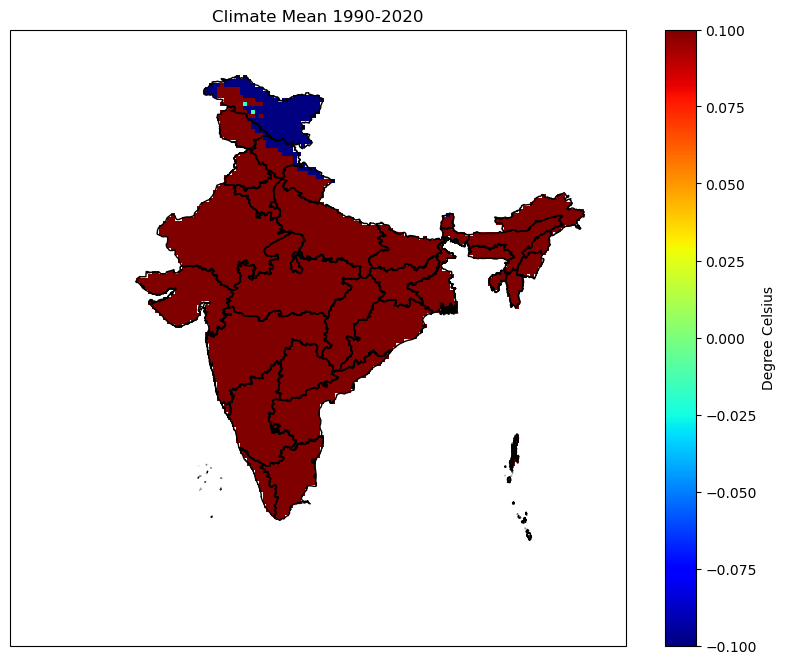

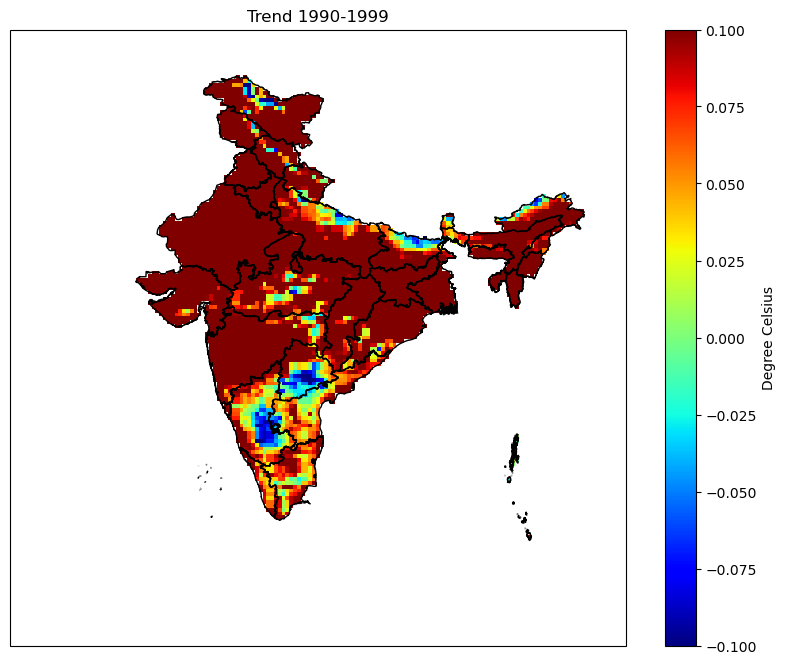

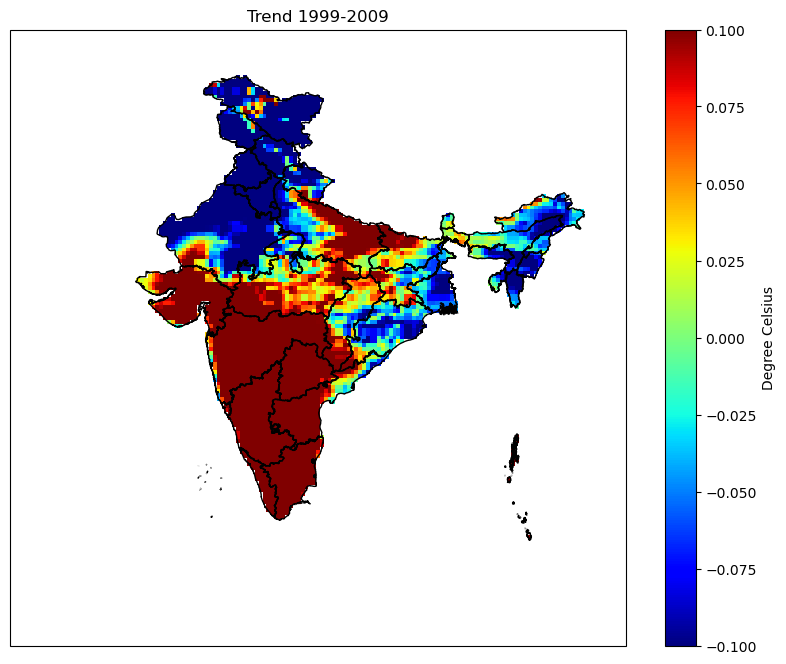

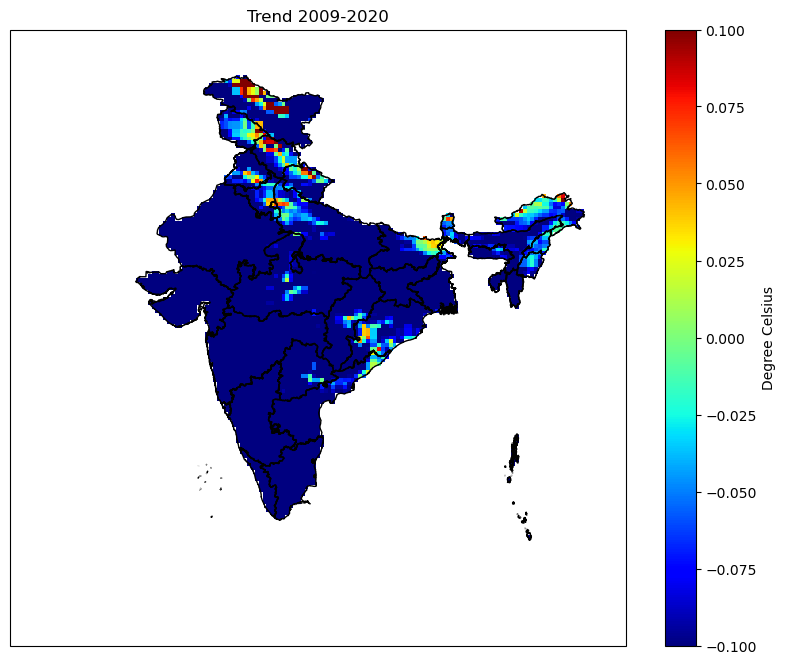

In [14]:
min_value = min([data.min().item() for data in mon])
levels = np.arange(0,42.1,5)
for i, data in enumerate(mon):
    fig, ax = plt.subplots(1, 1, figsize=(10, 8), subplot_kw={'projection': ccrs.PlateCarree()})

    # Plot the masked UTCI data with consistent color scaling
    im = ax.pcolormesh(lons, lats, data, cmap='jet', shading='auto', levels=levels,
                       extend="both", shrink=0.67, aspect=20,  transform=ccrs.PlateCarree())#, vmin=min_value, vmax=max_value)

    # Add India shapefile
    ax.add_feature(india_feature)

    # Title and labels
    ax.set_title(titles[i])
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

    # Add colorbar with consistent limits
    cbar = fig.colorbar(im, ax=ax, location='right', pad=0.05)
    cbar.set_label('Degree Celsius')
    plt.show()


In [ ]:
plt.figure


In [ ]:
plt.figure()
#map = Basemap(projection="cyl", resolution='c', llcrnrlat=-90, urcrnrlat=90, llcrnrlon=-180, urcrnrlon=180) 
map.drawcoastlines(color="black") 
lons,lats = np.meshgrid(data.variables['lon'][:], data.variables['lat'][:]) 
x,y = map(lons, lats)
temp_plot = map.contourf(x, y, temp_av_1901_2017, cmap=plt.cm.viridis) 
cb = map.colorbar(temp_plot, "bottom", size="5%", pad="2%", extend = 'both')
cb.set_label(u"Temperature \u2103")
plt.title("Mean Temperature (1901-2017)")
plt.annotate('Data - CRU TS v4.02',(-178,-88), fontsize=6)
plt.show() 
plt.savefig("cruts_global.png")

In [1]:
import numpy as np
from netCDF4 import Dataset
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap

# Load the dataset
data = Dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\utci_daily.nc')
lats = data.variables['lat'][:]
lons = data.variables['lon'][:]
t = data.variables['utci'][:]-273.16

# Create a Basemap instance
mp = Basemap(projection='merc',
             llcrnrlon=60,  # Lower-left corner longitude
             llcrnrlat=0,   # Lower-left corner latitude
             urcrnrlat=40,  # Upper-right corner latitude
             urcrnrlon=100, # Upper-right corner longitude
             resolution='i')

# Create a meshgrid for the latitude and longitude
lon, lat = np.meshgrid(lons, lats)
x, y = mp(lon, lat)

# Define the days to plot
days = np.arange(0, 1)
day_index = 1
# Plot for each day
####for day_index in days:


In [ ]:
# Plot for each day
for day_index in days:
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

    # Plot data using Cartopy
    plt.contourf(lons, lats, utci_masked[day_index], levels=levels, cmap='jet', transform=ccrs.PlateCarree())
    cbar = plt.colorbar(label="UTCI Stress", orientation='vertical', extend='both', shrink=0.8)
    plt.title(f'Mean UTCI: Day {day_index + 1} of Year 1990')

    # Add coastlines and other features
    ax.coastlines()
    ax.add_feature(cfeature.BORDERS, edgecolor='k')
    ax.add_feature(cfeature.STATES, edgecolor='k')
    ax.add_feature(cfeature.LAND)
    ax.add_feature(cfeature.OCEAN)
    ax.add_feature(cfeature.LAKES, alpha=0.5)
    ax.add_feature(cfeature.RIVERS)

    plt.show()


C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)


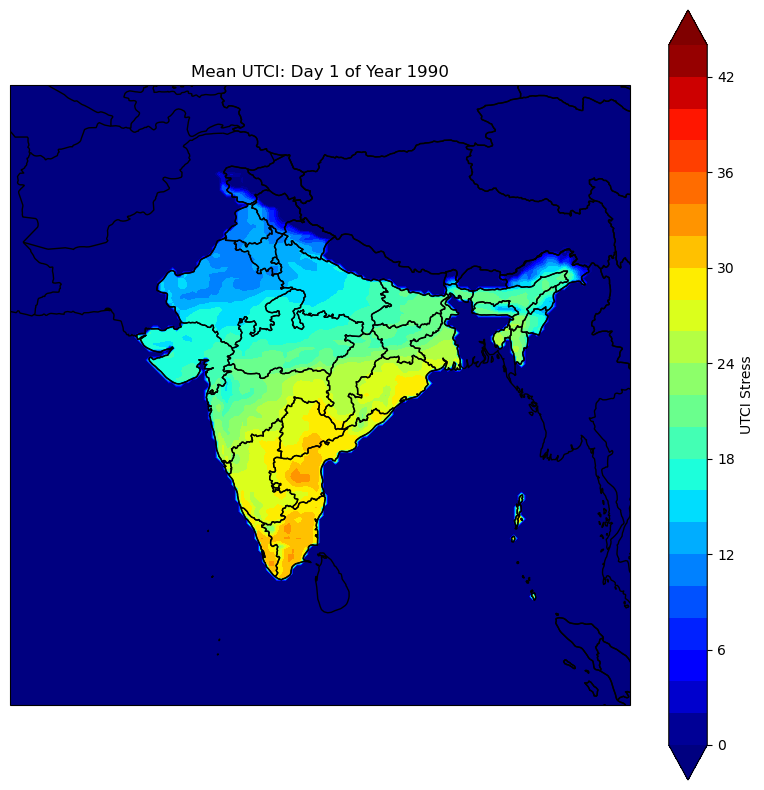

In [4]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\utci_daily.nc')
utci = ds['utci'] - 273.16  # Convert temperature from Kelvin to Celsius

# Extract latitude and longitude values
lats = utci['lat'].values
lons = utci['lon'].values

# # Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)

for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1

# # Create a mask for the entire region
# mask = np.zeros_like(utci.values[0])

# for i, lat in enumerate(lats):
#     for j, lon in enumerate(lons):
#         if not is_inside_india(lat, lon, india_polygon):
#             mask[i, j] = 1

# Apply the mask to the data
utci_data_masked = utci * mask[np.newaxis, :, :]

# utci_masked = np.ma.masked_where(mask, utci)

# Define levels for contourf
levels = np.arange(0, 45.1, 2)

# Define the days to plot
days = np.arange(0, 1)

# Plot for each day
for day_index in days:
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

    # Plot data using Cartopy
    plt.contourf(lons, lats, utci_data_masked[day_index], levels=levels,
                 cmap='jet', transform=ccrs.PlateCarree(), extend='both', shrink=0.58)
    cbar = plt.colorbar(label="UTCI Stress", orientation='vertical')
    plt.title(f'Mean UTCI: Day {day_index + 1} of Year 1990')

    # Add coastlines and other features
    ax.coastlines()
    ax.add_feature(cfeature.STATES, edgecolor='k')
    ax.add_feature(cfeature.BORDERS, edgecolor='k')
    #ax.add_feature(cfeature.LAND)
    ax.add_feature(cfeature.OCEAN)
    #ax.add_feature(cfeature.LAKES, alpha=0.5)
    #ax.add_feature(cfeature.RIVERS)

    plt.show()


In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
import matplotlib as mpl

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\utci_daily.nc')
utci = ds['utci'] - 273.16  # Convert temperature from Kelvin to Celsius

# Extract latitude and longitude values
lats = utci['lat'].values
lons = utci['lon'].values

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)
# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)

for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0

# Apply the mask to the data, setting values outside India to NaN
utci_data_masked = utci.where(mask == 1, np.nan)


C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [10]:
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')


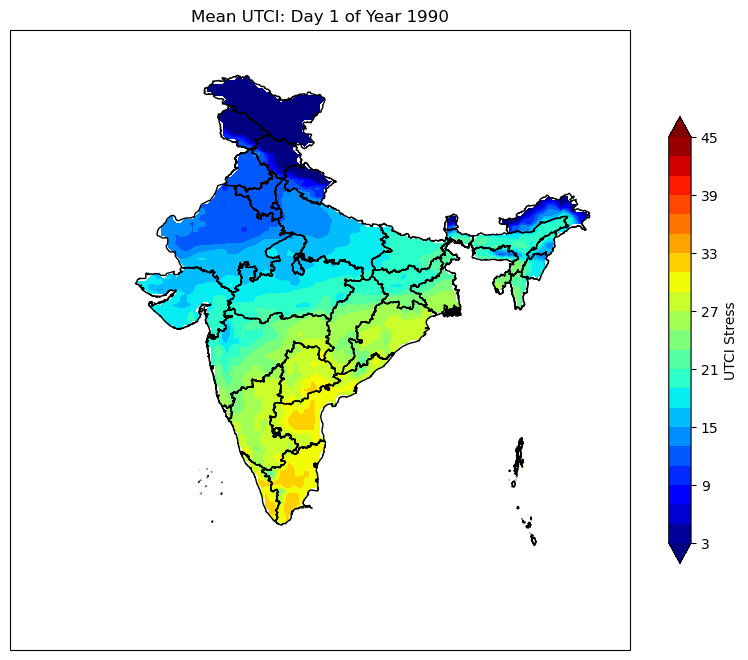

In [11]:

# Define levels for contourf
levels = np.arange(3, 45.1, 2)

# Define the days to plot
days = np.arange(0, 1)

# Plot for each day
for day_index in days:
    fig = plt.figure(figsize=(10, 10), facecolor='white')
    ax = fig.add_subplot(1, 1, 1, projection=ccrs.PlateCarree())

    mpl.rcParams['figure.facecolor'] = 'white'
    
    # Plot data using Cartopy
    cf = ax.contourf(lons, lats, utci_data_masked[day_index], levels=levels,
                     cmap='jet', transform=ccrs.PlateCarree(), extend='both')
    # Add India shapefile
    ax.add_feature(india_feature)
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.58, label="UTCI Stress")
    ax.set_title(f'Mean UTCI: Day {day_index + 1} of Year 1990')

    # Add coastlines and other features
    #ax.coastlines()
    #ax.add_feature(cfeature.STATES, edgecolor='k')
    #ax.add_feature(cfeature.BORDERS, edgecolor='k')
    #ax.add_feature(cfeature.OCEAN)
    #ax.add_feature(cfeature.LAKES, alpha=0.5)
    #ax.add_feature(cfeature.RIVERS)

    plt.show()


In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
import matplotlib as mpl

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\utci_daily.nc')
utci = ds['utci'] - 273.16  # Convert temperature from Kelvin to Celsius

# Extract data for different time periods
utci_time1 = utci.sel(time=slice('1990-03-01', '2000-06-30')).mean(dim='time')
utci_time2 = utci.sel(time=slice('2001-03-01', '2010-06-30')).mean(dim='time')
utci_time3 = utci.sel(time=slice('2011-03-01', '2020-06-30')).mean(dim='time')
utci_time4 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')#climatology

# Calculate the trends
trend1 = utci_time1 - utci_time4
trend2 = utci_time2 - utci_time4
trend3 = utci_time3 - utci_time4

# Extract latitude and longitude values
lats = ds['lat'].values
lons = ds['lon'].values

# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1

# Apply the mask to the data
utci_time1_masked = utci_time1.where(mask == 1)
utci_time2_masked = utci_time2.where(mask == 1)
utci_time3_masked = utci_time3.where(mask == 1)
utci_time4_masked = utci_time4.where(mask == 1)
trend1_masked = trend1.where(mask == 1)
trend2_masked = trend2.where(mask == 1)
trend3_masked = trend3.where(mask == 1)

# # Plot the data
# mon = [utci_time4_masked, trend1_masked, trend2_masked, trend3_masked]
# titles = ['Climate Mean 1990-2019', 'Trend 1990-1999', 'Trend 2000-2009', 'Trend 2010-2019']

# # Define levels for contourf
# levels = np.arange(3, 45.1, 2)

# # Plot for each time period
# fig, axes = plt.subplots(2, 2, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
# axes = axes.flatten()

# for i, ax in enumerate(axes):
#     mpl.rcParams['figure.facecolor'] = 'white'
#     cf = ax.contourf(lons, lats, mon[i], levels=levels, cmap='jet', transform=ccrs.PlateCarree(), extend='both')
#     ax.add_feature(india_feature)
#     cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.58, label="UTCI Stress")
#     ax.set_title(titles[i])

# plt.tight_layout()
# plt.show()



C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


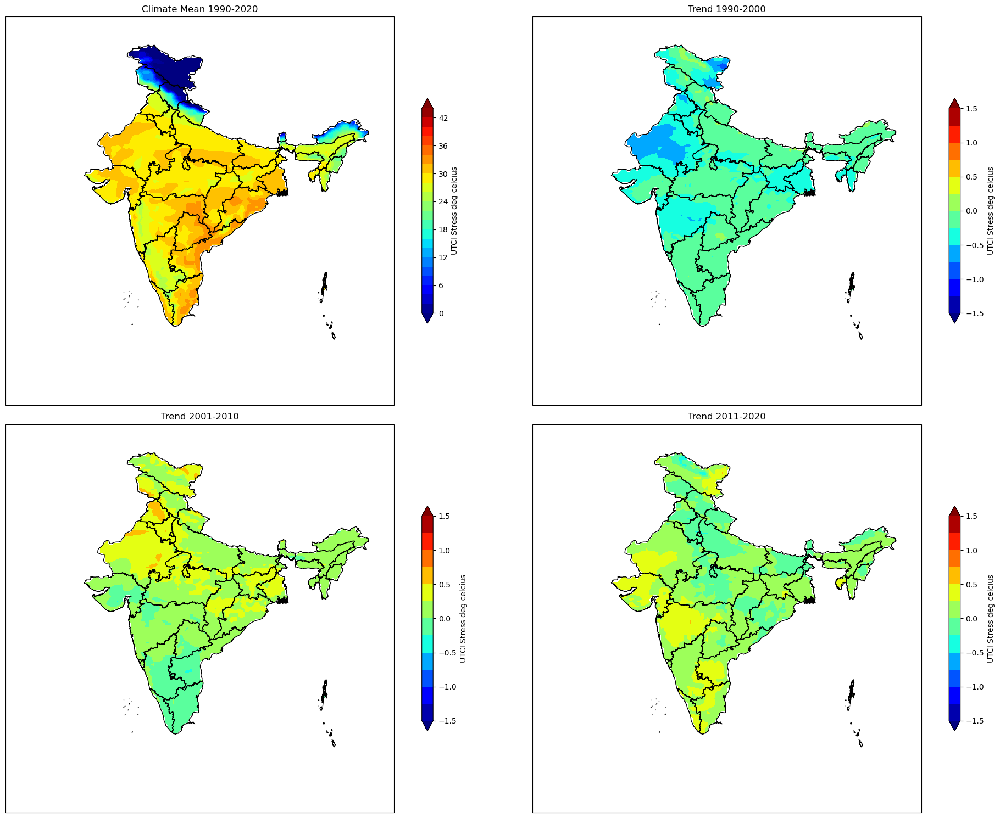

In [7]:
# Plot the data
mon = [utci_time4_masked, trend1_masked, trend2_masked, trend3_masked]
titles = ['Climate Mean 1990-2020', 'Trend 1990-2000', 'Trend 2001-2010', 'Trend 2011-2020']

# Define individual levels for each plot
levels_list = [
    np.arange(0, 45.1, 2),  # Levels for Climate Mean 1990-2019
    np.arange(-1.5, 1.51, 0.25),  # Levels for Trend 1990-1999
    np.arange(-1.5, 1.51, 0.25),  # Levels for Trend 2000-2009
    np.arange(-1.5, 1.51, 0.25)   # Levels for Trend 2010-2019
]

# Plot for each time period
fig, axes = plt.subplots(2, 2, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()

for i, ax in enumerate(axes):
    mpl.rcParams['figure.facecolor'] = 'white'
    cf = ax.contourf(lons, lats, mon[i], levels=levels_list[i], cmap='jet', transform=ccrs.PlateCarree(), extend='both')
    ax.add_feature(india_feature)
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.58, label="UTCI Stress deg celcius")
    ax.set_title(titles[i])

plt.tight_layout()
plt.show()

In [2]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspace
ds = xr.open_dataset('utci_dv.nc')
print(ds.info)

<bound method Dataset.info of <xarray.Dataset>
Dimensions:  (time: 24, lon: 161, lat: 161)
Coordinates:
  * time     (time) datetime64[ns] 2005-04-30 ... 2005-04-30T23:00:00
  * lon      (lon) float64 60.0 60.25 60.5 60.75 61.0 ... 99.25 99.5 99.75 100.0
  * lat      (lat) float64 0.0 0.25 0.5 0.75 1.0 ... 39.0 39.25 39.5 39.75 40.0
Data variables:
    utci     (time, lat, lon) float32 ...
Attributes:
    CDI:          Climate Data Interface version 1.9.9rc1 (https://mpimet.mpg...
    Conventions:  CF-1.6
    history:      Wed Jan 10 11:05:09 2024: cdo mergetime utci_00.nc utci_01....
    CDO:          Climate Data Operators version 1.9.9rc1 (https://mpimet.mpg...>


In [9]:
print(ds.utci)
utci=ds['utci']

<xarray.DataArray 'utci' (time: 24, lat: 161, lon: 161)>
[622104 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2005-04-30 ... 2005-04-30T23:00:00
  * lon      (lon) float64 60.0 60.25 60.5 60.75 61.0 ... 99.25 99.5 99.75 100.0
  * lat      (lat) float64 0.0 0.25 0.5 0.75 1.0 ... 39.0 39.25 39.5 39.75 40.0
Attributes:
    cell_methods:  time: mean


In [11]:
print(ds.time)

<xarray.DataArray 'time' (time: 24)>
array(['2005-04-30T00:00:00.000000000', '2005-04-30T01:00:00.000000000',
       '2005-04-30T02:00:00.000000000', '2005-04-30T03:00:00.000000000',
       '2005-04-30T04:00:00.000000000', '2005-04-30T05:00:00.000000000',
       '2005-04-30T06:00:00.000000000', '2005-04-30T07:00:00.000000000',
       '2005-04-30T08:00:00.000000000', '2005-04-30T09:00:00.000000000',
       '2005-04-30T10:00:00.000000000', '2005-04-30T11:00:00.000000000',
       '2005-04-30T12:00:00.000000000', '2005-04-30T13:00:00.000000000',
       '2005-04-30T14:00:00.000000000', '2005-04-30T15:00:00.000000000',
       '2005-04-30T16:00:00.000000000', '2005-04-30T17:00:00.000000000',
       '2005-04-30T18:00:00.000000000', '2005-04-30T19:00:00.000000000',
       '2005-04-30T20:00:00.000000000', '2005-04-30T21:00:00.000000000',
       '2005-04-30T22:00:00.000000000', '2005-04-30T23:00:00.000000000'],
      dtype='datetime64[ns]')
Coordinates:
  * time     (time) datetime64[ns] 2005-04-

In [4]:
import netCDF4 as nc4            # to work with netCDFs
import numpy   as np             # to perform numerics
import time
ncid = nc4.Dataset('utci_dv.nc','r')
#print(ncid)
print(ds.variables)
import cartopy.crs as ccrs
import matplotlib.pyplot as plt

Frozen({'time': <xarray.IndexVariable 'time' (time: 24)>
array(['2005-04-30T00:00:00.000000000', '2005-04-30T01:00:00.000000000',
       '2005-04-30T02:00:00.000000000', '2005-04-30T03:00:00.000000000',
       '2005-04-30T04:00:00.000000000', '2005-04-30T05:00:00.000000000',
       '2005-04-30T06:00:00.000000000', '2005-04-30T07:00:00.000000000',
       '2005-04-30T08:00:00.000000000', '2005-04-30T09:00:00.000000000',
       '2005-04-30T10:00:00.000000000', '2005-04-30T11:00:00.000000000',
       '2005-04-30T12:00:00.000000000', '2005-04-30T13:00:00.000000000',
       '2005-04-30T14:00:00.000000000', '2005-04-30T15:00:00.000000000',
       '2005-04-30T16:00:00.000000000', '2005-04-30T17:00:00.000000000',
       '2005-04-30T18:00:00.000000000', '2005-04-30T19:00:00.000000000',
       '2005-04-30T20:00:00.000000000', '2005-04-30T21:00:00.000000000',
       '2005-04-30T22:00:00.000000000', '2005-04-30T23:00:00.000000000'],
      dtype='datetime64[ns]')
Attributes:
    standard_name:  time

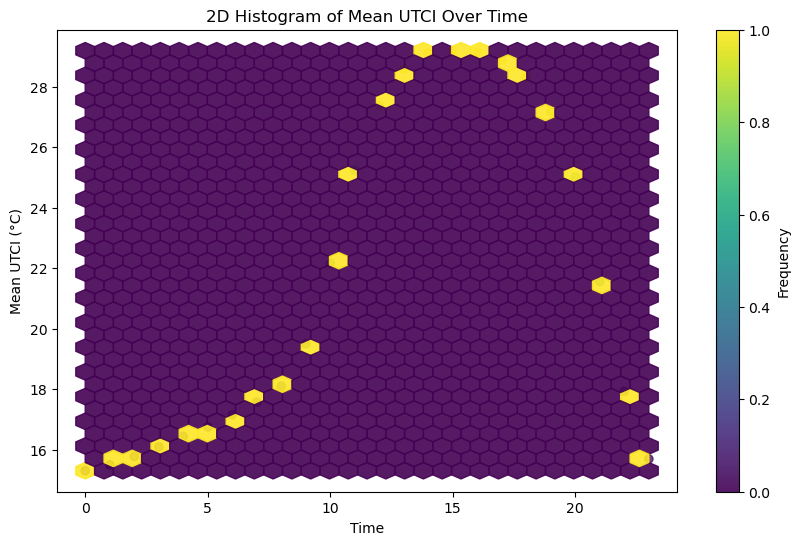

In [33]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np

# Load the dataset (replace 'file_path.nc' with your actual file path)
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_dv.nc')

# Extract UTCI data
utci = ds['utci'] - 273.16  # Assuming 'utci' is the variable name in your dataset
utci_mean = utci.mean(dim=('lat', 'lon'))  # Calculate mean over latitudes and longitudes

# Convert time to numeric format for plotting
time_numeric = np.arange(len(utci_mean.time))
# Reverse the time array
time_reversed = time_numeric[::-1]
# Plotting histogram for UTCI data
plt.figure(figsize=(10, 6))

# Scatter plot of UTCI vs. Time
plt.scatter(time_reversed, utci_mean, c=utci_mean, cmap='viridis', alpha=0.75)

# 2D Histogram using hexbin
plt.hexbin(time_reversed, utci_mean, gridsize=30, cmap='viridis', alpha=0.9)

# Customize plot labels and title
plt.xlabel('Time')
plt.ylabel('Mean UTCI (°C)')
plt.title('2D Histogram of Mean UTCI Over Time')
# Invert the x-axis
#plt.gca().invert_xaxis()
# Add colorbar
plt.colorbar(label='Frequency')

# Show the plot
plt.show()


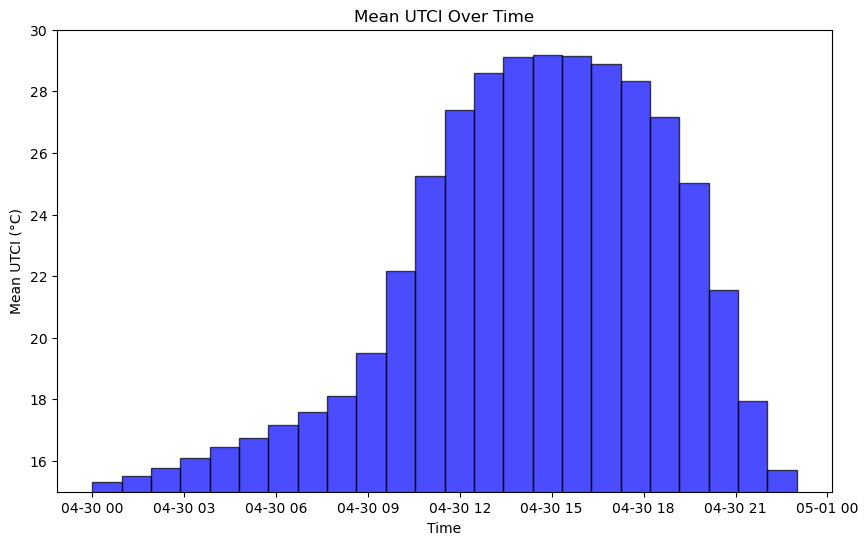

In [34]:
import xarray as xr
import matplotlib.pyplot as plt

# Load the dataset (replace 'file_path.nc' with your actual file path)
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_dv.nc')

# Extract UTCI data
utci = ds['utci'] - 273.16  # Assuming 'utci' is the variable name in your dataset
utci_mean = utci.mean(dim=('lat', 'lon'))  # Calculate mean over latitudes and longitudes

# Convert time to a numpy array for plotting
time = utci_mean['time'].values

# Reverse the time array
time_reversed = time[::-1]

# Plotting histogram for UTCI data
plt.figure(figsize=(10, 6))

# Plotting histogram using matplotlib's hist function
plt.hist(time_reversed, bins=len(time), weights=utci_mean.values, color='b', edgecolor='k', alpha=0.7)

# Customize plot labels and title
plt.xlabel('Time')
plt.ylabel('Mean UTCI (°C)')
plt.title('Mean UTCI Over Time')

# Set y-axis scale range
plt.ylim(15, 30)

# Show grid
#plt.grid(True)

# Show the plot
plt.show()


In [13]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
import matplotlib as mpl


# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\summer_project\newshp\india.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)
# Create a mask for the entire region
# Load the dataset (replace 'file_path.nc' with your actual file path)
ds1 = xr.open_dataset(r'C:\summer_project\heat_stress\utci_dv.nc')
ds2 = xr.open_dataset(r'C:\summer_project\heat_stress\t2m_dv.nc')
ds3 = xr.open_dataset(r'C:\summer_project\heat_stress\rh_dv.nc')
la1 = ds1['lat']
lo1 = ds1['lon']
la2 = ds2['latitude']
lo2 = ds2['longitude']
la3 = ds3['latitude']
lo3 = ds3['longitude']
mask1 = np.zeros((len(la1), len(lo1)), dtype=int)
mask2 = np.zeros((len(la2), len(lo2)), dtype=int)
mask3 = np.zeros((len(la3), len(lo3)), dtype=int)

for i, lat in enumerate(la1):
    for j, lon in enumerate(lo1):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0
for i, lat in enumerate(la2):
    for j, lon in enumerate(lo2):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0
for i, lat in enumerate(la3):
    for j, lon in enumerate(lo3):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0

# Apply the mask to the data, setting values outside India to NaN
utci_data_masked1 = ds1.where(mask1 == 1, np.nan)
utci_data_masked2 = ds2.where(mask2 == 1, np.nan)
utci_data_masked3 = ds3.where(mask3 == 1, np.nan)


In [15]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Load the dataset (replace 'file_path.nc' with your actual file path)
#ds1 = xr.open_dataset(r'C:\summer_project\heat_stress\utci_dv.nc')
#ds2 = xr.open_dataset(r'C:\summer_project\heat_stress\t2m_dv.nc')
#ds3 = xr.open_dataset(r'C:\summer_project\heat_stress\rh_dv.nc')

# Extract UTCI, T2M, and RH data
utci = utci_data_masked1['utci'] - 273.16  # Assuming 'utci' is in Kelvin and needs to be converted to Celsius
t2m = utci_data_masked2['t2m'] - 273.16  # Assuming 't2m' is in Kelvin and needs to be converted to Celsius
rh = utci_data_masked3['rh']  # Assuming 'rh' is already in percentage

# Calculate mean over latitudes and longitudes
utci_mean = utci.mean(dim=('lat', 'lon'))
t2m_mean = t2m.mean(dim=('latitude', 'longitude'))
rh_mean = rh.mean(dim=('latitude', 'longitude'))


In [16]:
# Convert the time data to a normal 24-hour time format
time = pd.to_datetime(ds1.time.values)  # Convert time values to datetime
time_hours = time.hour + time.minute / 60.0  # Extract hours and minutes as decimal hours
time_reversed = time_hours[::-1]  # Reverse the time array


In [11]:
print(utci_data_masked)

<xarray.Dataset>
Dimensions:  (time: 24, lat: 161, lon: 161)
Coordinates:
  * time     (time) datetime64[ns] 2005-04-30 ... 2005-04-30T23:00:00
  * lon      (lon) float64 60.0 60.25 60.5 60.75 61.0 ... 99.25 99.5 99.75 100.0
  * lat      (lat) float64 0.0 0.25 0.5 0.75 1.0 ... 39.0 39.25 39.5 39.75 40.0
Data variables:
    utci     (time, lat, lon) float32 nan nan nan nan nan ... nan nan nan nan
Attributes:
    CDI:          Climate Data Interface version 1.9.9rc1 (https://mpimet.mpg...
    Conventions:  CF-1.6
    history:      Wed Jan 10 11:05:09 2024: cdo mergetime utci_00.nc utci_01....
    CDO:          Climate Data Operators version 1.9.9rc1 (https://mpimet.mpg...


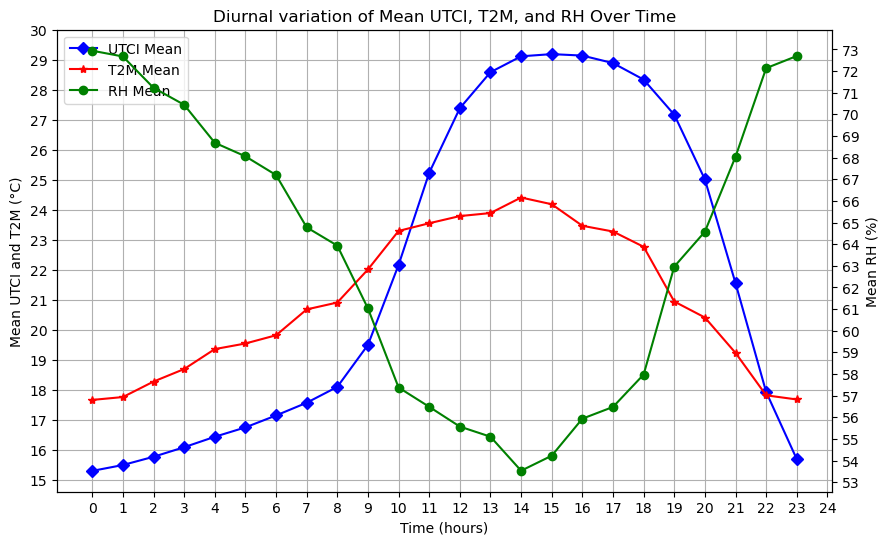

In [35]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Load the dataset (replace 'file_path.nc' with your actual file path)
ds1 = xr.open_dataset(r'C:\summer_project\heat_stress\utci_dv.nc')
ds2 = xr.open_dataset(r'C:\summer_project\heat_stress\t2m_dv.nc')
ds3 = xr.open_dataset(r'C:\summer_project\heat_stress\rh_dv.nc')

# Extract UTCI, T2M, and RH data
utci = ds1['utci'] - 273.16  # Assuming 'utci' is in Kelvin and needs to be converted to Celsius
t2m = ds2['t2m'] - 273.16  # Assuming 't2m' is in Kelvin and needs to be converted to Celsius
rh = ds3['rh']  # Assuming 'rh' is already in percentage

# Calculate mean over latitudes and longitudes
utci_mean = utci.mean(dim=('lat', 'lon'))
t2m_mean = t2m.mean(dim=('latitude', 'longitude'))
rh_mean = rh.mean(dim=('latitude', 'longitude'))

# Convert the time data to a normal 24-hour time format
time = pd.to_datetime(ds1.time.values)  # Convert time values to datetime
time_hours = time.hour + time.minute / 60.0  # Extract hours and minutes as decimal hours
time_reversed = time_hours[::-1]  # Reverse the time array

# Create a figure and a set of subplots
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plotting line plot using matplotlib's plot function for UTCI and T2M
ax1.plot(time_reversed, utci_mean, marker='D', linestyle='-', color='b', label='UTCI Mean')
ax1.plot(time_reversed, t2m_mean, marker='*', linestyle='-', color='r', label='T2M Mean')

# Customize primary y-axis (left) labels and title
ax1.set_xlabel('Time (hours)')
ax1.set_ylabel('Mean UTCI and T2M (°C)')
ax1.set_title('Diurnal variation of Mean UTCI, T2M, and RH Over Time')
ax1.grid(True)

# Set x and y-axis ticks to intervals of 1
ax1.set_xticks(np.arange(0, 25, 1))  # Assuming 24 hours in the time range
ax1.set_yticks(np.arange(np.floor(utci_mean.min()), np.ceil(utci_mean.max()) + 1, 1))

# Create a secondary y-axis for RH
ax2 = ax1.twinx()
ax2.plot(time_reversed, rh_mean, marker='o', linestyle='-', color='g', label='RH Mean')

# Customize secondary y-axis (right) labels and ticks
ax2.set_ylabel('Mean RH (%)')
ax2.set_yticks(np.arange(np.floor(rh_mean.min()), np.ceil(rh_mean.max()) + 1, 1))

# Add legends for both y-axes
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper left')

# Show the plot
plt.show()


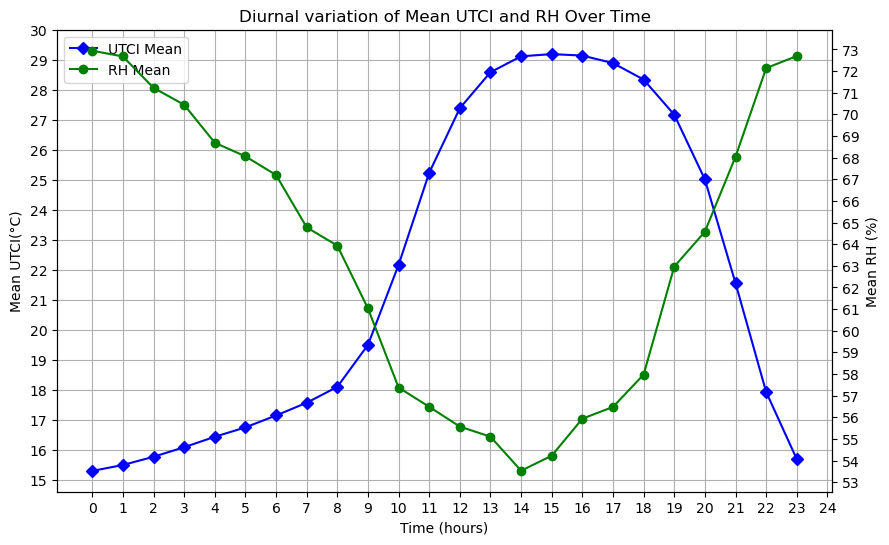

In [7]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Load the dataset (replace 'file_path.nc' with your actual file path)
ds1 = xr.open_dataset(r'C:\summer_project\heat_stress\utci_dv.nc')
ds2 = xr.open_dataset(r'C:\summer_project\heat_stress\t2m_dv.nc')
ds3 = xr.open_dataset(r'C:\summer_project\heat_stress\rh_dv.nc')

# Extract UTCI, T2M, and RH data
utci = ds1['utci'] - 273.16  # Assuming 'utci' is in Kelvin and needs to be converted to Celsius
#t2m = ds2['t2m'] - 273.16  # Assuming 't2m' is in Kelvin and needs to be converted to Celsius
rh = ds3['rh']  # Assuming 'rh' is already in percentage

# Calculate mean over latitudes and longitudes
utci_mean = utci.mean(dim=('lat', 'lon'))
#t2m_mean = t2m.mean(dim=('latitude', 'longitude'))
rh_mean = rh.mean(dim=('latitude', 'longitude'))

# Convert the time data to a normal 24-hour time format
time = pd.to_datetime(ds1.time.values)  # Convert time values to datetime
time_hours = time.hour + time.minute / 60.0  # Extract hours and minutes as decimal hours
time_reversed = time_hours[::-1]  # Reverse the time array

# Create a figure and a set of subplots
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plotting line plot using matplotlib's plot function for UTCI and T2M
ax1.plot(time_reversed, utci_mean, marker='D', linestyle='-', color='b', label='UTCI Mean')
#ax1.plot(time_reversed, t2m_mean, marker='*', linestyle='-', color='r', label='T2M Mean')

# Customize primary y-axis (left) labels and title
ax1.set_xlabel('Time (hours)')
ax1.set_ylabel('Mean UTCI(°C)')
ax1.set_title('Diurnal variation of Mean UTCI and RH Over Time')
ax1.grid(True)

# Set x and y-axis ticks to intervals of 1
ax1.set_xticks(np.arange(0, 25, 1))  # Assuming 24 hours in the time range
ax1.set_yticks(np.arange(np.floor(utci_mean.min()), np.ceil(utci_mean.max()) + 1, 1))

# Create a secondary y-axis for RH
ax2 = ax1.twinx()
ax2.plot(time_reversed, rh_mean, marker='o', linestyle='-', color='g', label='RH Mean')

# Customize secondary y-axis (right) labels and ticks
ax2.set_ylabel('Mean RH (%)')
ax2.set_yticks(np.arange(np.floor(rh_mean.min()), np.ceil(rh_mean.max()) + 1, 1))

# Add legends for both y-axes
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper left')

# Show the plot
plt.show()


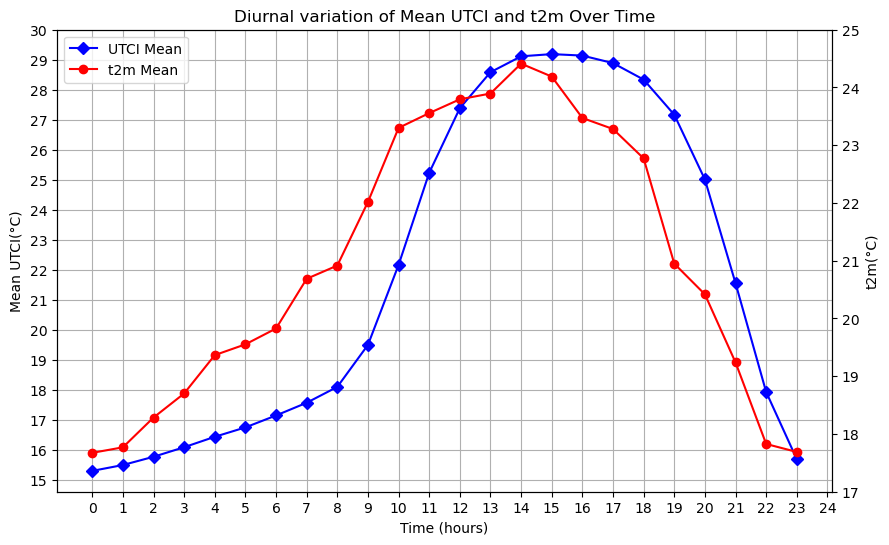

In [11]:
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Load the dataset (replace 'file_path.nc' with your actual file path)
ds1 = xr.open_dataset(r'C:\summer_project\heat_stress\utci_dv.nc')
ds2 = xr.open_dataset(r'C:\summer_project\heat_stress\t2m_dv.nc')
ds3 = xr.open_dataset(r'C:\summer_project\heat_stress\rh_dv.nc')

# Extract UTCI, T2M, and RH data
utci = ds1['utci'] - 273.16  # Assuming 'utci' is in Kelvin and needs to be converted to Celsius
t2m = ds2['t2m'] - 273.16  # Assuming 't2m' is in Kelvin and needs to be converted to Celsius
#rh = ds3['rh']  # Assuming 'rh' is already in percentage

# Calculate mean over latitudes and longitudes
utci_mean = utci.mean(dim=('lat', 'lon'))
t2m_mean = t2m.mean(dim=('latitude', 'longitude'))
#rh_mean = rh.mean(dim=('latitude', 'longitude'))

# Convert the time data to a normal 24-hour time format
time = pd.to_datetime(ds1.time.values)  # Convert time values to datetime
time_hours = time.hour + time.minute / 60.0  # Extract hours and minutes as decimal hours
time_reversed = time_hours[::-1]  # Reverse the time array

# Create a figure and a set of subplots
fig, ax1 = plt.subplots(figsize=(10, 6))

# Plotting line plot using matplotlib's plot function for UTCI and T2M
ax1.plot(time_reversed, utci_mean, marker='D', linestyle='-', color='b', label='UTCI Mean')
#ax1.plot(time_reversed, t2m_mean, marker='*', linestyle='-', color='r', label='T2M Mean')

# Customize primary y-axis (left) labels and title
ax1.set_xlabel('Time (hours)')
ax1.set_ylabel('Mean UTCI(°C)')
ax1.set_title('Diurnal variation of Mean UTCI and t2m Over Time')
ax1.grid(True)

# Set x and y-axis ticks to intervals of 1
ax1.set_xticks(np.arange(0, 25, 1))  # Assuming 24 hours in the time range
ax1.set_yticks(np.arange(np.floor(utci_mean.min()), np.ceil(utci_mean.max()) + 1, 1))

# Create a secondary y-axis for RH
ax2 = ax1.twinx()
ax2.plot(time_reversed, t2m_mean, marker='o', linestyle='-', color='r', label='t2m Mean')

# Customize secondary y-axis (right) labels and ticks
ax2.set_ylabel('t2m(°C)')
#ax2.set_yticks(np.arange(np.floor(rh_mean.min()), np.ceil(rh_mean.max()) + 1, 1))
ax2.set_yticks(np.arange(np.floor(t2m_mean.min()), np.ceil(t2m_mean.max()) + 1, 1))
# Add legends for both y-axes
lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper left')

# Show the plot
plt.show()


In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
import matplotlib as mpl

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\temp_daily.nc')
t2m = ds['t2m'] - 273.16  # Convert temperature from Kelvin to Celsius

# Extract data for different time periods
t2m_time1 = t2m.sel(time=slice('1990-03-01', '2000-06-30')).mean(dim='time')
t2m_time2 = t2m.sel(time=slice('2001-03-01', '2010-06-30')).mean(dim='time')
t2m_time3 = t2m.sel(time=slice('2011-03-01', '2020-06-30')).mean(dim='time')
t2m_time4 = t2m.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')#climatology

# Calculate the trends
trend1 = t2m_time1 - t2m_time4
trend2 = t2m_time2 - t2m_time4
trend3 = t2m_time3 - t2m_time4

# Extract latitude and longitude values
lats = ds['latitude'].values
lons = ds['longitude'].values

# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1

# Apply the mask to the data
t2m_time1_masked = t2m_time1.where(mask == 1)
t2m_time2_masked = t2m_time2.where(mask == 1)
t2m_time3_masked = t2m_time3.where(mask == 1)
t2m_time4_masked = t2m_time4.where(mask == 1)
trend1_masked = trend1.where(mask == 1)
trend2_masked = trend2.where(mask == 1)
trend3_masked = trend3.where(mask == 1)

# # Plot the data
# mon = [utci_time4_masked, trend1_masked, trend2_masked, trend3_masked]
# titles = ['Climate Mean 1990-2019', 'Trend 1990-1999', 'Trend 2000-2009', 'Trend 2010-2019']

# # Define levels for contourf
# levels = np.arange(3, 45.1, 2)

# # Plot for each time period
# fig, axes = plt.subplots(2, 2, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
# axes = axes.flatten()

# for i, ax in enumerate(axes):
#     mpl.rcParams['figure.facecolor'] = 'white'
#     cf = ax.contourf(lons, lats, mon[i], levels=levels, cmap='jet', transform=ccrs.PlateCarree(), extend='both')
#     ax.add_feature(india_feature)
#     cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.58, label="UTCI Stress")
#     ax.set_title(titles[i])

# plt.tight_layout()
# plt.show()


C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


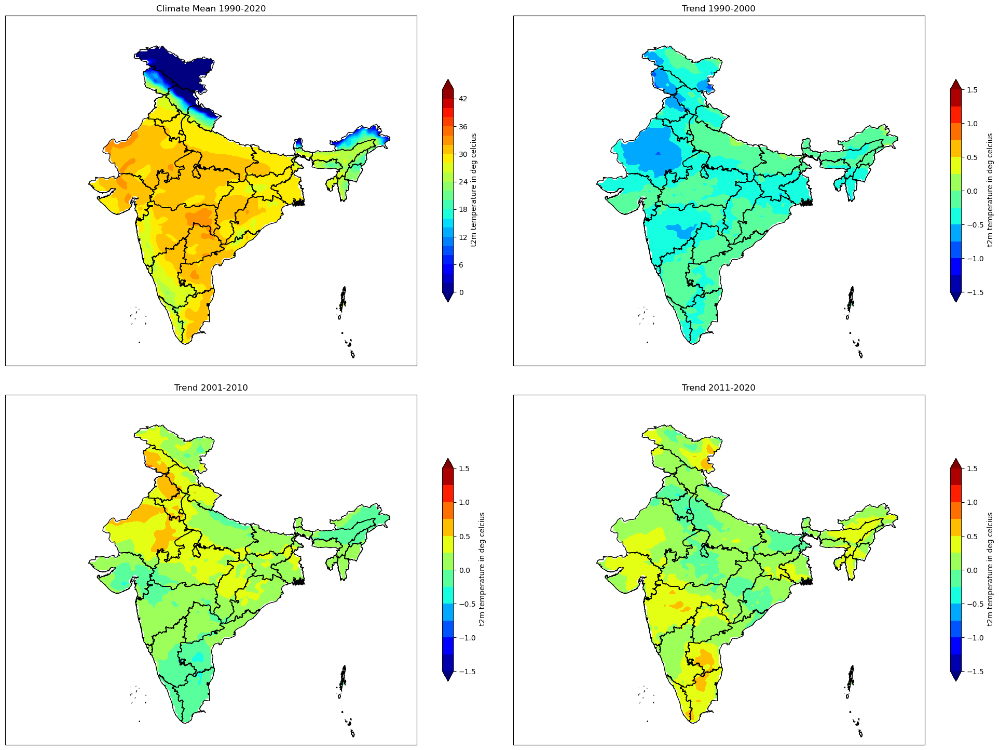

In [3]:
# Plot the data
mon = [t2m_time4_masked, trend1_masked, trend2_masked, trend3_masked]
titles = ['Climate Mean 1990-2020', 'Trend 1990-2000', 'Trend 2001-2010', 'Trend 2011-2020']

# Define individual levels for each plot
levels_list = [
    np.arange(0, 45.1, 2),  # Levels for Climate Mean 1990-2019
    np.arange(-1.5, 1.51, 0.25),  # Levels for Trend 1990-1999
    np.arange(-1.5, 1.51, 0.25),  # Levels for Trend 2000-2009
    np.arange(-1.5, 1.51, 0.25)   # Levels for Trend 2010-2019
]

# Plot for each time period
fig, axes = plt.subplots(2, 2, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()

for i, ax in enumerate(axes):
    mpl.rcParams['figure.facecolor'] = 'white'
    cf = ax.contourf(lons, lats, mon[i], levels=levels_list[i], cmap='jet', transform=ccrs.PlateCarree(), extend='both')
    ax.add_feature(india_feature)
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.58, label=" t2m temperature in deg celcius")
    ax.set_title(titles[i])

plt.tight_layout()
plt.show()

In [ ]:
# Plot the data
mon = [rh_time4_masked, trend1_masked, trend2_masked, trend3_masked]
titles = ['Climate Mean 1990-2020', 'Trend 1990-2000', 'Trend 2001-2010', 'Trend 2011-2020']

# Define individual levels for each plot
levels_list = [
    np.arange(0, 45.1, 2),  # Levels for Climate Mean 1990-2019
    np.arange(-1.5, 1.51, 0.25),  # Levels for Trend 1990-1999
    np.arange(-1.5, 1.51, 0.25),  # Levels for Trend 2000-2009
    np.arange(-1.5, 1.51, 0.25)   # Levels for Trend 2010-2019
]

# Plot for each time period
fig, axes = plt.subplots(2, 2, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()

for i, ax in enumerate(axes):
    mpl.rcParams['figure.facecolor'] = 'white'
    cf = ax.contourf(lons, lats, mon[i], levels=levels_list[i], cmap='jet', transform=ccrs.PlateCarree(), extend='both')
    ax.add_feature(india_feature)
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.58, label="Relative Humidity in 100 percentage")
    ax.set_title(titles[i])

plt.tight_layout()
plt.show()

In [7]:
import numpy as np
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\ws_daily.nc')
ws = ds['ws'] #relative humidity is in the form of percenttage in 100%
print(ds)

<xarray.Dataset>
Dimensions:    (time: 3782, bnds: 2, longitude: 161, latitude: 137)
Coordinates:
  * time       (time) datetime64[ns] 1990-03-01T11:00:00 ... 2020-06-30T11:00:00
  * longitude  (longitude) float32 60.0 60.25 60.5 60.75 ... 99.5 99.75 100.0
  * latitude   (latitude) float32 6.0 6.25 6.5 6.75 ... 39.25 39.5 39.75 40.0
Dimensions without coordinates: bnds
Data variables:
    time_bnds  (time, bnds) datetime64[ns] ...
    ws         (time, latitude, longitude) float32 ...
Attributes:
    CDI:          Climate Data Interface version 1.9.9rc1 (https://mpimet.mpg...
    Conventions:  CF-1.6
    history:      Thu Jan 18 10:47:05 2024: cdo daymean ws.nc ws_daily.nc\nTh...
    frequency:    day
    CDO:          Climate Data Operators version 1.9.9rc1 (https://mpimet.mpg...


In [8]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
import matplotlib as mpl

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\ws_daily.nc')
ws = ds['ws'] #relative humidity is in the form of percenttage in 100%

# Extract data for different time periods
ws_time1 = ws.sel(time=slice('1990-03-01', '2000-06-30')).mean(dim='time')
ws_time2 = ws.sel(time=slice('2001-03-01', '2010-06-30')).mean(dim='time')
ws_time3 = ws.sel(time=slice('2011-03-01', '2020-06-30')).mean(dim='time')
ws_time4 = ws.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')#climatology

# Calculate the trends
trend1 = ws_time1 - ws_time4
trend2 = ws_time2 - ws_time4
trend3 = ws_time3 - ws_time4

# Extract latitude and longitude values
lats = ds['latitude'].values
lons = ds['longitude'].values

# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1

# Apply the mask to the data
ws_time1_masked = ws_time1.where(mask == 1)
ws_time2_masked = ws_time2.where(mask == 1)
ws_time3_masked = ws_time3.where(mask == 1)
ws_time4_masked = ws_time4.where(mask == 1)
trend1_masked = trend1.where(mask == 1)
trend2_masked = trend2.where(mask == 1)
trend3_masked = trend3.where(mask == 1)

# # Plot the data
# mon = [utci_time4_masked, trend1_masked, trend2_masked, trend3_masked]
# titles = ['Climate Mean 1990-2019', 'Trend 1990-1999', 'Trend 2000-2009', 'Trend 2010-2019']

# # Define levels for contourf
# levels = np.arange(3, 45.1, 2)

# # Plot for each time period
# fig, axes = plt.subplots(2, 2, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
# axes = axes.flatten()

# for i, ax in enumerate(axes):
#     mpl.rcParams['figure.facecolor'] = 'white'
#     cf = ax.contourf(lons, lats, mon[i], levels=levels, cmap='jet', transform=ccrs.PlateCarree(), extend='both')
#     ax.add_feature(india_feature)
#     cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.58, label="UTCI Stress")
#     ax.set_title(titles[i])

# plt.tight_layout()
# plt.show()


C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)


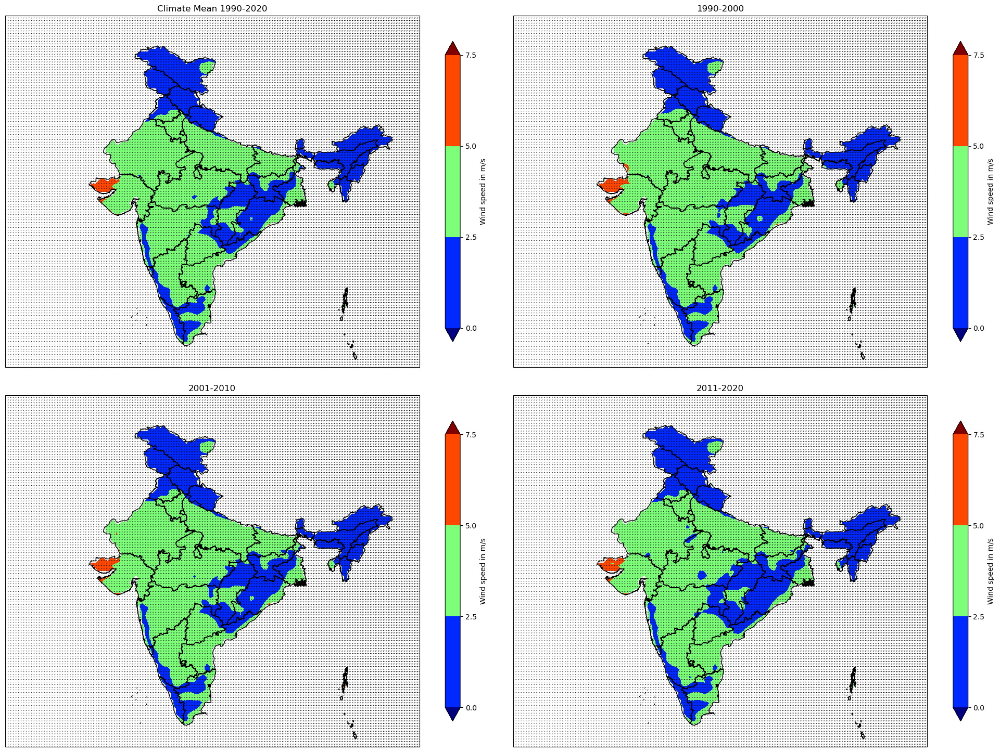

In [42]:
# Assuming ws_time4_masked, ws_time1_masked, ws_time2_masked, ws_time3_masked, lons, lats, and india_feature are defined

import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import cartopy.crs as ccrs

mon = [ws_time4_masked, ws_time1_masked, ws_time2_masked, ws_time3_masked]
titles = ['Climate Mean 1990-2020', '1990-2000', '2001-2010', '2011-2020']
x, y = np.meshgrid(lons, lats)

# Define individual levels for each plot
levels = [
    np.arange(0, 10, 2.5),  # Levels for Climate Mean 1990-2019
    np.arange(0, 10, 2.5),  # Levels for Trend 1990-1999
    np.arange(0, 10, 2.5),  # Levels for Trend 2000-2009
    np.arange(0, 10, 2.5)   # Levels for Trend 2010-2019
]

# Plot for each time period
fig, axes = plt.subplots(2, 2, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()

for i, ax in enumerate(axes):
    mpl.rcParams['figure.facecolor'] = 'white'
    # Create a contour plot with levels
    cf = ax.contourf(lons, lats, mon[i], levels=levels[i], cmap='jet',
                     transform=ccrs.PlateCarree(), extend='both', shrink=0.49)
    # Create a quiver plot (assuming u and v are defined as wind components)
    q = ax.quiver(lons, lats, x, y, transform=ccrs.PlateCarree())
    # Add a quiver key
    qk = ax.quiverkey(q, 0.9, -0.1, 1, '1 m/s', labelpos='E', coordinates='axes', fontproperties={'size': 6})
    ax.add_feature(india_feature)
    # Add a colorbar
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.78, label="Wind speed in m/s")
    ax.set_title(titles[i])

plt.tight_layout()
plt.show()


In [ ]:
# Define UTCI range of interest
utci_min = [26, 32, 38, 46]
utci_max = [32, 38, 46, 100]  # Assuming this is the upper limit for the highest range

# Count number of days within the specified UTCI ranges
days_in_ranges = []
for min_temp, max_temp in zip(utci_min, utci_max):
    days_in_range = ((utci >= min_temp) & (utci <= max_temp)).sum(dim='time')
    days_in_ranges.append(days_in_range)

# Plot the data
titles = [
    'Number of days with UTCI between 26-32°C',
    'Number of days with UTCI between 32-38°C',
    'Number of days with UTCI between 38-46°C',
    'Number of days with UTCI more than 46°C'
]

# Define individual levels for each plot
levels_list = [
    np.arange(0, 3700.1, 250),
    np.arange(0, 3700.1, 250),
    np.arange(0, 3700.1, 250),
    np.arange(0, 3700.1, 250)
]

# Plot for each time period
fig, axes = plt.subplots(2, 2, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()

for i, ax in enumerate(axes):
    mpl.rcParams['figure.facecolor'] = 'white'
    cf = ax.contourf(lons, lats, days_in_ranges[i], levels=levels_list[i], cmap='jet', transform=ccrs.PlateCarree(), extend='both')
    ax.add_feature(india_feature)
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.58, label="Number of days")
    ax.set_title(titles[i])

plt.tight_layout()
plt.show()

In [ ]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
import matplotlib as mpl

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_daily.nc')
utci = ds['utci'] - 273.16  # Convert temperature from Kelvin to Celsius

# Create a mask for the entire region using xarray
lon_bnds, lat_bnds = [ds.lon.min(), ds.lon.max()], [ds.lat.min(), ds.lat.max()]
mask_lon, mask_lat = np.meshgrid(ds.lon, ds.lat)

mask = np.array([india_polygon.contains(Point(lon, lat)) for lon, lat in zip(mask_lon.flatten(), mask_lat.flatten())])
mask = mask.reshape(mask_lon.shape)

# Apply the mask to the data
utci_masked = utci.where(mask, np.nan)

# Extract data for different time periods
utci_time1 = utci_masked.sel(time=slice('1990-03-01', '2000-06-30')).mean(dim='time')
utci_time2 = utci_masked.sel(time=slice('2001-03-01', '2010-06-30')).mean(dim='time')
utci_time3 = utci_masked.sel(time=slice('2011-03-01', '2020-06-30')).mean(dim='time')
utci_time4 = utci_masked.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')  # Climatology

# Calculate the trends
trend1 = utci_time1 - utci_time4
trend2 = utci_time2 - utci_time4
trend3 = utci_time3 - utci_time4

# Define UTCI range of interest
utci_time4_masked_min = [26, 32, 38, 46]
utci_time4_masked_max = [32, 38, 46, 100]  # Assuming this is the upper limit for the highest range

# Count number of days within the specified UTCI ranges
days_in_ranges = []
for min_temp, max_temp in zip(utci_time4_masked_min, utci_time4_masked_max):
    days_in_range = ((utci_masked >= min_temp) & (utci_masked <= max_temp)).sum(dim='time')
    days_in_ranges.append(days_in_range)

# Plot the data
titles = [
    'Number of days with UTCI between 26-32°C',
    'Number of days with UTCI between 32-38°C',
    'Number of days with UTCI between 38-46°C',
    'Number of days with UTCI more than 46°C'
]

# Define individual levels for each plot
levels_list = [
    np.arange(0, 3700.1, 250),
    np.arange(0, 3700.1, 250),
    np.arange(0, 3700.1, 250),
    np.arange(0, 3700.1, 250)
]

# Plot for each time period
fig, axes = plt.subplots(2, 2, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()

for i, ax in enumerate(axes):
    mpl.rcParams['figure.facecolor'] = 'white'
    cf = ax.contourf(ds.lon, ds.lat, days_in_ranges[i], levels=levels_list[i], cmap='jet', transform=ccrs.PlateCarree(), extend='both')
    ax.add_feature(india_feature)
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.58, label="Number of days")
    ax.set_title(titles[i])

plt.tight_layout()
plt.show()


C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


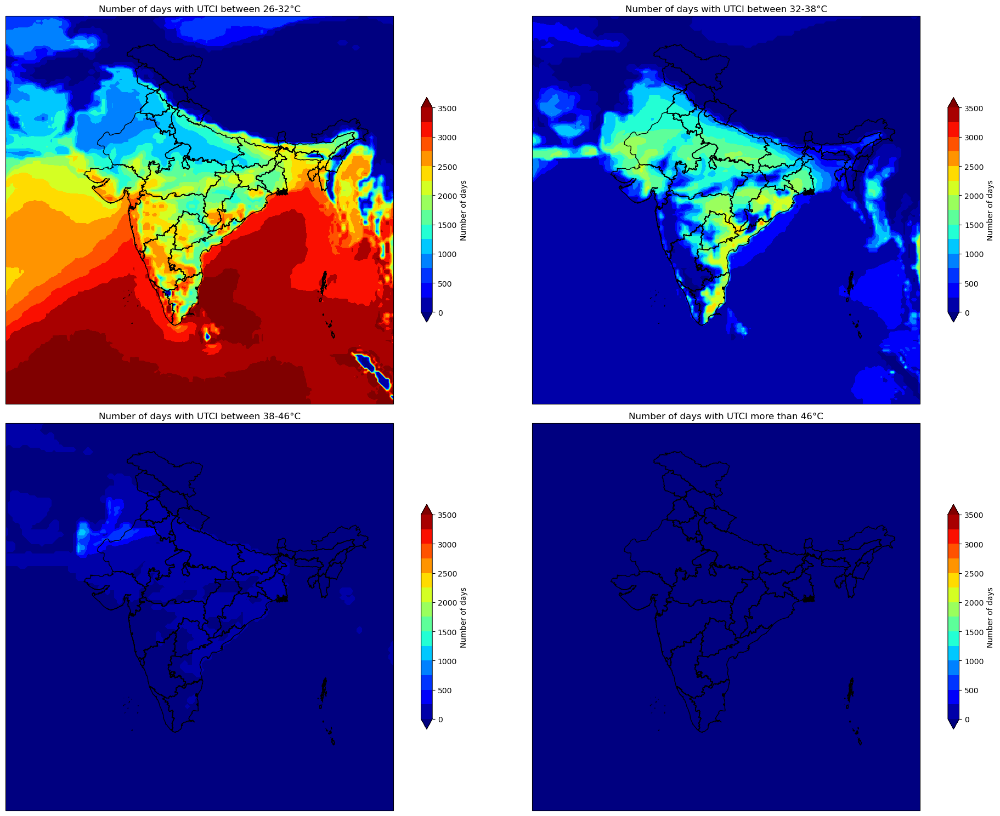

In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
import matplotlib as mpl

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_daily.nc')
utci = ds['utci'] - 273.15  # Convert temperature from Kelvin to Celsius

# Extract data for the entire period
utci_climatology = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')

# Extract latitude and longitude values
lats = ds['lat'].values
lons = ds['lon'].values

# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0

# Apply the mask to the data
utci_climatology_masked = utci_climatology.where(mask == 1, np.nan)

# Define UTCI range of interest
utci_ranges_min = [26, 32, 38, 46]
utci_ranges_max = [32, 38, 46, 100]

# Count number of days within the specified UTCI ranges
days_in_ranges = []
for min_temp, max_temp in zip(utci_ranges_min, utci_ranges_max):
    days_in_range = ((utci >= min_temp) & (utci <= max_temp)).sum(dim='time')
    days_in_ranges.append(days_in_range)

# Plot the data
titles = [
    'Number of days with UTCI between 26-32°C',
    'Number of days with UTCI between 32-38°C',
    'Number of days with UTCI between 38-46°C',
    'Number of days with UTCI more than 46°C'
]

# Define individual levels for each plot
levels_list = [
    np.arange(0, 3700.1, 250),
    np.arange(0, 3700.1, 250),
    np.arange(0, 3700.1, 250),
    np.arange(0, 3700.1, 250)
]

# Plot for each time period
fig, axes = plt.subplots(2, 2, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()

for i, ax in enumerate(axes):
    mpl.rcParams['figure.facecolor'] = 'white'
    cf = ax.contourf(lons, lats, days_in_ranges[i], levels=levels_list[i], cmap='jet', transform=ccrs.PlateCarree(), extend='both')
    ax.add_feature(india_feature)
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.58, label="Number of days")
    ax.set_title(titles[i])

plt.tight_layout()
plt.show()


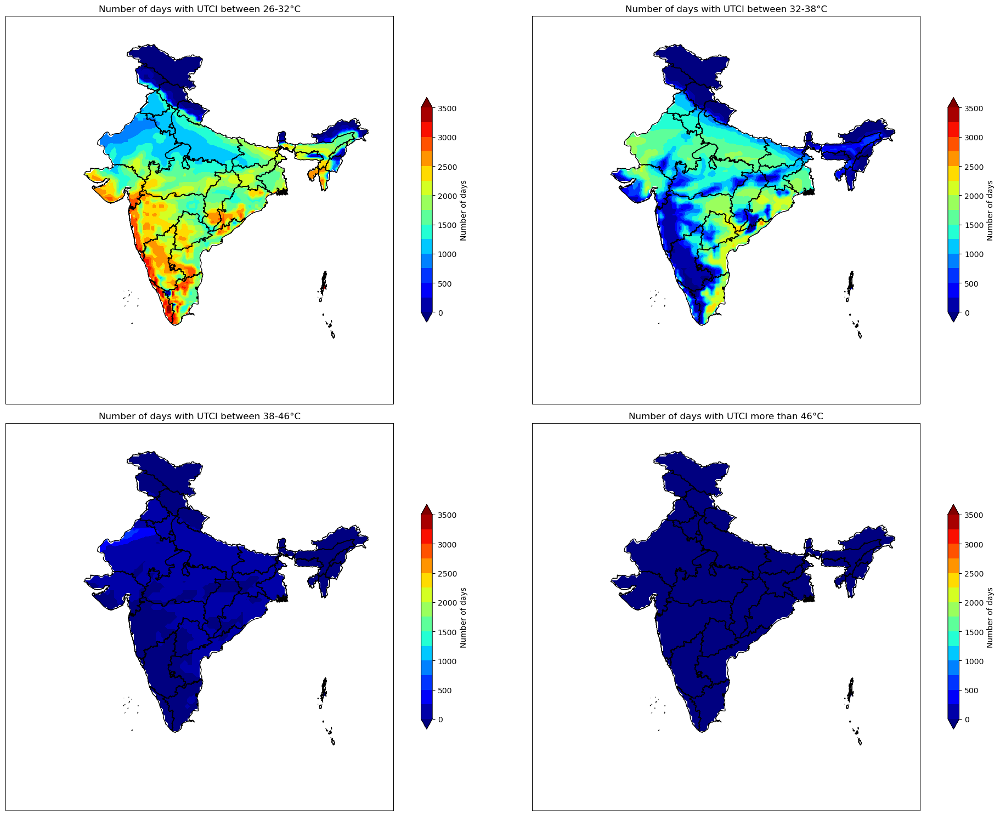

In [14]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
import matplotlib as mpl

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_daily.nc')
utci = ds['utci'] - 273.16  # Convert temperature from Kelvin to Celsius

# Extract latitude and longitude values
lats = ds['lat'].values
lons = ds['lon'].values

# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0

# Define UTCI range of interest
utci_ranges = [
    (26, 32),
    (32, 38),
    (38, 46),
    (46, 100)
]

# Count number of days within the specified UTCI ranges
days_in_ranges = []
for min_temp, max_temp in utci_ranges:
    days_in_range = ((utci >= min_temp) & (utci <= max_temp)).sum(dim='time')
    # Apply the mask to the days count
    days_in_range_masked = days_in_range.where(mask == 1, np.nan)
    days_in_ranges.append(days_in_range_masked)

# Plot the data
titles = [
    'Number of days with UTCI between 26-32°C',
    'Number of days with UTCI between 32-38°C',
    'Number of days with UTCI between 38-46°C',
    'Number of days with UTCI more than 46°C'
]

# Define individual levels for each plot
levels_list = [
    np.arange(0, 3700.1, 250),
    np.arange(0, 3700.1, 250),
    np.arange(0, 3700.1, 250),
    np.arange(0, 3700.1, 250)
]

# Plot for each time period
fig, axes = plt.subplots(2, 2, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()

for i, ax in enumerate(axes):
    mpl.rcParams['figure.facecolor'] = 'white'
    cf = ax.contourf(lons, lats, days_in_ranges[i], levels=levels_list[i], cmap='jet', transform=ccrs.PlateCarree(), extend='both')
    ax.add_feature(india_feature)
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.58, label="Number of days")
    ax.set_title(titles[i])

plt.tight_layout()
plt.show()


C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'fontsize', 'fontweight'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'fontsize', 'fontweight'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'fontsize', 'fontweight'
  result = super().contourf(*args, **kwargs)


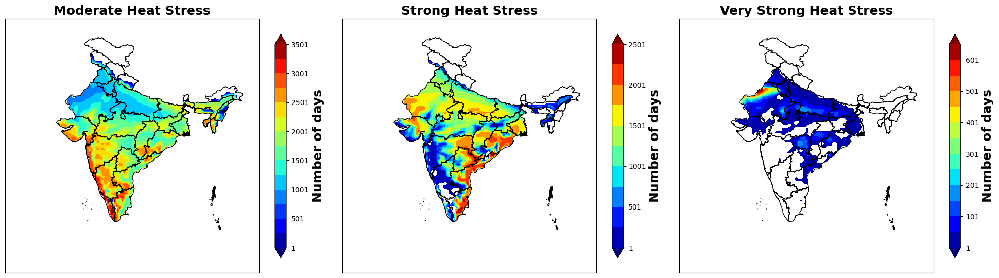

In [27]:
# Define UTCI range of interest
utci_ranges = [
    (26, 32),
    (32, 38),
    (38, 46),
    (46, 100)
]

## Count number of days within the specified UTCI ranges
#days_in_ranges = []
#for min_temp, max_temp in utci_ranges:
#    days_in_range = ((utci >= min_temp) & (utci <= max_temp)).sum(dim='time')
#    # Apply the mask to the days count
#    days_in_range_masked = days_in_range.where(mask == 1, np.nan)
#    days_in_ranges.append(days_in_range_masked)
#days_in_ranges = [i(0==np.nan)]
## Plot the data
days_in_ranges = []
for min_temp, max_temp in utci_ranges:
    days_in_range = ((utci >= min_temp) & (utci <= max_temp)).sum(dim='time')
    # Apply the mask to the days count
    days_in_range_masked = days_in_range.where(mask == 1, np.nan)
    # Replace zero values with np.nan
    days_in_range_masked = days_in_range_masked.where(days_in_range_masked != 0, np.nan)
    days_in_ranges.append(days_in_range_masked)
titles = [
    'Moderate Heat Stress',
    'Strong Heat Stress',
    'Very Strong Heat Stress'
]


# Define individual levels for each plot
levels_list = [
    np.arange(1, 3700.1, 250),
    np.arange(1, 2700.1, 250),
    np.arange(1, 700.1, 50)
]

# Plot for each time period
fig, axes = plt.subplots(1, 3, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()

for i, ax in enumerate(axes):
    mpl.rcParams['figure.facecolor'] = 'white'
    cf = ax.contourf(lons, lats, days_in_ranges[i], levels=levels_list[i],
                     cmap='jet', transform=ccrs.PlateCarree(), extend='both', fontsize=12, fontweight='bold')
    ax.add_feature(india_feature)
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.30, label="Number of days")
    # Add colorbar with specified properties
    #cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.35)
    cbar.set_label("Number of days", fontsize=18, fontweight='bold')
    ax.set_title(titles[i], fontsize=18, fontweight='bold')
for ax in [axes]:
    ax.set_xticks(np.arange(65.7, 97.25, 10), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(5, 37.6, 5), crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)))
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)))

plt.tight_layout()
plt.show()


In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
import matplotlib as mpl

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\summer_project\heat_stress\utci_daily.nc')
utci = ds['utci'] - 273.16  # Convert temperature from Kelvin to Celsius

# Extract latitude and longitude values
lats = ds['lat'].values
lons = ds['lon'].values

# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0


C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'fontsize', 'fontweight'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'fontsize', 'fontweight'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'fontsize', 'fontweight'
  result = super().contourf(*args, **kwargs)


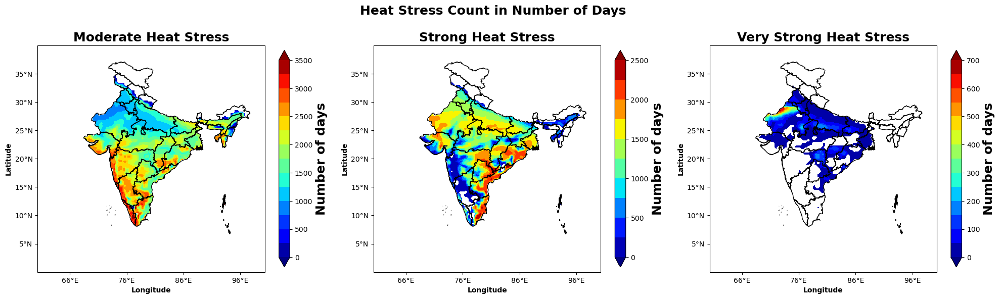

In [17]:
# Define UTCI range of interest
utci_ranges = [
    (26, 32),
    (32, 38),
    (38, 46),
    (46, 100)
]

## Count number of days within the specified UTCI ranges
#days_in_ranges = []
#for min_temp, max_temp in utci_ranges:
#    days_in_range = ((utci >= min_temp) & (utci <= max_temp)).sum(dim='time')
#    # Apply the mask to the days count
#    days_in_range_masked = days_in_range.where(mask == 1, np.nan)
#    days_in_ranges.append(days_in_range_masked)
#days_in_ranges = [i(0==np.nan)]
## Plot the data
days_in_ranges = []
for min_temp, max_temp in utci_ranges:
    days_in_range = ((utci >= min_temp) & (utci <= max_temp)).sum(dim='time')
    # Apply the mask to the days count
    days_in_range_masked = days_in_range.where(mask == 1, np.nan)
    # Replace zero values with np.nan
    days_in_range_masked = days_in_range_masked.where(days_in_range_masked != 0, np.nan)
    days_in_ranges.append(days_in_range_masked)
titles = [
    'Moderate Heat Stress',
    'Strong Heat Stress',
    'Very Strong Heat Stress'
]


# Define individual levels for each plot
levels_list = [
    np.arange(0, 3700.1, 250),
    np.arange(0, 2700.1, 250),
    np.arange(0, 700.1, 50)
]

# Plot for each time period
fig, axes = plt.subplots(1, 3, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()

for i, ax in enumerate(axes):
    mpl.rcParams['figure.facecolor'] = 'white'
    cf = ax.contourf(lons, lats, days_in_ranges[i], levels=levels_list[i],
                     cmap='jet', transform=ccrs.PlateCarree(), extend='both', fontsize=12, fontweight='bold')
    ax.add_feature(india_feature)
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.30, label="Number of days")
    # Add colorbar with specified properties
    #cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.35)
    cbar.set_label("Number of days", fontsize=18, fontweight='bold')
    ax.set_ylabel('Latitude', fontweight='bold')
    ax.set_xlabel('Longitude', fontweight='bold')
    ax.set_title(titles[i], fontsize=18, fontweight='bold')
#for ax in [axes]:
 #   ax.set_xticks(np.arange(65.7, 97.25, 10), crs=ccrs.PlateCarree())
  #  ax.set_yticks(np.arange(5, 37.6, 5), crs=ccrs.PlateCarree())
   # ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)))
    #ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)))
# Adjust ticks for all axes
for ax in axes:
    ax.set_xticks(np.arange(65.7, 97.25, 10), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(5, 37.6, 5), crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)), fontweight='bold')
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)), fontweight='bold')
q = plt.suptitle('Heat Stress Count in Number of Days', fontsize=18, fontweight='bold')
q.set_position([0.49, 0.69, 0.2, 0.42834])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

plt.tight_layout()
plt.show()

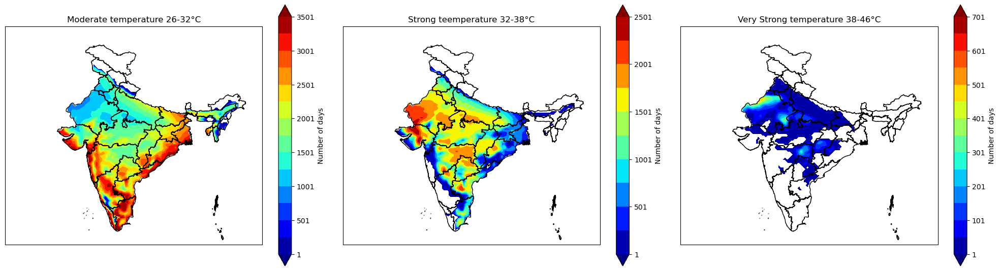

In [13]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
import matplotlib as mpl

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\temp_daily.nc')
t2m = ds['t2m'] - 273.16  # Convert temperature from Kelvin to Celsius

# Extract latitude and longitude values
lats = ds['latitude'].values
lons = ds['longitude'].values

# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0

# Define UTCI range of interest
t2m_ranges = [
    (26, 32),
    (32, 38),
    (38, 46),
    (46, 100)
]

## Count number of days within the specified UTCI ranges
#days_in_ranges = []
#for min_temp, max_temp in utci_ranges:
#    days_in_range = ((utci >= min_temp) & (utci <= max_temp)).sum(dim='time')
#    # Apply the mask to the days count
#    days_in_range_masked = days_in_range.where(mask == 1, np.nan)
#    days_in_ranges.append(days_in_range_masked)
#days_in_ranges = [i(0==np.nan)]
## Plot the data
days_in_ranges = []
for min_temp, max_temp in t2m_ranges:
    days_in_range = ((t2m >= min_temp) & (t2m <= max_temp)).sum(dim='time')
    # Apply the mask to the days count
    days_in_range_masked = days_in_range.where(mask == 1, np.nan)
    # Replace zero values with np.nan
    days_in_range_masked = days_in_range_masked.where(days_in_range_masked != 0, np.nan)
    days_in_ranges.append(days_in_range_masked)
titles = [
    'Moderate temperature 26-32°C',
    'Strong teemperature 32-38°C',
    'Very Strong temperature 38-46°C'
]


# Define individual levels for each plot
levels_list = [
    np.arange(1, 3700.1, 250),
    np.arange(1, 2700.1, 250),
    np.arange(1, 750.1, 50)
]

# Plot for each time period
fig, axes = plt.subplots(1, 3, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()

for i, ax in enumerate(axes):
    mpl.rcParams['figure.facecolor'] = 'white'
    cf = ax.contourf(lons, lats, days_in_ranges[i], levels=levels_list[i], cmap='jet', transform=ccrs.PlateCarree(), extend='both')
    ax.add_feature(india_feature)
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.30, label="Number of days")
    cbar.set_label("Number of days", fontsize=18, fontweight='bold')
    ax.set_title(titles[i], fontsize=12, fontweight='bold')

plt.tight_layout()
plt.show()

In [ ]:
import xarray as xr
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import Point
from shapely.ops import unary_union
from cartopy.io import shapereader

# Load the NetCDF file
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_daily.nc')

# Extract the necessary variables
temperature = ds['utci'] - 273.16  # Convert to Celsius if necessary
time = ds['time']
lat = ds['lat']
lon = ds['lon']

# Convert time to pandas DatetimeIndex for easier handling
time_index = pd.to_datetime(time.values)

# Define a function to calculate the trend
def calculate_trend(data):
    n = len(data)
    x = np.arange(n)
    # Mask NaN values
    mask = ~np.isnan(data)
    if mask.sum() < 2:
        return np.nan  # Not enough data to calculate trend
    # Perform linear regression
    trend, _ = np.polyfit(x[mask], data[mask], 1)
    return trend

# Create a function to calculate the decadal trends
def decadal_trends(temperature, time_index):
    decades = np.arange(time_index[0].year, time_index[-1].year + 1, 10)
    trend_maps = {}
    for start_year in decades:
        end_year = start_year + 10
        decadal_data = temperature.sel(time=slice(str(start_year), str(end_year)))
        if len(decadal_data['time']) > 1:  # Ensure there are enough data points
            trend_map = xr.apply_ufunc(
                calculate_trend, decadal_data,
                input_core_dims=[['time']],
                vectorize=True
            )
            trend_maps[f'{start_year}-{end_year}'] = trend_map
    return trend_maps

# Calculate decadal trends
trend_maps = decadal_trends(temperature, time_index)

# Plotting the decadal trends using contourf
for decade, trend_map in trend_maps.items():
    fig, ax = plt.subplots(2, 2, figsize=(10, 6), subplot_kw={'projection': ccrs.PlateCarree()})
    trend_map.plot.contourf(ax=ax, transform=ccrs.PlateCarree(), cmap='coolwarm', cbar_kwargs={'label': 'Trend (°C per year)'})
    ax.coastlines()
    ax.set_title(f'Trend of Temperature: {decade}')
    plt.show()



C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


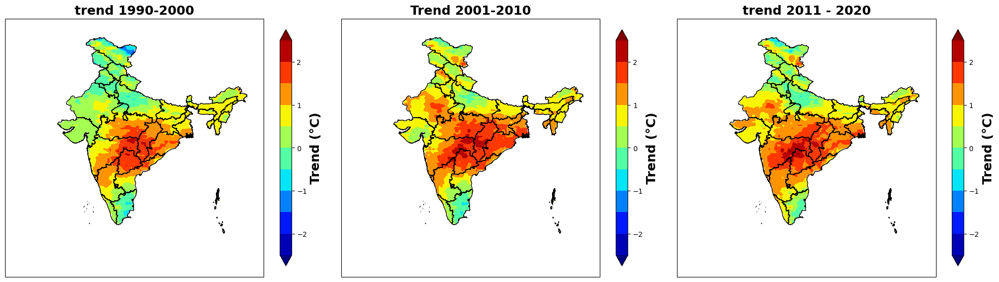

In [1]:
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.io import shapereader
from shapely.geometry import Point
from shapely.ops import unary_union

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the dataset
ds = xr.open_dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_daily.nc')
utci = ds['utci'] - 273.16

# Extract data for different time periods
utci_time5 = utci.sel(time=slice('1990-03-01', '1990-06-30')).mean(dim='time')
utci_time1 = utci.sel(time=slice('1991-03-01', '2000-06-30')).mean(dim='time')
utci_time2 = utci.sel(time=slice('2001-03-01', '2010-06-30')).mean(dim='time')
utci_time3 = utci.sel(time=slice('2011-03-01', '2020-06-30')).mean(dim='time')
utci_time4 = utci.sel(time=slice('1990-03-01', '2020-06-30')).mean(dim='time')

# Calculate the trend
trend1 = utci_time1 - utci_time5
trend2 = utci_time2 - utci_time5
trend3 = utci_time3 - utci_time5

# Extract latitude and longitude values
lats = ds['lat'].values
lons = ds['lon'].values

# Create a mask for the entire region
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0

# Apply the mask to the data
utci_time1_masked = utci_time1.where(mask == 1)
utci_time2_masked = utci_time2.where(mask == 1)
utci_time3_masked = utci_time3.where(mask == 1)
utci_time4_masked = utci_time4.where(mask == 1)
trend1_masked = trend1.where(mask == 1)
trend2_masked = trend2.where(mask == 1)
trend3_masked = trend3.where(mask == 1)

# Plot the data
mon = [trend1_masked, trend2_masked, trend3_masked]
titles = ['trend 1990-2000', 'Trend 2001-2010', 'trend 2011 - 2020']

# Define levels for contour plots
levels_list = [np.linspace(-2.5, 2.5, 11), np.linspace(-2.5, 2.5, 11), np.linspace(-2.5, 2.5, 11)]

fig, axes = plt.subplots(1, 3, figsize=(20, 10), subplot_kw={'projection': ccrs.PlateCarree()})
axes = axes.flatten()

for i, ax in enumerate(axes):
    mpl.rcParams['figure.facecolor'] = 'white'
    cf = ax.contourf(lons, lats, mon[i], levels=levels_list[i], cmap='jet', transform=ccrs.PlateCarree(), extend='both')
    ax.add_feature(india_feature)
    cbar = plt.colorbar(cf, ax=ax, orientation='vertical', shrink=0.48)
    cbar.set_label("Trend (°C)", fontsize=18, fontweight='bold')
    ax.set_title(titles[i], fontsize=18, fontweight='bold')

plt.tight_layout()
plt.show()

In [12]:
import netCDF4 as nc

# Load the NetCDF dataset
ncset = nc.Dataset(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_daily.nc')

# Check if 'utci' variable exists in the dataset
if 'utci' in ncset.variables:
    utci_var = ncset.variables['utci']

    # Spatial Resolution (assuming latitude and longitude dimensions)
    if 'lat' in utci_var.dimensions and 'lon' in utci_var.dimensions:
        lat = ncset.variables['lat'][:]
        lon = ncset.variables['lon'][:]
        spatial_resolution = (lat[1] - lat[0], lon[1] - lon[0])  # Assuming regular grid
        print("Spatial Resolution (degrees):", spatial_resolution)

    # Temporal Resolution (assuming time dimension)
    if 'time' in utci_var.dimensions:
        time = ncset.variables['time'][:]
        temporal_resolution = time[1] - time[0]  # Assuming regular time steps
        print("Temporal Resolution:", temporal_resolution, "days")

    # Check for resolution attribute if available
    if 'resolution' in utci_var.ncattrs():
        resolution_info = utci_var.getncattr('resolution')
        print("Resolution Information:", resolution_info)

else:
    print("Variable 'utci' does not exist in the dataset.")

# Close the dataset
ncset.close()


Spatial Resolution (degrees): (0.25, 0.25)
Temporal Resolution: 1.0 days


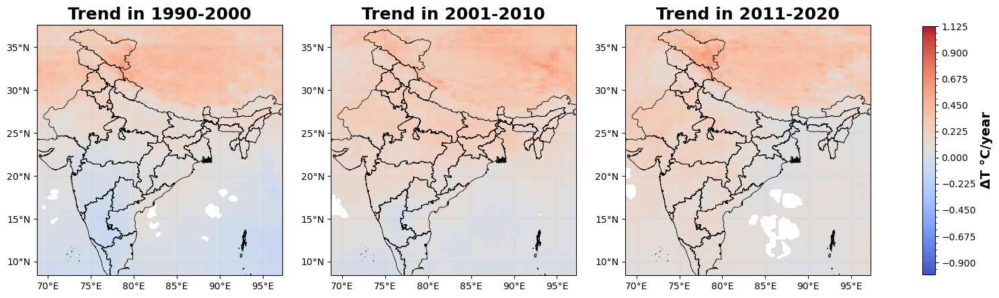

In [1]:
import numpy as np
from cartopy.io import shapereader as shpreader
from cartopy.feature import ShapelyFeature
from cartopy.io.shapereader import Reader
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from netCDF4 import Dataset as netcdf
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
from scipy.stats import ttest_1samp

crs = ccrs.PlateCarree()
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 8), constrained_layout=False,
                         subplot_kw={'projection': crs})

ncset = netcdf(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\utci_daily.nc')
lons = ncset['lon'][:]
lats = ncset['lat'][:]

sst1 = ncset['utci'][0:1342, :, :]
sst2 = ncset['utci'][1343:2562, :, :]
sst3 = ncset['utci'][2563:3782, :, :]

nctime1 = ncset['time'][0:1342]
nctime2 = ncset['time'][1343:2562]
nctime3 = ncset['time'][2563:3782]

t_unit = ncset['time'].units

try:
    t_cal = ncset['time'].calendar
except AttributeError:
    t_cal = "gregorian"

nt1, nlat1, nlon1 = sst1.shape
nt2, nlat2, nlon2 = sst2.shape
nt3, nlat3, nlon3 = sst3.shape

ngrd = nlon1 * nlat1

sst1_grd = sst1.reshape((nt1, ngrd), order='F')
sst2_grd = sst2.reshape((nt2, ngrd), order='F')
sst3_grd = sst3.reshape((nt3, ngrd), order='F')

x1 = np.linspace(1, nt1, nt1)
x2 = np.linspace(1, nt2, nt2)
x3 = np.linspace(1, nt3, nt3)

sst_rate1 = np.empty((ngrd, 1))
sst_rate1[:, :] = np.nan
sst_rate2 = np.empty((ngrd, 1))
sst_rate2[:, :] = np.nan
sst_rate3 = np.empty((ngrd, 1))
sst_rate3[:, :] = np.nan

significant_areas1 = []
significant_areas2 = []
significant_areas3 = []

for i in range(ngrd):
    y1 = sst1_grd[:, i]
    y2 = sst2_grd[:, i]
    y3 = sst3_grd[:, i]

    if not np.ma.is_masked(y1):
        z1 = np.polyfit(x1, y1, 1)
        slope1 = z1[0]
        p_value1 = ttest_1samp(y1 - slope1 * x1, 0).pvalue
        if p_value1 < 0.25:  # 90% confidence level
            sst_rate1[i, 0] = slope1 * 122.0  # Convert slope to annual change
            significant_areas1.append((i % nlon1, i // nlon1))
        else:
            sst_rate1[i, 0] = np.nan

    if not np.ma.is_masked(y2):
        z2 = np.polyfit(x2, y2, 1)
        slope2 = z2[0]
        p_value2 = ttest_1samp(y2 - slope2 * x2, 0).pvalue
        if p_value2 < 0.25:  # 90% confidence level
            sst_rate2[i, 0] = slope2 * 122.0  # Convert slope to annual change
            significant_areas2.append((i % nlon2, i // nlon2))
        else:
            sst_rate2[i, 0] = np.nan

    if not np.ma.is_masked(y3):
        z3 = np.polyfit(x3, y3, 1)
        slope3 = z3[0]
        p_value3 = ttest_1samp(y3 - slope3 * x3, 0).pvalue
        if p_value3 < 0.25:  # 90% confidence level
            sst_rate3[i, 0] = slope3 * 122.0  # Convert slope to annual change
            significant_areas3.append((i % nlon3, i // nlon3))
        else:
            sst_rate3[i, 0] = np.nan

sst_rate1 = sst_rate1.reshape((nlat1, nlon1), order='F')
sst_rate2 = sst_rate2.reshape((nlat2, nlon2), order='F')
sst_rate3 = sst_rate3.reshape((nlat3, nlon3), order='F')

sst_rate1 = sst_rate1.astype('float')
sst_rate2 = sst_rate2.astype('float')
sst_rate3 = sst_rate3.astype('float')

sst_rate1[sst_rate1 == 0] = np.nan
sst_rate2[sst_rate2 == 0] = np.nan
sst_rate3[sst_rate3 == 0] = np.nan

sstr = [sst_rate1, sst_rate2, sst_rate3]
titles = ['Trend in 1990-2000', 'Trend in 2001-2010', 'Trend in 2011-2020']

fname = shpreader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
shp = ShapelyFeature(Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp').geometries(),
                     ccrs.PlateCarree(), edgecolor='k', facecolor='none', linewidth=0.6)

levels = np.arange(-1, 1.15, 0.025)

for i, ax in enumerate(axes):
    ax.add_feature(shp)
    mp = ax.contourf(lons, lats, sstr[i], cmap='coolwarm', origin='lower', levels=levels, alpha=0.95)
    ax.set_title(titles[i], fontweight='bold', fontsize=18)

    lon_formatter = LongitudeFormatter(zero_direction_label=True)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.set_xticks(np.arange(min(lons), max(lons), 5, dtype=int))
    ax.set_yticks(np.arange(min(lats), max(lats), 5, dtype=int))
    ax.set_xlim([68.7, 97.25])
    ax.set_ylim([8.4, 37.6])

    # # Draw white circles around significant areas
    # if i == 0:
    #     significant_areas = significant_areas1
    # elif i == 1:
    #     significant_areas = significant_areas2
    # else:
    #     significant_areas = significant_areas3

    # for lon_idx, lat_idx in significant_areas:
    #     ax.plot(lons[lon_idx], lats[lat_idx], 'o', markerfacecolor='none', markeredgecolor='k', markersize=6, markeredgewidth=2)

    gl1 = ax.gridlines(draw_labels=False, edgecolor='white', alpha=0.1)
    gl1.top_labels = False
    gl1.right_labels = False

cbar = fig.colorbar(mp, ax=axes, shrink=0.6)
cbar.minorticks_on()
cbar.set_label('ΔT °C/year', fontsize=14, fontweight='bold')

plt.rcParams["font.weight"] = "bold"
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14
plt.rcParams['xtick.major.size'] = 8
plt.rcParams['ytick.major.size'] = 8
plt.rcParams['xtick.major.width'] = 4
plt.rcParams['ytick.major.width'] = 4
plt.rcParams["axes.linewidth"] = 4
plt.rcParams["patch.linewidth"] = 4

#plt.savefig("C:/Users/S Narayanaswami/OneDrive/Desktop/summer/sumr_work_fig/utci_trend.png", dpi=300)
plt.show()


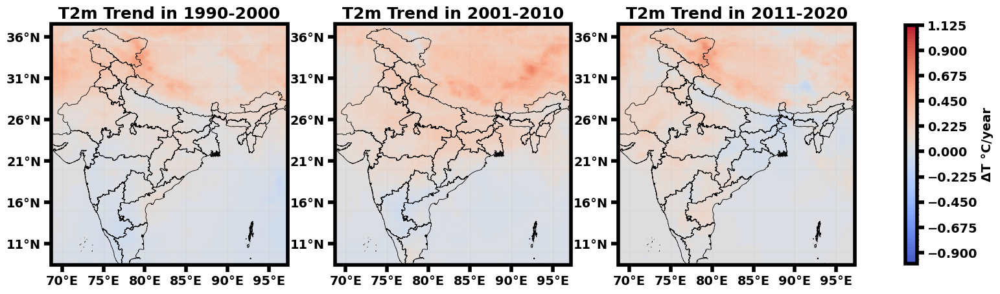

In [2]:
import numpy as np
from cartopy.io import shapereader as shpreader
from cartopy.feature import ShapelyFeature
from cartopy.io.shapereader import Reader
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from netCDF4 import Dataset as netcdf
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
from scipy.stats import ttest_1samp

crs = ccrs.PlateCarree()
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 8), constrained_layout=False,
                         subplot_kw={'projection': crs})

ncset = netcdf(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\temp_daily.nc')
lons = ncset['longitude'][:]
lats = ncset['latitude'][:]

sst1 = ncset['t2m'][0:1342, :, :]
sst2 = ncset['t2m'][1343:2562, :, :]
sst3 = ncset['t2m'][2563:3782, :, :]

nctime1 = ncset['time'][0:1342]
nctime2 = ncset['time'][1343:2562]
nctime3 = ncset['time'][2563:3782]

t_unit = ncset['time'].units

try:
    t_cal = ncset['time'].calendar
except AttributeError:
    t_cal = "gregorian"

nt1, nlat1, nlon1 = sst1.shape
nt2, nlat2, nlon2 = sst2.shape
nt3, nlat3, nlon3 = sst3.shape

ngrd = nlon1 * nlat1

sst1_grd = sst1.reshape((nt1, ngrd), order='F')
sst2_grd = sst2.reshape((nt2, ngrd), order='F')
sst3_grd = sst3.reshape((nt3, ngrd), order='F')

x1 = np.linspace(1, nt1, nt1)
x2 = np.linspace(1, nt2, nt2)
x3 = np.linspace(1, nt3, nt3)

sst_rate1 = np.empty((ngrd, 1))
sst_rate1[:, :] = np.nan
sst_rate2 = np.empty((ngrd, 1))
sst_rate2[:, :] = np.nan
sst_rate3 = np.empty((ngrd, 1))
sst_rate3[:, :] = np.nan

significant_areas1 = []
significant_areas2 = []
significant_areas3 = []

for i in range(ngrd):
    y1 = sst1_grd[:, i]
    y2 = sst2_grd[:, i]
    y3 = sst3_grd[:, i]

    if not np.ma.is_masked(y1):
        z1 = np.polyfit(x1, y1, 1)
        slope1 = z1[0]
        p_value1 = ttest_1samp(y1 - slope1 * x1, 0).pvalue
        if p_value1 < 0.25:  # 90% confidence level
            sst_rate1[i, 0] = slope1 * 122.0  # Convert slope to annual change
            significant_areas1.append((i % nlon1, i // nlon1))
        else:
            sst_rate1[i, 0] = np.nan

    if not np.ma.is_masked(y2):
        z2 = np.polyfit(x2, y2, 1)
        slope2 = z2[0]
        p_value2 = ttest_1samp(y2 - slope2 * x2, 0).pvalue
        if p_value2 < 0.25:  # 90% confidence level
            sst_rate2[i, 0] = slope2 * 122.0  # Convert slope to annual change
            significant_areas2.append((i % nlon2, i // nlon2))
        else:
            sst_rate2[i, 0] = np.nan

    if not np.ma.is_masked(y3):
        z3 = np.polyfit(x3, y3, 1)
        slope3 = z3[0]
        p_value3 = ttest_1samp(y3 - slope3 * x3, 0).pvalue
        if p_value3 < 0.25:  # 90% confidence level
            sst_rate3[i, 0] = slope3 * 122.0  # Convert slope to annual change
            significant_areas3.append((i % nlon3, i // nlon3))
        else:
            sst_rate3[i, 0] = np.nan

sst_rate1 = sst_rate1.reshape((nlat1, nlon1), order='F')
sst_rate2 = sst_rate2.reshape((nlat2, nlon2), order='F')
sst_rate3 = sst_rate3.reshape((nlat3, nlon3), order='F')

sst_rate1 = sst_rate1.astype('float')
sst_rate2 = sst_rate2.astype('float')
sst_rate3 = sst_rate3.astype('float')

sst_rate1[sst_rate1 == 0] = np.nan
sst_rate2[sst_rate2 == 0] = np.nan
sst_rate3[sst_rate3 == 0] = np.nan

sstr = [sst_rate1, sst_rate2, sst_rate3]
titles = ['T2m Trend in 1990-2000', 'T2m Trend in 2001-2010', 'T2m Trend in 2011-2020']

fname = shpreader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
shp = ShapelyFeature(Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp').geometries(),
                     ccrs.PlateCarree(), edgecolor='k', facecolor='none', linewidth=0.6)

levels = np.arange(-1, 1.15, 0.025)

for i, ax in enumerate(axes):
    ax.add_feature(shp)
    mp = ax.contourf(lons, lats, sstr[i], cmap='coolwarm', origin='lower', levels=levels, alpha=0.95)
    ax.set_title(titles[i], fontweight='bold', fontsize=18)

    lon_formatter = LongitudeFormatter(zero_direction_label=True)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.set_xticks(np.arange(min(lons), max(lons), 5, dtype=int))
    ax.set_yticks(np.arange(min(lats), max(lats), 5, dtype=int))
    ax.set_xlim([68.7, 97.25])
    ax.set_ylim([8.4, 37.6])

    # # Draw white circles around significant areas
    # if i == 0:
    #     significant_areas = significant_areas1
    # elif i == 1:
    #     significant_areas = significant_areas2
    # else:
    #     significant_areas = significant_areas3

    # for lon_idx, lat_idx in significant_areas:
    #     ax.plot(lons[lon_idx], lats[lat_idx], 'o', markerfacecolor='none', markeredgecolor='k', markersize=6, markeredgewidth=2)

    gl1 = ax.gridlines(draw_labels=False, edgecolor='white', alpha=0.1)
    gl1.top_labels = False
    gl1.right_labels = False

cbar = fig.colorbar(mp, ax=axes, shrink=0.6)
cbar.minorticks_on()
cbar.set_label('ΔT °C/year', fontsize=14, fontweight='bold')

plt.rcParams["font.weight"] = "bold"
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14
plt.rcParams['xtick.major.size'] = 8
plt.rcParams['ytick.major.size'] = 8
plt.rcParams['xtick.major.width'] = 4
plt.rcParams['ytick.major.width'] = 4
plt.rcParams["axes.linewidth"] = 4
plt.rcParams["patch.linewidth"] = 4

#plt.savefig("C:/Users/S Narayanaswami/OneDrive/Desktop/summer/sumr_work_fig/T2m_trend.png", dpi=300)
plt.show()


In [ ]:

import numpy as np
from cartopy.io import shapereader as shpreader
from cartopy.feature import ShapelyFeature
from cartopy.io.shapereader import Reader
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from netCDF4 import Dataset as netcdf
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
from scipy.stats import ttest_1samp

crs = ccrs.PlateCarree()
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(20, 8), constrained_layout=False,
                         subplot_kw={'projection': crs})

ncset = netcdf(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\heat_stress\temp_daily.nc')
lons = ncset['longitude'][:]
lats = ncset['latitude'][:]

sst1 = ncset['t2m'][0:1342, :, :]
sst2 = ncset['t2m'][1343:2562, :, :]
sst3 = ncset['t2m'][2563:3782, :, :]

nctime1 = ncset['time'][0:1342]
nctime2 = ncset['time'][1343:2562]
nctime3 = ncset['time'][2563:3782]

t_unit = ncset['time'].units

try:
    t_cal = ncset['time'].calendar
except AttributeError:
    t_cal = "gregorian"

nt1, nlat1, nlon1 = sst1.shape
nt2, nlat2, nlon2 = sst2.shape
nt3, nlat3, nlon3 = sst3.shape

ngrd = nlon1 * nlat1

sst1_grd = sst1.reshape((nt1, ngrd), order='F')
sst2_grd = sst2.reshape((nt2, ngrd), order='F')
sst3_grd = sst3.reshape((nt3, ngrd), order='F')

x1 = np.linspace(1, nt1, nt1)
x2 = np.linspace(1, nt2, nt2)
x3 = np.linspace(1, nt3, nt3)

sst_rate1 = np.empty((ngrd, 1))
sst_rate1[:, :] = np.nan
sst_rate2 = np.empty((ngrd, 1))
sst_rate2[:, :] = np.nan
sst_rate3 = np.empty((ngrd, 1))
sst_rate3[:, :] = np.nan

significant_areas1 = []
significant_areas2 = []
significant_areas3 = []

for i in range(ngrd):
    y1 = sst1_grd[:, i]
    y2 = sst2_grd[:, i]
    y3 = sst3_grd[:, i]

    if not np.ma.is_masked(y1):
        z1 = np.polyfit(x1, y1, 1)
        slope1 = z1[0]
        p_value1 = ttest_1samp(y1 - slope1 * x1, 0).pvalue
        if p_value1 < 0.25:  # 90% confidence level
            sst_rate1[i, 0] = slope1 * 122.0  # Convert slope to annual change
            significant_areas1.append((i % nlon1, i // nlon1))
        else:
            sst_rate1[i, 0] = np.nan

    if not np.ma.is_masked(y2):
        z2 = np.polyfit(x2, y2, 1)
        slope2 = z2[0]
        p_value2 = ttest_1samp(y2 - slope2 * x2, 0).pvalue
        if p_value2 < 0.25:  # 90% confidence level
            sst_rate2[i, 0] = slope2 * 122.0  # Convert slope to annual change
            significant_areas2.append((i % nlon2, i // nlon2))
        else:
            sst_rate2[i, 0] = np.nan

    if not np.ma.is_masked(y3):
        z3 = np.polyfit(x3, y3, 1)
        slope3 = z3[0]
        p_value3 = ttest_1samp(y3 - slope3 * x3, 0).pvalue
        if p_value3 < 0.25:  # 90% confidence level
            sst_rate3[i, 0] = slope3 * 122.0  # Convert slope to annual change
            significant_areas3.append((i % nlon3, i // nlon3))
        else:
            sst_rate3[i, 0] = np.nan

sst_rate1 = sst_rate1.reshape((nlat1, nlon1), order='F')
sst_rate2 = sst_rate2.reshape((nlat2, nlon2), order='F')
sst_rate3 = sst_rate3.reshape((nlat3, nlon3), order='F')

sst_rate1 = sst_rate1.astype('float')
sst_rate2 = sst_rate2.astype('float')
sst_rate3 = sst_rate3.astype('float')

sst_rate1[sst_rate1 == 0] = np.nan
sst_rate2[sst_rate2 == 0] = np.nan
sst_rate3[sst_rate3 == 0] = np.nan

sstr = [sst_rate1, sst_rate2, sst_rate3]
titles = ['T2m Trend in 1990-2000', 'T2m Trend in 2001-2010', 'T2m Trend in 2011-2020']

fname = shpreader.Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp')
shp = ShapelyFeature(Reader(r'C:\Users\S Narayanaswami\OneDrive\Desktop\summer\Admin2.shp').geometries(),
                     ccrs.PlateCarree(), edgecolor='k', facecolor='none', linewidth=0.6)

levels = np.arange(-1, 1.15, 0.025)

for i, ax in enumerate(axes):
    ax.add_feature(shp)
    mp = ax.contourf(lons, lats, sstr[i], cmap='coolwarm', origin='lower', levels=levels, alpha=0.95)
    ax.set_title(titles[i], fontweight='bold', fontsize=18)

    lon_formatter = LongitudeFormatter(zero_direction_label=True)
    lat_formatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(lon_formatter)
    ax.yaxis.set_major_formatter(lat_formatter)
    ax.set_xticks(np.arange(min(lons), max(lons), 5, dtype=int))
    ax.set_yticks(np.arange(min(lats), max(lats), 5, dtype=int))
    ax.set_xlim([68.7, 97.25])
    ax.set_ylim([8.4, 37.6])

    # # Draw white circles around significant areas
    # if i == 0:
    #     significant_areas = significant_areas1
    # elif i == 1:
    #     significant_areas = significant_areas2
    # else:
    #     significant_areas = significant_areas3

    # for lon_idx, lat_idx in significant_areas:
    #     ax.plot(lons[lon_idx], lats[lat_idx], 'o', markerfacecolor='none', markeredgecolor='k', markersize=6, markeredgewidth=2)

    gl1 = ax.gridlines(draw_labels=False, edgecolor='white', alpha=0.1)
    gl1.top_labels = False
    gl1.right_labels = False

cbar = fig.colorbar(mp, ax=axes, extend='both', shrink=0.56)
cbar.minorticks_on()
cbar.set_label('ΔT °C/year', fontsize=14, fontweight='bold')

plt.rcParams["font.weight"] = "bold"


In [1]:
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.gridspec as gridspace
ds = xr.open_dataset(r'C:\summer_project\heat_stress\trend_data90-20\trend_1990-2000.nc')
print(ds.info)

C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


<bound method Dataset.info of <xarray.Dataset>
Dimensions:  (time: 1, lon: 161, lat: 161)
Coordinates:
  * time     (time) datetime64[ns] 2000-06-30T11:30:00
  * lon      (lon) float64 60.0 60.25 60.5 60.75 61.0 ... 99.25 99.5 99.75 100.0
  * lat      (lat) float64 0.0 0.25 0.5 0.75 1.0 ... 39.0 39.25 39.5 39.75 40.0
Data variables:
    utci     (time, lat, lon) float64 ...
Attributes:
    CDI:          Climate Data Interface version 1.9.9rc1 (https://mpimet.mpg...
    Conventions:  CF-1.6
    history:      Tue Jul 16 21:26:57 2024: cdo trend utci_1990_2000.nc avg1....
    CDO:          Climate Data Operators version 1.9.9rc1 (https://mpimet.mpg...>


In [7]:
import xarray as xr
import numpy as np
import scapy as scp
import scp
import matplotlib.pyplot as plt
import sacpy.Map # need cartopy or you can just not import
import cartopy.crs as ccrs
# load sst
ds = xr.open_dataset(r'C:\summer_project\heat_stress\utci_daily.nc')
data = xr.open_dataset(r'C:\summer_project\heat_stress\rh_daily.nc')
utci = ds['utci']
rh = data['rh']
print(utci, rh)

ModuleNotFoundError: No module named 'scp'

In [4]:
sst = scp.load_sst()['utci']

AttributeError: module 'scapy' has no attribute 'load_sst'

In [ ]:

sst = scp.load_sst()['utci']
# get ssta (method=1, Remove linear trend;method=0, Minus multi-year average)
ssta = scp.get_anom(sst,method=1)
# calculate Nino3.4
Nino34 = ssta.loc[:,-5:5,190:240].mean(axis=(1,2))
# regression
linreg = scp.LinReg(Nino34,ssta)
# plot
fig = plt.figure(figsize=[7, 3])
ax = plt.axes(projection=ccrs.PlateCarree(central_longitude=180))
lon ,lat = ssta.lon , ssta.lat
# shading
m = ax.scontourf(lon,lat,linreg.corr)
# significant plot
n = ax.sig_plot(lon,lat,linreg.p_value,color="k",marker="..")
# initialize map
ax.init_map(stepx=50, ysmall=2.5)
# colorbar
plt.colorbar(m)
plt.show()

In [8]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
from cartopy.io import shapereader
from cartopy.feature import ShapelyFeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from scipy import stats






In [9]:

# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Open datasets
trend_ds = xr.open_dataset(r'C:\summer_project\heat_stress\utci_daily.nc')
timeseries_ds = xr.open_dataset(r'C:\summer_project\heat_stress\rh_daily.nc')

# Select data
trend = trend_ds['utci'].squeeze().sel(lon=slice(68.5, 97.25), lat=slice(8.3, 37.9))
timeseries = timeseries_ds['rh'].squeeze().sel(longitude=slice(68.5, 97.25), latitude=slice(8.3, 37.9))
lat = trend_ds['lat'].sel(lat=slice(8.3, 37.9)).values
lon = trend_ds['lon'].sel(lon=slice(68.5, 97.25)).values


In [10]:
# Calculate p-values
years = timeseries_ds['time'].values
years_numeric = np.array([int(str(year).split('-')[0]) for year in years])
p_values = np.zeros(trend.shape)
for i in range(len(lat)):
    for j in range(len(lon)):
        slope, intercept, r_value, p_value, std_err = stats.linregress(years_numeric, timeseries[:, i, j])
        p_values[i, j] = p_value

# Create a mask for the entire region for climatology_decades
mask = np.zeros((len(lat), len(lon)), dtype=int)
for i, lat_val in enumerate(lat):
    for j, lon_val in enumerate(lon):
        if is_inside_india(lat_val, lon_val, india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0

In [1]:
significance_mask = p_values < 0.05  # Significant at alpha = 0.05
# Assuming filt is defined somewhere in your script
filt = np.ones_like(significance_mask, dtype=bool)  # Example filt, adjust as per your data and needs
significance_mask = significance_mask * filt  # Applying filt to significance mask
significance_mask = significance_mask[0, :, :]

utci = trend * filt
utci = utci.astype('float')
utci = utci[0, :, :].copy().values
utci[utci == 0] = np.nan
utci = utci-273.16
# Plotting parameters
levels = np.arange(16, 36, 2)
fig = plt.figure(figsize=(10, 8))
gs = gridspec.GridSpec(1, 1, width_ratios=[1])

# Plotting utci over India during the 1990-2020
ax5 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
ax5.add_feature(india_feature)
pcm5 = ax5.contourf(lon, lat, utci, transform=ccrs.PlateCarree(), extend='both',levels=levels, cmap='jet')
pcm = ax5.contourf(lon, lat, significance_mask, levels=[0.5, 1], cmap='jet', hatches=['....'], alpha=0.5)
ax5.set_xticklabels([])

ax5.set_title('(a) clim utci & RH linREGres signf', fontsize=10, fontweight='bold')
ax5.set_ylabel('Latitude', fontweight='bold')
ax5.set_xlabel('Longitude', fontweight='bold')
ax5.set_xticks(np.arange(68.5, 97.25, 5))
ax5.set_yticks(np.arange(8.3, 37.8, 5))

cbar4 = fig.colorbar(pcm5, ax=ax5, orientation='vertical', shrink=0.632)
cbar4.set_label('utci (°C)')
cbar4_ax = cbar4.ax
cbar4_ax.set_position([0.77, 0.2, 0.03, 0.6])  # Adjust the position and size of the colorbar
for ax in [ax5]:
    ax.set_xticks(np.arange(68.5, 97.25, 5), crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)))
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)))

plt.show()

NameError: name 'p_values' is not defined

In [ ]:
# Define the shapefile for India
india_shapefile = shapereader.Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Open datasets
trend_ds = xr.open_dataset(r'C:\summer_project\heat_stress\utci_daily.nc')
timeseries_ds = xr.open_dataset(r'C:\summer_project\heat_stress\temp_daily.nc')

# Select data
trend = trend_ds['utci'].squeeze().sel(lon=slice(68.5, 97.25), lat=slice(8.3, 37.9))
timeseries = timeseries_ds['t2m'].squeeze().sel(longitude=slice(68.5, 97.25), latitude=slice(8.3, 37.9))
lat = trend_ds['lat'].sel(lat=slice(8.3, 37.9)).values
lon = trend_ds['lon'].sel(lon=slice(68.5, 97.25)).values
# Calculate p-values
years = timeseries_ds['time'].values
years_numeric = np.array([int(str(year).split('-')[0]) for year in years])
p_values = np.zeros(trend.shape)
for i in range(len(lat)):
    for j in range(len(lon)):
        slope, intercept, r_value, p_value, std_err = stats.linregress(years_numeric, timeseries[:, i, j])
        p_values[i, j] = p_value

# Create a mask for the entire region for climatology_decades
mask = np.zeros((len(lat), len(lon)), dtype=int)
for i, lat_val in enumerate(lat):
    for j, lon_val in enumerate(lon):
        if is_inside_india(lat_val, lon_val, india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0
            
significance_mask = p_values < 0.10  # Significant at alpha = 0.05
# Assuming filt is defined somewhere in your script
filt = np.ones_like(significance_mask, dtype=bool)  # Example filt, adjust as per your data and needs
significance_mask = significance_mask * filt  # Applying filt to significance mask
significance_mask = significance_mask[0, :, :]

utci = trend * filt
utci = utci.astype('float')
utci = utci[0, :, :].copy().values
utci[utci == 0] = np.nan
utci = utci-273.16
# Plotting parameters
levels = np.arange(16, 36, 2)
fig = plt.figure(figsize=(10, 8))
gs = gridspec.GridSpec(1, 1, width_ratios=[1])

# Plotting utci over India during the 1990-2020
ax5 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
ax5.add_feature(india_feature)
pcm5 = ax5.contourf(lon, lat, utci, transform=ccrs.PlateCarree(), extend='both',levels=levels, cmap='jet')
pcm = ax5.contourf(lon, lat, significance_mask, levels=[0.5, 1], cmap='jet', hatches=['....'], alpha=0.5)
ax5.set_xticklabels([])

ax5.set_title('(a) clim utci & T2m linREGres signf', fontsize=10, fontweight='bold')
ax5.set_ylabel('Latitude', fontweight='bold')
ax5.set_xlabel('Longitude', fontweight='bold')
ax5.set_xticks(np.arange(68.5, 97.25, 5))
ax5.set_yticks(np.arange(8.3, 37.8, 5))

cbar4 = fig.colorbar(pcm5, ax=ax5, orientation='vertical', shrink=0.632)
cbar4.set_label('utci (°C)')
cbar4_ax = cbar4.ax
cbar4_ax.set_position([0.77, 0.2, 0.03, 0.6])  # Adjust the position and size of the colorbar
for ax in [ax5]:
    ax.set_xticks(np.arange(68.5, 97.25, 5), crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)))
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)))

plt.show()

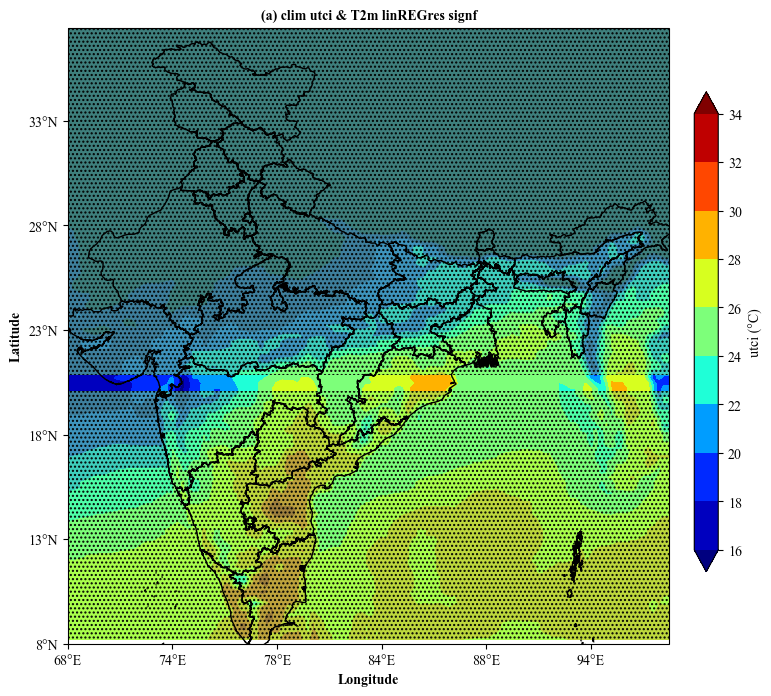

In [26]:
significance_mask = p_values < 0.01  # Significant at alpha = 0.05
# Assuming filt is defined somewhere in your script
filt = np.ones_like(significance_mask, dtype=bool)  # Example filt, adjust as per your data and needs
significance_mask = significance_mask * filt  # Applying filt to significance mask
significance_mask = significance_mask[0, :, :]

utci = trend * filt
utci = utci.astype('float')
utci = utci[0, :, :].copy().values
utci[utci == 0] = np.nan
utci = utci-273.16
# Plotting parameters
levels = np.arange(16, 36, 2)
fig = plt.figure(figsize=(10, 8))
gs = gridspec.GridSpec(1, 1, width_ratios=[1])

# Plotting utci over India during the 1990-2020
ax5 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
ax5.add_feature(india_feature)
pcm5 = ax5.contourf(lon, lat, utci, transform=ccrs.PlateCarree(), extend='both',levels=levels, cmap='jet')
pcm = ax5.contourf(lon, lat, significance_mask, levels=[0.5, 1], cmap='jet', hatches=['....'], alpha=0.5)
ax5.set_xticklabels([])

ax5.set_title('(a) clim utci & T2m linREGres signf', fontsize=10, fontweight='bold')
ax5.set_ylabel('Latitude', fontweight='bold')
ax5.set_xlabel('Longitude', fontweight='bold')
ax5.set_xticks(np.arange(68.5, 97.25, 5))
ax5.set_yticks(np.arange(8.3, 37.8, 5))

cbar4 = fig.colorbar(pcm5, ax=ax5, orientation='vertical', shrink=0.632)
cbar4.set_label('utci (°C)')
cbar4_ax = cbar4.ax
cbar4_ax.set_position([0.77, 0.2, 0.03, 0.6])  # Adjust the position and size of the colorbar
for ax in [ax5]:
    ax.set_xticks(np.arange(68.5, 97.25, 5), crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)))
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)))

plt.show()

AttributeError: 'GeoAxes' object has no attribute 'set_xaxis_ticks'

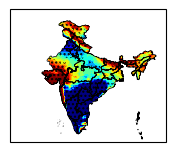

In [2]:



import xarray as xr
import numpy as np
from scipy.stats import linregress
import matplotlib.pyplot as plt
import xarray as xr
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import pandas as pd
import geopandas as gpd
import pickle
from shapely.geometry import Point
from cartopy.io import shapereader
from shapely.geometry import Point, Polygon
from shapely.ops import unary_union
from cartopy.io import shapereader as shpreader
from cartopy.feature import ShapelyFeature
from cartopy.io.shapereader import Reader
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from netCDF4 import Dataset as netcdf
from scipy.stats import ttest_1samp
from scipy import stats

from matplotlib import ticker
from scipy.signal import detrend

# Apply the mask to the data
india_shapefile = shapereader.Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
shp = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')
# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)


ds1 = xr.open_dataset(r'C:\summer_project\heat_stress\rh_daily.nc')
ds2 = xr.open_dataset(r'C:\summer_project\heat_stress\utci_daily.nc')
ds1=ds1.sel(longitude=slice(60, 100),latitude=slice(6, 40))
ds2=ds2.sel(lon=slice(60, 100),lat=slice(6, 40))

var1 = ds2['utci'].isel(time=slice(0,122))
var2 = ds1['rh'].isel(time=slice(0,122))
lats = ds2['lat'].values
lons = ds2['lon'].values
slope = np.zeros((len(var1.lat), len(var1.lon)))
intercept = np.zeros((len(var1.lat), len(var1.lon)))
r_value = np.zeros((len(var1.lat), len(var1.lon)))
p_value = np.zeros((len(var1.lat), len(var1.lon)))
std_err = np.zeros((len(var1.lat), len(var1.lon)))

mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1
        #else:
            #mask[i, j] = 0


for i in range(len(lats)):
    for j in range(len(lons)):
        slope[i, j], intercept[i, j], r_value[i, j], p_value[i, j], std_err[i, j] = linregress(
            var1[:, i, j], var2[:, i, j])


p_value[p_value>0.05]=np.nan
p_value[~(np.isnan(p_value))]=1



#k = slope.where(mask == 1)
#l = p_value.where(mask == 1)
slope = np.where(mask == 1, slope, np.nan)
p_value = np.where(mask == 1, p_value, np.nan)

fig=plt.figure(figsize=(10, 10))
gs = fig.add_gridspec(1, 1)


ax=fig.add_subplot(5,1,1,projection=ccrs.PlateCarree())
# ax=add_all(ax)
ax.add_feature(shp, linewidth=0.5)
plt.contourf(lons,lats, slope,cmap='jet',levels=np.arange(-1.2,1.3,0.2),extend='both')
plt.contourf(lons,lats,p_value,hatches=['....'],alpha=0)
ax.set_xaxis_ticks(60, 100, 5)
ax.set_yaxis_ticks(5, 40.1, 5)
ax.set_xlabel('longitude')
ax.set_ylabel('latitude')

# plt.xlim(60, 100)
plt.show()


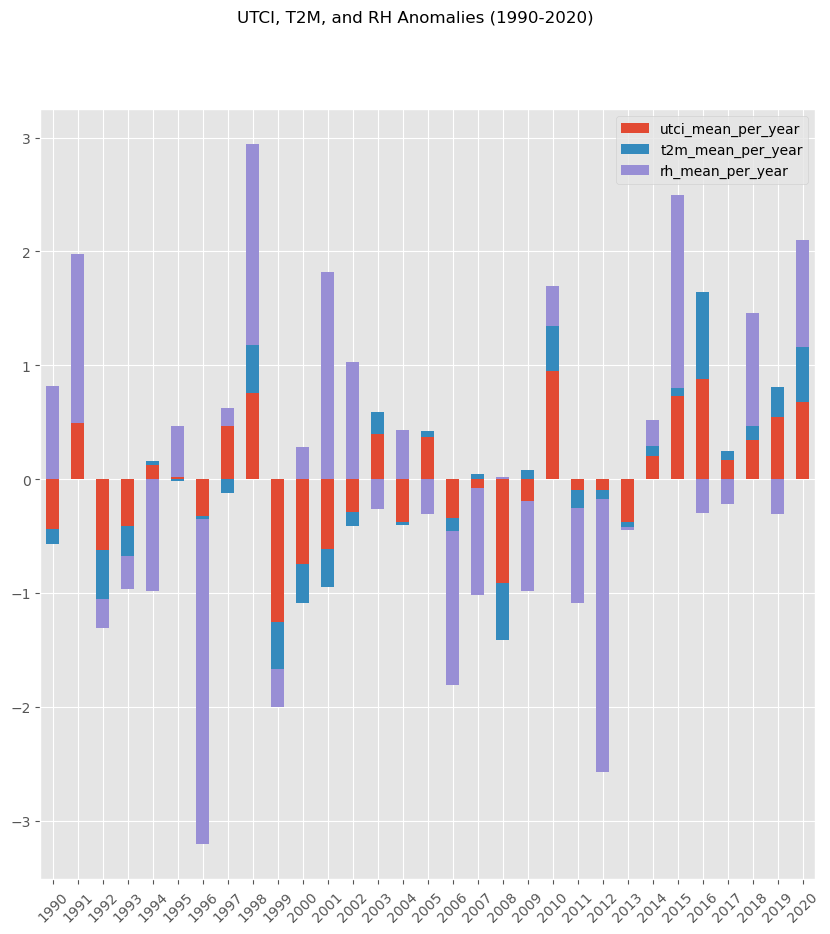

In [81]:
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
import datetime as dt
# Load relative humidity (rh) data
data = xr.open_dataset(r'C:\summer_project\heat_stress\rh_daily.nc')
rh = data['rh'].sel(longitude=slice(68.7, 97.25), latitude=slice(8.4, 37.6))[:, 0, 0]
rh = rh.values

# Load UTCI data
data1 = xr.open_dataset(r'C:\summer_project\heat_stress\utci_daily.nc')
utci = data1['utci'].sel(lon=slice(68.7, 97.25), lat=slice(8.4, 37.6))[:, 0, 0]
utci = utci.values

# Load temperature data
data2 = xr.open_dataset(r'C:\summer_project\heat_stress\temp_daily.nc')
t2m = data2['t2m'].sel(longitude=slice(68.7, 97.25), latitude=slice(8.4, 37.6))[:, 0, 0]
t2m = t2m.values

# Constants
n_days = 122
n_years = 31
years = np.arange(1990, 2021, 1)

# Reshape data to separate each 122-day cycle
rh_reshaped = rh.reshape((n_years, n_days))
utci_reshaped = utci.reshape((n_years, n_days))
t2m_reshaped = t2m.reshape((n_years, n_days))

# Calculate daily mean across all years
rh_mean_daily = rh_reshaped.mean(axis=0)
utci_mean_daily = utci_reshaped.mean(axis=0)
t2m_mean_daily = t2m_reshaped.mean(axis=0)

# Calculate anomalies
rh_anom = rh_reshaped - rh_mean_daily
utci_anom = utci_reshaped - utci_mean_daily
t2m_anom = t2m_reshaped - t2m_mean_daily

# Calculate mean per row (year) for plotting
rh_mean_per_year = np.mean(rh_anom, axis=1)
utci_mean_per_year = np.mean(utci_anom, axis=1)
t2m_mean_per_year = np.mean(t2m_anom, axis=1)

barWidth = 0.25

# # Plotting
# fig, ax1 = plt.subplots(1, 1, figsize=(12, 6))

# # Bar plots for UTCI and T2M
# bars1 = ax1.bar(years, utci_mean_per_year, color='b', width=barWidth, label='UTCI', edgecolor='grey')
# bars2 = ax1.bar(years, t2m_mean_per_year, color='r', width=barWidth, label='T2M', edgecolor='grey')

# # Set x and y-axis ticks
# ax1.set_xticks(years)
# ax1.set_yticks(np.arange(np.floor(min(utci_mean_per_year.min(), t2m_mean_per_year.min())),
#                           np.ceil(max(utci_mean_per_year.max(), t2m_mean_per_year.max())) + 1, 1))
# ax1.set_ylabel('UTCI/T2M Anomalies (°C)')
# ax1.set_xlabel('Year')
# ax1.tick_params(axis='x', rotation=90)

# # Add a second y-axis for RH
# ax2 = ax1.twinx()
# bars3 = ax2.bar(years, rh_mean_per_year, color='g', width=barWidth, label='RH', edgecolor='grey')
# ax2.set_ylabel('Mean RH Anomalies (%)')
# ax2.set_yticks(np.arange(np.floor(rh_mean_per_year.min()), np.ceil(rh_mean_per_year.max()) + 1, 1))

# # Add legends
# lines1, labels1 = ax1.get_legend_handles_labels()
# lines2, labels2 = ax2.get_legend_handles_labels()
# ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper left')

# # Title
# plt.suptitle('UTCI, T2M, and RH Anomalies (1990-2020)', fontsize=18)

# plt.show()
# Use the 'ggplot' style for the plot
#plt.style.use('ggplot')

# Generate a date range starting from January 1, 1990, with a period of 31 years, and yearly frequency
datelist = pd.date_range(dt.datetime(1990, 1, 1), periods=31, freq='Y').tolist()

# Define the series names for the bar plot
bar_series = ['utci_mean_per_year', 't2m_mean_per_year', 'rh_mean_per_year']

# Generate random values for the DataFrame
values = np.random.randn(31, 3)
values[:,0]=utci_mean_per_year
values[:,1]=t2m_mean_per_year
values[:,2]=rh_mean_per_year

# Create a DataFrame with the generated values, indexed by the date list and columns named by the bar series
df = pd.DataFrame(values, index=datelist, columns=bar_series)
# Create a figure and a subplot
fig = plt.figure(figsize=(10, 10))
ax1 = fig.add_subplot(111)

# Plot the DataFrame as a stacked bar plot
df.plot.bar(ax=ax1, stacked=True)
plt.suptitle('UTCI, T2M, and RH Anomalies (1990-2020)', fontsize=12)

# Customize the x-axis ticks
years = np.arange(1990, 2021, 1)
ax1.set_xticks(np.arange(len(years)))
ax1.set_xticklabels(years, rotation=45)

# Display the plot
#plt.tight_layout()
plt.show()


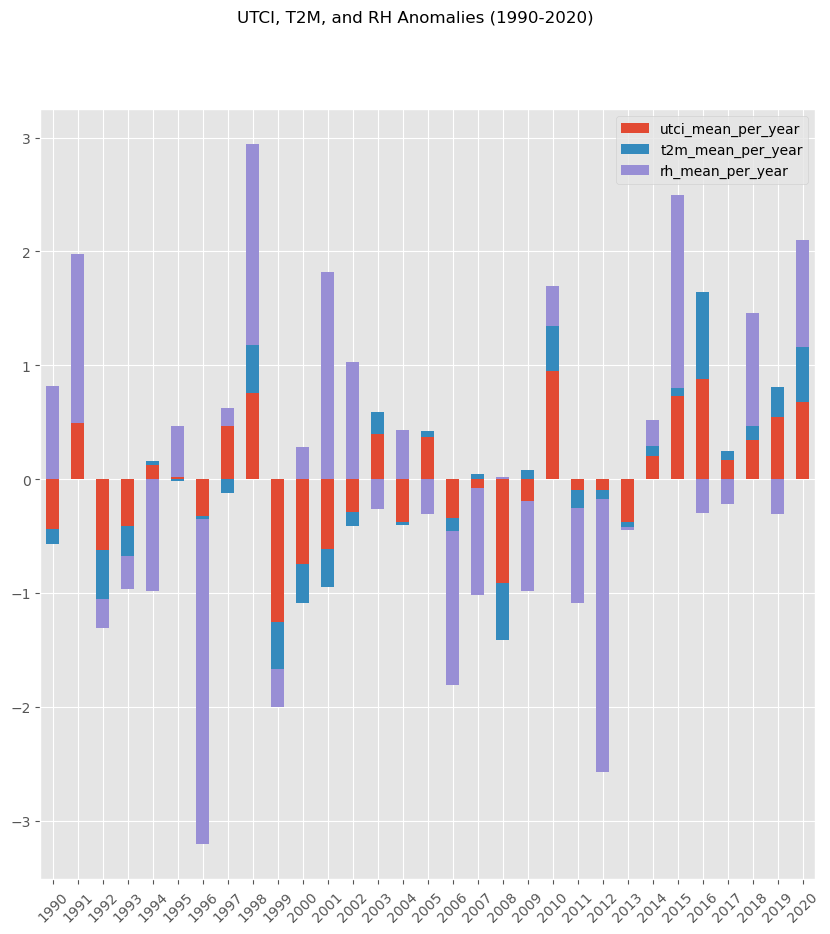

In [7]:
import matplotlib.dates as mdates

import datetime as dt
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd



In [98]:
import xarray as xr
ds = xr.open_dataset(r'C:\summer_project\heat_stress\ws_daily.nc')
print(ds.variables)

Frozen({'time': <xarray.IndexVariable 'time' (time: 3782)>
array(['1990-03-01T11:00:00.000000000', '1990-03-02T11:00:00.000000000',
       '1990-03-03T11:00:00.000000000', ..., '2020-06-28T11:00:00.000000000',
       '2020-06-29T11:00:00.000000000', '2020-06-30T11:00:00.000000000'],
      dtype='datetime64[ns]')
Attributes:
    standard_name:  time
    long_name:      time
    bounds:         time_bnds
    axis:           T, 'time_bnds': <xarray.Variable (time: 3782, bnds: 2)>
[7564 values with dtype=datetime64[ns]], 'longitude': <xarray.IndexVariable 'longitude' (longitude: 161)>
array([ 60.  ,  60.25,  60.5 ,  60.75,  61.  ,  61.25,  61.5 ,  61.75,  62.  ,
        62.25,  62.5 ,  62.75,  63.  ,  63.25,  63.5 ,  63.75,  64.  ,  64.25,
        64.5 ,  64.75,  65.  ,  65.25,  65.5 ,  65.75,  66.  ,  66.25,  66.5 ,
        66.75,  67.  ,  67.25,  67.5 ,  67.75,  68.  ,  68.25,  68.5 ,  68.75,
        69.  ,  69.25,  69.5 ,  69.75,  70.  ,  70.25,  70.5 ,  70.75,  71.  ,
        71.25,  7

In [16]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import Point
from shapely.ops import unary_union
from cartopy.io.shapereader import Reader
from cartopy.feature import ShapelyFeature
from netCDF4 import Dataset as netcdf
from scipy.stats import ttest_1samp
import pandas as pd
# Define the shapefile for India
india_shapefile = Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')
# Define a function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)
# Load the dataset
d1 = xr.open_dataset(r'C:\summer_project\heat_stress\utci_daily.nc')

# Extract variables from the dataset
utci = d1['utci'][:] - 273.16  # Convert temperature from Kelvin to Celsius
lons = d1['lon'].values
lats = d1['lat'].values

# Divide data into different time periods
sst1 = d1['utci'][0:3782, :, :]
sst2 = d1['utci'][0:1342, :, :]
sst3 = d1['utci'][1343:2562, :, :]
sst4 = d1['utci'][2563:3782, :, :]

nctime1 = d1['time'][0:3782]
nctime2 = d1['time'][0:1342]
nctime3 = d1['time'][1343:2562]
nctime4 = d1['time'][2563:3782]

# Extract dimensions
nt1, nlat1, nlon1 = sst1.shape
nt2, nlat2, nlon2 = sst2.shape
nt3, nlat3, nlon3 = sst3.shape
nt4, nlat4, nlon4 = sst4.shape

ngrd = nlon1 * nlat1  # Total number of grid points

# Reshape the data for linear regression
sst1_values = sst1.values.reshape((nt1, ngrd), order='F')
sst2_values = sst2.values.reshape((nt2, ngrd), order='F')
sst3_values = sst3.values.reshape((nt3, ngrd), order='F')
sst4_values = sst4.values.reshape((nt4, ngrd), order='F')

x1 = np.linspace(1, nt1, nt1)
x2 = np.linspace(1, nt2, nt2)
x3 = np.linspace(1, nt3, nt3)
x4 = np.linspace(1, nt4, nt4)

# Arrays to store the calculated slopes
sst_rate1 = np.empty((ngrd, 1))
sst_rate1[:, :] = np.nan
sst_rate2 = np.empty((ngrd, 1))
sst_rate2[:, :] = np.nan
sst_rate3 = np.empty((ngrd, 1))
sst_rate3[:, :] = np.nan
sst_rate4 = np.empty((ngrd, 1))
sst_rate4[:, :] = np.nan

In [4]:
if np.any(np.isnan(x1)) or np.any(np.isnan(y1)) or np.any(np.isinf(x1)) or np.any(np.isinf(y1)):
    print("Data contains NaN or Infinite values.")


Data contains NaN or Infinite values.


In [8]:
if np.ptp(x1) < 1e-10 or np.ptp(y1) < 1e-10:  # ptp: peak to peak (range)
    print("Data range is too small, leading to degeneracy.")


In [ ]:
 in this line if you get a z1 = np.polyfit(x1, y1, 1)  this type of error  raise LinAlgError("SVD did not converge in Linear Least Squares")

LinAlgError: SVD did not converge in Linear Least Squares    can try this type of error 

In [17]:
significant_areas1 = []
significant_areas2 = []
significant_areas3 = []
significant_areas4 = []

# Perform linear regression and calculate annual change (trend)
for i in range(ngrd):
    y1 = sst1_values[:, i]
    y2 = sst2_values[:, i]
    y3 = sst3_values[:, i]
    y4 = sst4_values[:, i]
    
    # Clean and handle NaN/Inf values for y1
    valid_mask1 = ~np.isnan(y1) & ~np.isinf(y1) & ~np.isnan(x1) & ~np.isinf(x1)
    x1_clean = x1[valid_mask1]
    y1_clean = y1[valid_mask1]

    if len(x1_clean) > 1 and not np.ma.is_masked(y1_clean):
        z1 = np.polyfit(x1_clean, y1_clean, 1)
        slope1 = z1[0]
        p_value1 = ttest_1samp(y1_clean - slope1 * x1_clean, 0).pvalue
        if p_value1 < 0.25:  # 90% confidence level
            sst_rate1[i, 0] = slope1 * 122.0  # Convert slope to annual change
            significant_areas1.append((i % nlon1, i // nlon1))
        else:
            sst_rate1[i, 0] = np.nan

    # Clean and handle NaN/Inf values for y2
    valid_mask2 = ~np.isnan(y2) & ~np.isinf(y2) & ~np.isnan(x2) & ~np.isinf(x2)
    x2_clean = x2[valid_mask2]
    y2_clean = y2[valid_mask2]

    if len(x2_clean) > 1 and not np.ma.is_masked(y2_clean):
        z2 = np.polyfit(x2_clean, y2_clean, 1)
        slope2 = z2[0]
        p_value2 = ttest_1samp(y2_clean - slope2 * x2_clean, 0).pvalue
        if p_value2 < 0.25:  # 90% confidence level
            sst_rate2[i, 0] = slope2 * 122.0  # Convert slope to annual change
            significant_areas2.append((i % nlon2, i // nlon2))
        else:
            sst_rate2[i, 0] = np.nan

    # Clean and handle NaN/Inf values for y3
    valid_mask3 = ~np.isnan(y3) & ~np.isinf(y3) & ~np.isnan(x3) & ~np.isinf(x3)
    x3_clean = x3[valid_mask3]
    y3_clean = y3[valid_mask3]

    if len(x3_clean) > 1 and not np.ma.is_masked(y3_clean):
        z3 = np.polyfit(x3_clean, y3_clean, 1)
        slope3 = z3[0]
        p_value3 = ttest_1samp(y3_clean - slope3 * x3_clean, 0).pvalue
        if p_value3 < 0.25:  # 90% confidence level
            sst_rate3[i, 0] = slope3 * 122.0  # Convert slope to annual change
            significant_areas3.append((i % nlon3, i // nlon3))
        else:
            sst_rate3[i, 0] = np.nan
    
    # Clean and handle NaN/Inf values for y4
    valid_mask4 = ~np.isnan(y4) & ~np.isinf(y4) & ~np.isnan(x4) & ~np.isinf(x4)
    x4_clean = x4[valid_mask4]
    y4_clean = y4[valid_mask4]

    if len(x4_clean) > 1 and not np.ma.is_masked(y4_clean):
        z4 = np.polyfit(x4_clean, y4_clean, 1)
        slope4 = z4[0]
        p_value4 = ttest_1samp(y4_clean - slope4 * x4_clean, 0).pvalue
        if p_value4 < 0.25:  # 90% confidence level
            sst_rate4[i, 0] = slope4 * 122.0  # Convert slope to annual change
            significant_areas4.append((i % nlon4, i // nlon3))
        else:
            sst_rate4[i, 0] = np.nan

# Reshape the results to grid shape
sst_rate1 = sst_rate1.reshape((nlat1, nlon1), order='F')
sst_rate2 = sst_rate2.reshape((nlat2, nlon2), order='F')
sst_rate3 = sst_rate3.reshape((nlat3, nlon3), order='F')
sst_rate4 = sst_rate4.reshape((nlat4, nlon4), order='F')


In [10]:
# Create a mask for India region
mask = np.zeros((len(lats), len(lons)), dtype=int)

for i in range(len(lats)):
    for j in range(len(lons)):
        if is_inside_india(lats[i], lons[j], india_polygon):
            mask[i, j] = 1
        else:
            mask[i, j] = 0  # PlateCarree projection


In [12]:
# Define the shapefile for India
india_shapefile = Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')
# Define a function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

In [19]:
# Apply mask to temperature rate arrays
#sst_rate1 = sst_rate1.where(mask == 1, np.nan)

sst_rate1 = np.where(mask == 1, sst_rate1, np.nan)
sst_rate2 = np.where(mask == 1, sst_rate2, np.nan)
sst_rate3 = np.where(mask == 1, sst_rate3, np.nan)
sst_rate4 = np.where(mask == 1, sst_rate4, np.nan)


C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)


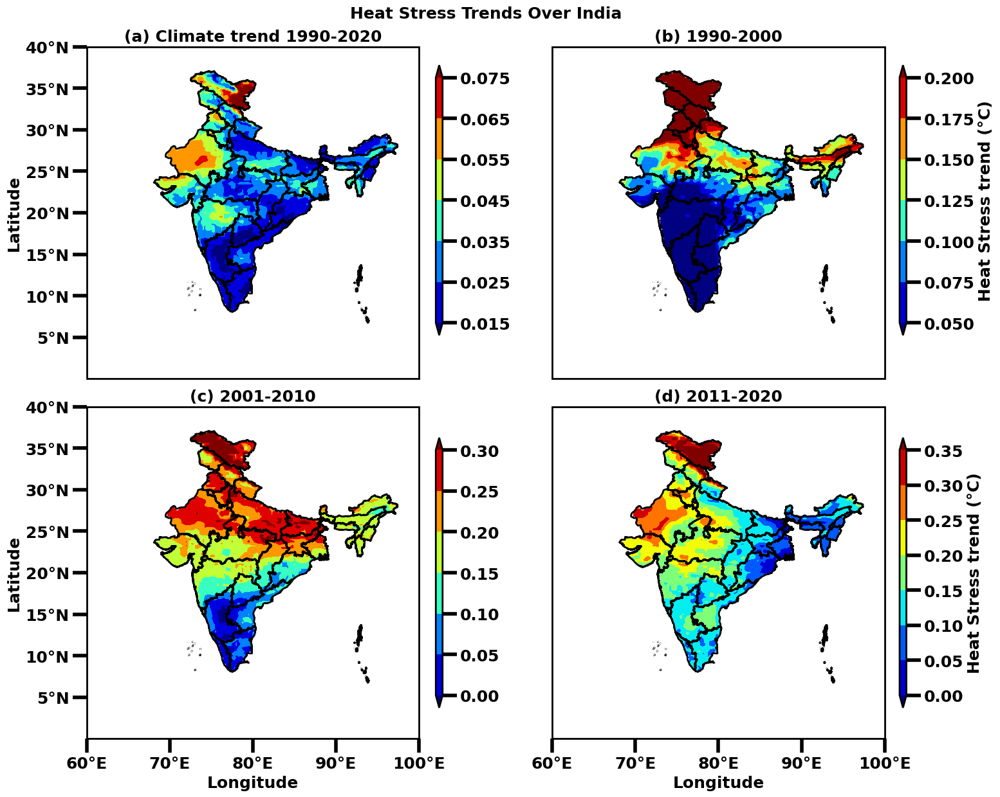

In [21]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

# Assuming `lons`, `lats`, `sst_rate1`, `sst_rate2`, `sst_rate3`, `sst_rate4`, and `india_feature` are defined
levels1= np.arange(0.015, 0.0751, 0.01)
levels2= np.arange(0.05, 0.21, 0.025)
levels3= np.arange(0, 0.31, 0.05)
levels4= np.arange(0, 0.351, 0.05)
# Create a gridspec
fig = plt.figure(figsize=(15.5, 14))
gs = fig.add_gridspec(2, 2, wspace=0.4, hspace=0)

# Plotting sst_rate1 (1990-2020)
ax5 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
ax5.add_feature(india_feature)
pcm5 = ax5.contourf(lons, lats, sst_rate1, transform=ccrs.PlateCarree(), levels=levels1, cmap='jet', extend='both', shrink=0.36)
ax5.set_title('(a) Climate trend 1990-2020', fontsize=18, fontweight='bold')
#ax5.set_xlabel('Longitude', fontweight='bold')
ax5.set_ylabel('Latitude', fontweight='bold')
#ax5.set_xticks(np.arange(60, 100, 10))
ax5.set_yticks(np.arange(5, 40.1, 5))
ax5.set_facecolor('white')

# Plotting sst_rate2 (1990-2000)
ax6 = fig.add_subplot(gs[0, 1], projection=ccrs.PlateCarree())
ax6.add_feature(india_feature)
pcm6 = ax6.contourf(lons, lats, sst_rate2, transform=ccrs.PlateCarree(), levels=levels2, cmap='jet', extend='both', shrink=0.36)
ax6.set_title('(b) 1990-2000', fontsize=18, fontweight='bold')
#ax6.set_xlabel('Longitude', fontweight='bold')
#ax6.set_xticks(np.arange(60, 100, 10))
ax6.set_facecolor('white')

# Plotting sst_rate3 (2000-2010)
ax7 = fig.add_subplot(gs[1, 0], projection=ccrs.PlateCarree())
ax7.add_feature(india_feature)
pcm7 = ax7.contourf(lons, lats, sst_rate3, transform=ccrs.PlateCarree(), levels=levels3, cmap='jet', extend='both', shrink=0.36)
ax7.set_title('(c) 2001-2010', fontsize=18, fontweight='bold')
ax7.set_xlabel('Longitude', fontweight='bold')
ax7.set_xticks(np.arange(60, 100.1, 10))
ax7.set_facecolor('white')

# Plotting sst_rate4 (2011-2020)
ax8 = fig.add_subplot(gs[1, 1], projection=ccrs.PlateCarree())
ax8.add_feature(india_feature)
pcm8 = ax8.contourf(lons, lats, sst_rate4, transform=ccrs.PlateCarree(), levels=levels4, cmap='jet', extend='both', shrink=0.36)
ax8.set_title('(d) 2011-2020', fontsize=18, fontweight='bold')
ax8.set_xlabel('Longitude', fontweight='bold')
ax8.set_xticks(np.arange(60, 100.1, 10))
ax8.set_facecolor('white')

# Colorbar
cbar3 = fig.colorbar(pcm5, ax=[ax5], orientation='vertical' , shrink=0.56, pad=0.02, aspect=40)
#.set_label('Temperature trend (°C)', fontsize=18)
cbar3_ax = cbar3.ax
cbar3_ax.set_position([0.45, 0.564, 0.07, 0.3])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

cbar4 = fig.colorbar(pcm6, ax=[ax6], orientation='vertical' , shrink=0.56, pad=0.02, aspect=40)
cbar4.set_label('Heat Stress trend (°C)', fontsize=18)
cbar4_ax = cbar4.ax
cbar4_ax.set_position([0.915, 0.564, 0.07, 0.3])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

cbar5 = fig.colorbar(pcm7, ax=[ax7], orientation='vertical' , shrink=0.56, pad=0.02, aspect=40)
#cbar5.set_label('Temperature trend (°C)', fontsize=18)
cbar5_ax = cbar5.ax
cbar5_ax.set_position([0.45, 0.15, 0.07, 0.3])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

cbar6 = fig.colorbar(pcm8, ax= [ax8], orientation='vertical' , shrink=0.56, pad=0.02, aspect=40)
cbar6.set_label('Heat Stress trend (°C)', fontsize=18)
cbar6_ax = cbar6.ax
cbar6_ax.set_position([0.915, 0.15, 0.07, 0.3])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

#cb
#cbar3_ax = cbar3.ax
#cbar3_ax.set_position([0.915, 0.296, 0.07, 0.42834])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

# Set axis ticks and labels for specific subplots
axes = [ax5, ax6, ax7, ax8]
for ax in axes:
    if ax in [ax7, ax8]:  # Row 1
        ax.set_xlabel('Longitude', fontsize=18, fontweight='bold')
        ax.set_xticks(np.arange(60, 100.1, 10))
        ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)))
    if ax in [ax5, ax7]:  # Column 0
        ax.set_ylabel('Latitude', fontsize=18, fontweight='bold')
        ax.set_yticks(np.arange(5, 40.1, 5))
        ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)))

# Adjustments
#plt.tight_layout()
plt.subplots_adjust(top=0.9, bottom=0.1, left=0.1, right=0.9, hspace=0.2, wspace=0.2)
q = plt.suptitle('Heat Stress Trends Over India', fontsize=18, fontweight='bold')
q.set_position([0.5, 0.93])

# Set rcParams for the entire figure
plt.rcParams["font.weight"] = "bold"
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams['xtick.labelsize'] = 18
plt.rcParams['ytick.labelsize'] = 18
plt.rcParams["axes.linewidth"] = 2
plt.rcParams["patch.linewidth"] = 2
plt.rcParams['xtick.major.size'] = 16 
plt.rcParams['ytick.major.size'] = 16  
plt.rcParams['xtick.major.width'] = 4
plt.rcParams['ytick.major.width'] = 4
plt.rcParams['axes.titlesize'] = 22  # For axes titles
plt.rcParams['figure.titlesize'] = 22  # For overall figure title

# Show plot
plt.show()

In [97]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import Point
from shapely.ops import unary_union
from cartopy.io.shapereader import Reader
from cartopy.feature import ShapelyFeature
from netCDF4 import Dataset as netcdf
from scipy.stats import ttest_1samp

# Define a function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Define the shapefile for India
india_shapefile = Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Load the dataset
d1 = xr.open_dataset(r'C:\summer_project\heat_stress\temp_daily.nc')

# Extract variables from the dataset
utci = d1['t2m'][:] - 273.16  # Convert temperature from Kelvin to Celsius
lons = d1['longitude'].values
lats = d1['latitude'].values

# Divide data into different time periods
sst1 = d1['t2m'][0:3782, :, :]
sst2 = d1['t2m'][0:1342, :, :]
sst3 = d1['t2m'][1343:2562, :, :]
sst4 = d1['t2m'][2563:3782, :, :]

nctime1 = d1['time'][0:3782]
nctime2 = d1['time'][0:1342]
nctime3 = d1['time'][1343:2562]
nctime4 = d1['time'][2563:3782]

# Extract dimensions
nt1, nlat1, nlon1 = sst1.shape
nt2, nlat2, nlon2 = sst2.shape
nt3, nlat3, nlon3 = sst3.shape
nt4, nlat4, nlon4 = sst4.shape

ngrd = nlon1 * nlat1  # Total number of grid points

# Reshape the data for linear regression
sst1_values = sst1.values.reshape((nt1, ngrd), order='F')
sst2_values = sst2.values.reshape((nt2, ngrd), order='F')
sst3_values = sst3.values.reshape((nt3, ngrd), order='F')
sst4_values = sst4.values.reshape((nt4, ngrd), order='F')

x1 = np.linspace(1, nt1, nt1)
x2 = np.linspace(1, nt2, nt2)
x3 = np.linspace(1, nt3, nt3)
x4 = np.linspace(1, nt4, nt4)

# Arrays to store the calculated slopes
sst_rate1 = np.empty((ngrd, 1))
sst_rate1[:, :] = np.nan
sst_rate2 = np.empty((ngrd, 1))
sst_rate2[:, :] = np.nan
sst_rate3 = np.empty((ngrd, 1))
sst_rate3[:, :] = np.nan
sst_rate4 = np.empty((ngrd, 1))
sst_rate4[:, :] = np.nan

significant_areas1 = []
significant_areas2 = []
significant_areas3 = []
significant_areas4 = []

# Perform linear regression and calculate annual change (trend)
for i in range(ngrd):
    y1 = sst1_values[:, i]
    y2 = sst2_values[:, i]
    y3 = sst3_values[:, i]
    y4 = sst4_values[:, i]
    
    if not np.ma.is_masked(y1):
        z1 = np.polyfit(x1, y1, 1)
        slope1 = z1[0]
        p_value1 = ttest_1samp(y1 - slope1 * x1, 0).pvalue
        if p_value1 < 0.25:  # 90% confidence level
            sst_rate1[i, 0] = slope1 * 122.0  # Convert slope to annual change
            significant_areas1.append((i % nlon1, i // nlon1))
        else:
            sst_rate1[i, 0] = np.nan

    if not np.ma.is_masked(y2):
        z2 = np.polyfit(x2, y2, 1)
        slope2 = z2[0]
        p_value2 = ttest_1samp(y2 - slope2 * x2, 0).pvalue
        if p_value2 < 0.25:  # 90% confidence level
            sst_rate2[i, 0] = slope2 * 122.0  # Convert slope to annual change
            significant_areas2.append((i % nlon2, i // nlon2))
        else:
            sst_rate2[i, 0] = np.nan

    if not np.ma.is_masked(y3):
        z3 = np.polyfit(x3, y3, 1)
        slope3 = z3[0]
        p_value3 = ttest_1samp(y3 - slope3 * x3, 0).pvalue
        if p_value3 < 0.25:  # 90% confidence level
            sst_rate3[i, 0] = slope3 * 122.0  # Convert slope to annual change
            significant_areas3.append((i % nlon3, i // nlon3))
        else:
            sst_rate3[i, 0] = np.nan
    if not np.ma.is_masked(y4):
        z4 = np.polyfit(x4, y4, 1)
        slope4 = z4[0]
        p_value4 = ttest_1samp(y4 - slope4 * x4, 0).pvalue
        if p_value3 < 0.25:  # 90% confidence level
            sst_rate4[i, 0] = slope4 * 122.0  # Convert slope to annual change
            significant_areas4.append((i % nlon4, i // nlon3))
        else:
            sst_rate4[i, 0] = np.nan

# Reshape the results to grid shape
sst_rate1 = sst_rate1.reshape((nlat1, nlon1), order='F')
sst_rate2 = sst_rate2.reshape((nlat2, nlon2), order='F')
sst_rate3 = sst_rate3.reshape((nlat3, nlon3), order='F')
sst_rate4 = sst_rate4.reshape((nlat4, nlon4), order='F')



In [53]:
# Define the shapefile for India
india_shapefile = Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')
# Define a function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

In [54]:
# Create a mask for India region
mask = np.zeros((len(lats), len(lons)), dtype=int)

for i in range(len(lats)):
    for j in range(len(lons)):
        if is_inside_india(lats[i], lons[j], india_polygon):
            mask[i, j] = 1
        #else:
            #mask[i, j] = 0  # PlateCarree projection


In [55]:
# Apply mask to temperature rate arrays
#sst_rate1 = sst_rate1.where(mask == 1, np.nan)

sst_rate1 = np.where(mask == 1, sst_rate1, np.nan)
sst_rate2 = np.where(mask == 1, sst_rate2, np.nan)
sst_rate3 = np.where(mask == 1, sst_rate3, np.nan)
sst_rate4 = np.where(mask == 1, sst_rate4, np.nan)


C:\Users\S Narayanaswami\AppData\Local\Temp\ipykernel_7164\161653533.py:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


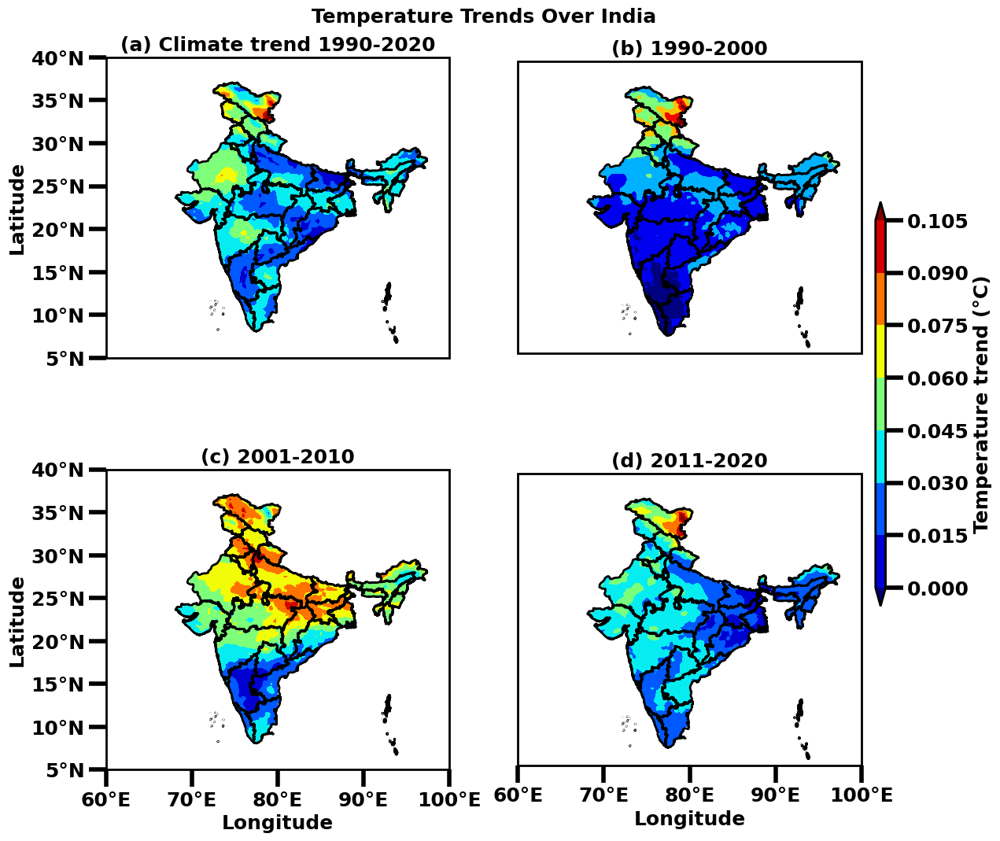

In [68]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

# Assuming `lons`, `lats`, `sst_rate1`, `sst_rate2`, `sst_rate3`, `sst_rate4`, and `india_feature` are defined

# Create a gridspec
fig = plt.figure(figsize=(12, 12))
gs = fig.add_gridspec(2, 2)

# Plotting sst_rate1 (1990-2020)
ax5 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
ax5.add_feature(india_feature)
pcm5 = ax5.contourf(lons, lats, sst_rate1, transform=ccrs.PlateCarree(), cmap='jet', extend='both')
ax5.set_title('(a) Climate trend 1990-2020', fontsize=18, fontweight='bold')
#ax5.set_xlabel('Longitude', fontweight='bold')
ax5.set_ylabel('Latitude', fontweight='bold')
#ax5.set_xticks(np.arange(60, 100, 10))
ax5.set_yticks(np.arange(5, 40.1, 5))
ax5.set_facecolor('white')

# Plotting sst_rate2 (1990-2000)
ax6 = fig.add_subplot(gs[0, 1], projection=ccrs.PlateCarree())
ax6.add_feature(india_feature)
pcm6 = ax6.contourf(lons, lats, sst_rate2, transform=ccrs.PlateCarree(), cmap='jet', extend='both')
ax6.set_title('(b) 1990-2000', fontsize=18, fontweight='bold')
#ax6.set_xlabel('Longitude', fontweight='bold')
#ax6.set_xticks(np.arange(60, 100, 10))
ax6.set_facecolor('white')

# Plotting sst_rate3 (2000-2010)
ax7 = fig.add_subplot(gs[1, 0], projection=ccrs.PlateCarree())
ax7.add_feature(india_feature)
pcm7 = ax7.contourf(lons, lats, sst_rate3, transform=ccrs.PlateCarree(), cmap='jet', extend='both')
ax7.set_title('(c) 2001-2010', fontsize=18, fontweight='bold')
ax7.set_xlabel('Longitude', fontweight='bold')
ax7.set_xticks(np.arange(60, 100.1, 10))
ax7.set_facecolor('white')

# Plotting sst_rate4 (2011-2020)
ax8 = fig.add_subplot(gs[1, 1], projection=ccrs.PlateCarree())
ax8.add_feature(india_feature)
pcm8 = ax8.contourf(lons, lats, sst_rate4, transform=ccrs.PlateCarree(), cmap='jet', extend='both')
ax8.set_title('(d) 2011-2020', fontsize=18, fontweight='bold')
ax8.set_xlabel('Longitude', fontweight='bold')
ax8.set_xticks(np.arange(60, 100.1, 10))
ax8.set_facecolor('white')

# Colorbar
cbar3 = fig.colorbar(pcm5, ax=[ax5, ax6, ax7, ax8], orientation='vertical', pad=0.02, aspect=40)
cbar3.set_label('Temperature trend (°C)', fontsize=18)
cbar3_ax = cbar3.ax
cbar3_ax.set_position([0.915, 0.296, 0.07, 0.42834])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

# Set axis ticks and labels for specific subplots
axes = [ax5, ax6, ax7, ax8]
for ax in axes:
    if ax in [ax7, ax8]:  # Row 1
        ax.set_xlabel('Longitude', fontsize=18, fontweight='bold')
        ax.set_xticks(np.arange(60, 100.1, 10))
        ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)))
    if ax in [ax5, ax7]:  # Column 0
        ax.set_ylabel('Latitude', fontsize=18, fontweight='bold')
        ax.set_yticks(np.arange(5, 40.1, 5))
        ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)))

# Adjustments
plt.tight_layout()
plt.subplots_adjust(top=0.9, bottom=0.1, left=0.1, right=0.9, hspace=0.2, wspace=0.2)
q = plt.suptitle('Temperature Trends Over India', fontsize=18, fontweight='bold')
q.set_position([0.5, 0.93])

# Set rcParams for the entire figure
plt.rcParams["font.weight"] = "bold"
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams['xtick.labelsize'] = 18
plt.rcParams['ytick.labelsize'] = 18
plt.rcParams["axes.linewidth"] = 2
plt.rcParams["patch.linewidth"] = 2
plt.rcParams['xtick.major.size'] = 16 
plt.rcParams['ytick.major.size'] = 16  
plt.rcParams['xtick.major.width'] = 4
plt.rcParams['ytick.major.width'] = 4
plt.rcParams['axes.titlesize'] = 22  # For axes titles
plt.rcParams['figure.titlesize'] = 22  # For overall figure title

# Show plot
plt.show()

C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)


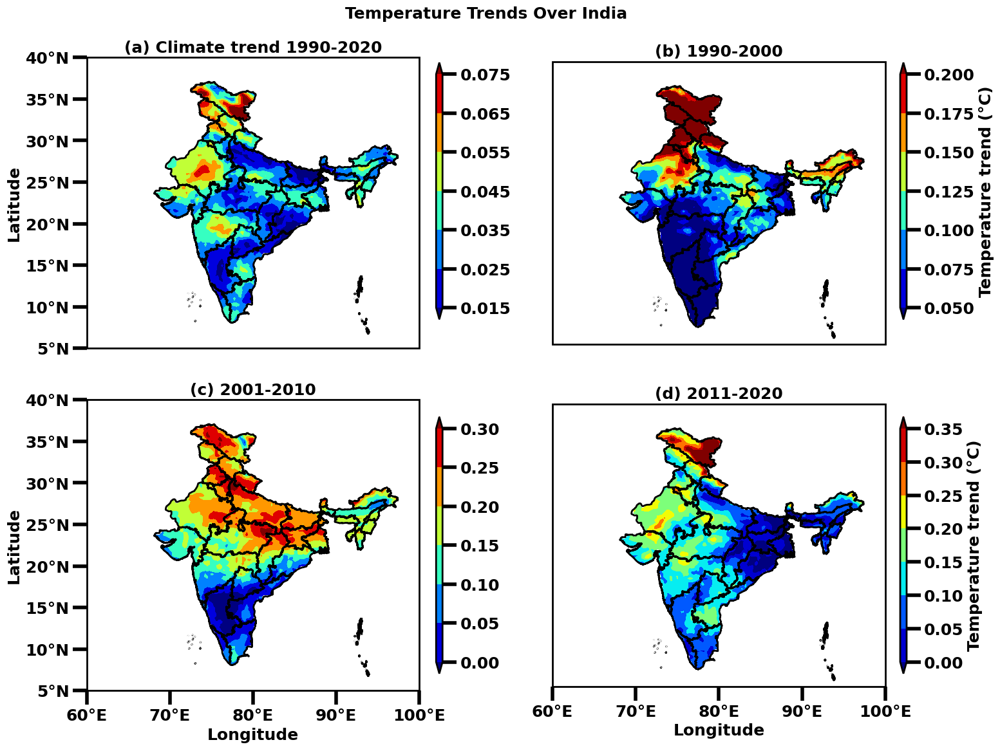

In [92]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

# Assuming `lons`, `lats`, `sst_rate1`, `sst_rate2`, `sst_rate3`, `sst_rate4`, and `india_feature` are defined
levels1= np.arange(0.015, 0.0751, 0.01)
levels2= np.arange(0.05, 0.21, 0.025)
levels3= np.arange(0, 0.31, 0.05)
levels4= np.arange(0, 0.351, 0.05)
# Create a gridspec
fig = plt.figure(figsize=(15.5, 13.3))
gs = fig.add_gridspec(2, 2, wspace=0.4, hspace=0)

# Plotting sst_rate1 (1990-2020)
ax5 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
ax5.add_feature(india_feature)
pcm5 = ax5.contourf(lons, lats, sst_rate1, transform=ccrs.PlateCarree(), levels=levels1, cmap='jet', extend='both', shrink=0.36)
ax5.set_title('(a) Climate trend 1990-2020', fontsize=18, fontweight='bold')
#ax5.set_xlabel('Longitude', fontweight='bold')
ax5.set_ylabel('Latitude', fontweight='bold')
#ax5.set_xticks(np.arange(60, 100, 10))
ax5.set_yticks(np.arange(5, 40.1, 5))
ax5.set_facecolor('white')

# Plotting sst_rate2 (1990-2000)
ax6 = fig.add_subplot(gs[0, 1], projection=ccrs.PlateCarree())
ax6.add_feature(india_feature)
pcm6 = ax6.contourf(lons, lats, sst_rate2, transform=ccrs.PlateCarree(), levels=levels2, cmap='jet', extend='both', shrink=0.36)
ax6.set_title('(b) 1990-2000', fontsize=18, fontweight='bold')
#ax6.set_xlabel('Longitude', fontweight='bold')
#ax6.set_xticks(np.arange(60, 100, 10))
ax6.set_facecolor('white')

# Plotting sst_rate3 (2000-2010)
ax7 = fig.add_subplot(gs[1, 0], projection=ccrs.PlateCarree())
ax7.add_feature(india_feature)
pcm7 = ax7.contourf(lons, lats, sst_rate3, transform=ccrs.PlateCarree(), levels=levels3, cmap='jet', extend='both', shrink=0.36)
ax7.set_title('(c) 2001-2010', fontsize=18, fontweight='bold')
ax7.set_xlabel('Longitude', fontweight='bold')
ax7.set_xticks(np.arange(60, 100.1, 10))
ax7.set_facecolor('white')

# Plotting sst_rate4 (2011-2020)
ax8 = fig.add_subplot(gs[1, 1], projection=ccrs.PlateCarree())
ax8.add_feature(india_feature)
pcm8 = ax8.contourf(lons, lats, sst_rate4, transform=ccrs.PlateCarree(), levels=levels4, cmap='jet', extend='both', shrink=0.36)
ax8.set_title('(d) 2011-2020', fontsize=18, fontweight='bold')
ax8.set_xlabel('Longitude', fontweight='bold')
ax8.set_xticks(np.arange(60, 100.1, 10))
ax8.set_facecolor('white')

# Colorbar
cbar3 = fig.colorbar(pcm5, ax=[ax5], orientation='vertical' , shrink=0.56, pad=0.02, aspect=40)
#.set_label('Temperature trend (°C)', fontsize=18)
cbar3_ax = cbar3.ax
cbar3_ax.set_position([0.45, 0.564, 0.07, 0.3])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

cbar4 = fig.colorbar(pcm6, ax=[ax6], orientation='vertical' , shrink=0.56, pad=0.02, aspect=40)
cbar4.set_label('Temperature trend (°C)', fontsize=18)
cbar4_ax = cbar4.ax
cbar4_ax.set_position([0.915, 0.564, 0.07, 0.3])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

cbar5 = fig.colorbar(pcm7, ax=[ax7], orientation='vertical' , shrink=0.56, pad=0.02, aspect=40)
#cbar5.set_label('Temperature trend (°C)', fontsize=18)
cbar5_ax = cbar5.ax
cbar5_ax.set_position([0.45, 0.15, 0.07, 0.3])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

cbar6 = fig.colorbar(pcm8, ax= [ax8], orientation='vertical' , shrink=0.56, pad=0.02, aspect=40)
cbar6.set_label('Temperature trend (°C)', fontsize=18)
cbar6_ax = cbar6.ax
cbar6_ax.set_position([0.915, 0.15, 0.07, 0.3])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

#cb
#cbar3_ax = cbar3.ax
#cbar3_ax.set_position([0.915, 0.296, 0.07, 0.42834])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

# Set axis ticks and labels for specific subplots
axes = [ax5, ax6, ax7, ax8]
for ax in axes:
    if ax in [ax7, ax8]:  # Row 1
        ax.set_xlabel('Longitude', fontsize=18, fontweight='bold')
        ax.set_xticks(np.arange(60, 100.1, 10))
        ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)))
    if ax in [ax5, ax7]:  # Column 0
        ax.set_ylabel('Latitude', fontsize=18, fontweight='bold')
        ax.set_yticks(np.arange(5, 40.1, 5))
        ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)))

# Adjustments
#plt.tight_layout()
plt.subplots_adjust(top=0.9, bottom=0.1, left=0.1, right=0.9, hspace=0.2, wspace=0.2)
q = plt.suptitle('Temperature Trends Over India', fontsize=18, fontweight='bold')
q.set_position([0.5, 0.93])

# Set rcParams for the entire figure
plt.rcParams["font.weight"] = "bold"
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams['xtick.labelsize'] = 18
plt.rcParams['ytick.labelsize'] = 18
plt.rcParams["axes.linewidth"] = 2
plt.rcParams["patch.linewidth"] = 2
plt.rcParams['xtick.major.size'] = 16 
plt.rcParams['ytick.major.size'] = 16  
plt.rcParams['xtick.major.width'] = 4
plt.rcParams['ytick.major.width'] = 4
plt.rcParams['axes.titlesize'] = 22  # For axes titles
plt.rcParams['figure.titlesize'] = 22  # For overall figure title

# Show plot
plt.show()

C:\Users\S Narayanaswami\AppData\Local\Temp\ipykernel_15732\196462482.py:61: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


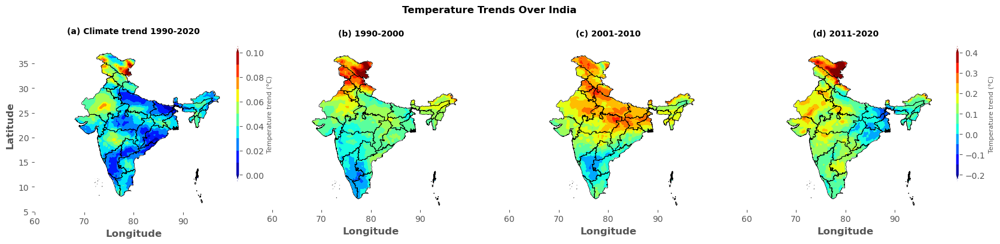

In [106]:

# Levels for contour plotting
levels3 = np.arange(-0., 0.11, 0.01)
levels4 = np.arange(-0.2, 0.41, 0.05)
# Create a gridspec
fig = plt.figure(figsize=(19, 5))
gs = gridspec.GridSpec(1, 4, width_ratios=[1, 1, 1, 1])

# Plotting sst_rate1 (1990-2020)
ax5 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
ax5.add_feature(india_feature)
pcm5 = ax5.contourf(lon, lat, sst_rate1, transform=ccrs.PlateCarree(), levels=levels3, cmap='jet', extend='both')
ax5.set_title('(a) Climate trend 1990-2020', fontsize=10, fontweight='bold')
ax5.set_xlabel('Longitude', fontweight='bold')
ax5.set_ylabel('Latitude', fontweight='bold')
ax5.set_xticks(np.arange(60, 100, 10))
ax5.set_yticks(np.arange(5, 35.1, 5))
ax5.set_facecolor('white')
# Plotting sst_rate2 (1990-2000)
ax6 = fig.add_subplot(gs[0, 1], projection=ccrs.PlateCarree())
ax6.add_feature(india_feature)
pcm6 = ax6.contourf(lon, lat, sst_rate2, transform=ccrs.PlateCarree(), levels=levels4, cmap='jet', extend='both')
ax6.set_title('(b) 1990-2000', fontsize=10, fontweight='bold')
ax6.set_xlabel('Longitude', fontweight='bold')
ax6.set_xticks(np.arange(60, 100, 10))
ax6.set_facecolor('white')
# Plotting sst_rate3 (2000-2010)
ax7 = fig.add_subplot(gs[0, 2], projection=ccrs.PlateCarree())
ax7.add_feature(india_feature)
pcm7 = ax7.contourf(lon, lat, sst_rate3, transform=ccrs.PlateCarree(), levels=levels4, cmap='jet', extend='both')
ax7.set_title('(c) 2001-2010', fontsize=10, fontweight='bold')
ax7.set_xlabel('Longitude', fontweight='bold')
ax7.set_facecolor('white')
ax7.set_xticks(np.arange(60, 100, 10))
ax7.set_facecolor('white')
# Plotting sst_rate4 (2011-2020)
ax8 = fig.add_subplot(gs[0, 3], projection=ccrs.PlateCarree())
ax8.add_feature(india_feature)
pcm8 = ax8.contourf(lon, lat, sst_rate4, transform=ccrs.PlateCarree(), levels=levels4, cmap='jet', extend='both')
ax8.set_title('(d) 2011-2020', fontsize=10, fontweight='bold')
ax8.set_xlabel('Longitude', fontweight='bold')
ax8.set_xticks(np.arange(60, 100, 10))
ax8.set_facecolor('white')
# Colorbar
#cbar = fig.colorbar(pcm5, ax=[ax5, ax6, ax7, ax8], shrink=0.6)
#cbar.set_label('Temperature trend (°C)', fontsize=8)

# Colorbars
cbar3 = fig.colorbar(pcm5, ax=[ax5], orientation='vertical', pad=0.02, aspect=40, extend='both')
cbar3.set_label('Temperature trend (°C)', fontsize=8)
cbar3_ax = cbar3.ax
# fig.subplots_adjust(bottom=0.15)  # Adjust the bottom margin to create space for the colorbar
cbar3_ax.set_position([0.277, 0.31296, 0.07, 0.45])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

cbar4 = fig.colorbar(pcm8, ax=[ax6, ax7, ax8], orientation='vertical', pad=0.02, aspect=40, extend='both')
cbar4.set_label('Temperature trend (°C)', fontsize=8)
cbar4_ax = cbar4.ax
# fig.subplots_adjust(bottom=0.15)  # Adjust the bottom margin to create space for the colorbar
cbar4_ax.set_position([0.91, 0.31296, 0.07, 0.45])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

# Adjustments
plt.tight_layout()
plt.subplots_adjust(top=0.9, bottom=0.1, left=0.1, right=0.9, hspace=0.2, wspace=0.2)
q = plt.suptitle('Temperature Trends Over India', fontsize=12, fontweight='bold')
q.set_position([0.5, 0.9, 0.2, 0.42834])
# Show plot
# Set rcParams for the entire figure
plt.rcParams["font.weight"] = "bold"
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams['xtick.labelsize'] = 18
plt.rcParams['ytick.labelsize'] = 18
plt.rcParams["axes.linewidth"] = 2
plt.rcParams["patch.linewidth"] = 2
plt.rcParams['xtick.major.size'] = 16 
plt.rcParams['ytick.major.size'] = 16  
plt.rcParams['xtick.major.width'] = 4
plt.rcParams['ytick.major.width'] = 4
plt.rcParams['axes.titlesize'] = 22  # For axes titles
plt.rcParams['figure.titlesize'] = 22  # For overall figure title

plt.show()


In [94]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import Point
from shapely.ops import unary_union
from cartopy.io.shapereader import Reader
from cartopy.feature import ShapelyFeature
from netCDF4 import Dataset as netcdf
from scipy.stats import ttest_1samp

# Define a function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Define the shapefile for India
india_shapefile = Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Load the dataset
d1 = xr.open_dataset(r'C:\summer_project\heat_stress\rh_daily.nc')

# Extract variables from the dataset
utci = d1['rh'][:] - 273.16  # Convert temperature from Kelvin to Celsius
lons = d1['longitude'].values
lats = d1['latitude'].values

# Divide data into different time periods
sst1 = d1['rh'][0:3782, :, :]
sst2 = d1['rh'][0:1342, :, :]
sst3 = d1['rh'][1343:2562, :, :]
sst4 = d1['rh'][2563:3782, :, :]

nctime1 = d1['time'][0:3782]
nctime2 = d1['time'][0:1342]
nctime3 = d1['time'][1343:2562]
nctime4 = d1['time'][2563:3782]

# Extract dimensions
nt1, nlat1, nlon1 = sst1.shape
nt2, nlat2, nlon2 = sst2.shape
nt3, nlat3, nlon3 = sst3.shape
nt4, nlat4, nlon4 = sst4.shape

ngrd = nlon1 * nlat1  # Total number of grid points

# Reshape the data for linear regression
sst1_values = sst1.values.reshape((nt1, ngrd), order='F')
sst2_values = sst2.values.reshape((nt2, ngrd), order='F')
sst3_values = sst3.values.reshape((nt3, ngrd), order='F')
sst4_values = sst4.values.reshape((nt4, ngrd), order='F')

x1 = np.linspace(1, nt1, nt1)
x2 = np.linspace(1, nt2, nt2)
x3 = np.linspace(1, nt3, nt3)
x4 = np.linspace(1, nt4, nt4)

# Arrays to store the calculated slopes
sst_rate1 = np.empty((ngrd, 1))
sst_rate1[:, :] = np.nan
sst_rate2 = np.empty((ngrd, 1))
sst_rate2[:, :] = np.nan
sst_rate3 = np.empty((ngrd, 1))
sst_rate3[:, :] = np.nan
sst_rate4 = np.empty((ngrd, 1))
sst_rate4[:, :] = np.nan

significant_areas1 = []
significant_areas2 = []
significant_areas3 = []
significant_areas4 = []

# Perform linear regression and calculate annual change (trend)
for i in range(ngrd):
    y1 = sst1_values[:, i]
    y2 = sst2_values[:, i]
    y3 = sst3_values[:, i]
    y4 = sst4_values[:, i]
    
    if not np.ma.is_masked(y1):
        z1 = np.polyfit(x1, y1, 1)
        slope1 = z1[0]
        p_value1 = ttest_1samp(y1 - slope1 * x1, 0).pvalue
        if p_value1 < 0.25:  # 90% confidence level
            sst_rate1[i, 0] = slope1 * 122.0  # Convert slope to annual change
            significant_areas1.append((i % nlon1, i // nlon1))
        else:
            sst_rate1[i, 0] = np.nan

    if not np.ma.is_masked(y2):
        z2 = np.polyfit(x2, y2, 1)
        slope2 = z2[0]
        p_value2 = ttest_1samp(y2 - slope2 * x2, 0).pvalue
        if p_value2 < 0.25:  # 90% confidence level
            sst_rate2[i, 0] = slope2 * 122.0  # Convert slope to annual change
            significant_areas2.append((i % nlon2, i // nlon2))
        else:
            sst_rate2[i, 0] = np.nan

    if not np.ma.is_masked(y3):
        z3 = np.polyfit(x3, y3, 1)
        slope3 = z3[0]
        p_value3 = ttest_1samp(y3 - slope3 * x3, 0).pvalue
        if p_value3 < 0.25:  # 90% confidence level
            sst_rate3[i, 0] = slope3 * 122.0  # 6Convert slope to annual change
            significant_areas3.append((i % nlon3, i // nlon3))
        else:
            sst_rate3[i, 0] = np.nan
    if not np.ma.is_masked(y4):
        z4 = np.polyfit(x4, y4, 1)
        slope4 = z4[0]
        p_value4 = ttest_1samp(y4 - slope4 * x4, 0).pvalue
        if p_value3 < 0.25:  # 90% confidence level
            sst_rate4[i, 0] = slope4 * 122.0  # Convert slope to annual change
            significant_areas4.append((i % nlon4, i // nlon3))
        else:
            sst_rate4[i, 0] = np.nan

# Reshape the results to grid shape
sst_rate1 = sst_rate1.reshape((nlat1, nlon1), order='F')
sst_rate2 = sst_rate2.reshape((nlat2, nlon2), order='F')
sst_rate3 = sst_rate3.reshape((nlat3, nlon3), order='F')
sst_rate4 = sst_rate4.reshape((nlat4, nlon4), order='F')



In [21]:
print(mask)

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [23]:
# Create a mask for India region
mask = np.zeros((len(lats), len(lons)), dtype=int)

for i in range(len(lats)):
    for j in range(len(lons)):
        if is_inside_india(lats[i], lons[j], india_polygon):
            mask[i, j] = 1
        #else:
            #mask[i, j] = 0  # PlateCarree projection


In [24]:
# Define a function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Define the shapefile for India
india_shapefile = Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')


C:\Users\S Narayanaswami\AppData\Local\Temp\ipykernel_7164\2402589248.py:70: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


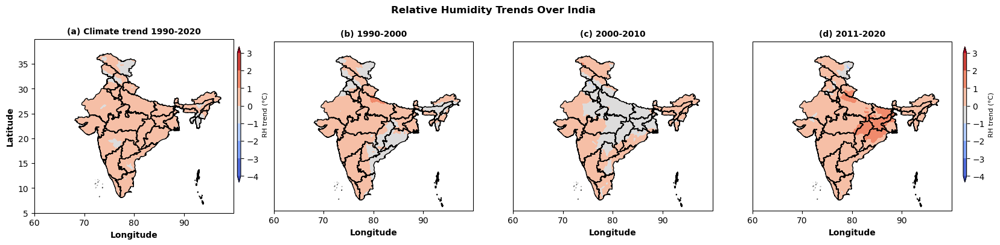

In [25]:
# Apply mask to temperature rate arrays
#sst_rate1 = sst_rate1.where(mask == 1, np.nan)

sst_rate1 = np.where(mask == 1, sst_rate1, np.nan)
sst_rate2 = np.where(mask == 1, sst_rate2, np.nan)
sst_rate3 = np.where(mask == 1, sst_rate3, np.nan)
sst_rate4 = np.where(mask == 1, sst_rate4, np.nan)

# Levels for contour plotting
levels3 = np.arange(-4, 4, 1)
levels4 = np.arange(-4, 4, 1)

# Create a gridspec
fig = plt.figure(figsize=(19, 5))
gs = gridspec.GridSpec(1, 4, width_ratios=[1, 1, 1, 1])

# Plotting sst_rate1 (1990-2020)
ax5 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
ax5.add_feature(india_feature)
pcm5 = ax5.contourf(lons, lats, sst_rate1, transform=ccrs.PlateCarree(), levels=levels3, cmap='coolwarm', extend='both')
ax5.set_title('(a) Climate trend 1990-2020', fontsize=10, fontweight='bold')
ax5.set_xlabel('Longitude', fontweight='bold')
ax5.set_ylabel('Latitude', fontweight='bold')
ax5.set_xticks(np.arange(60, 100, 10))
ax5.set_yticks(np.arange(5, 35.1, 5))
ax5.set_facecolor('white')
# Plotting sst_rate2 (1990-2000)
ax6 = fig.add_subplot(gs[0, 1], projection=ccrs.PlateCarree())
ax6.add_feature(india_feature)
pcm6 = ax6.contourf(lons, lats, sst_rate2, transform=ccrs.PlateCarree(), levels=levels4, cmap='coolwarm', extend='both')
ax6.set_title('(b) 1990-2000', fontsize=10, fontweight='bold')
ax6.set_xlabel('Longitude', fontweight='bold')
ax6.set_xticks(np.arange(60, 100, 10))
ax6.set_facecolor('white')
# Plotting sst_rate3 (2000-2010)
ax7 = fig.add_subplot(gs[0, 2], projection=ccrs.PlateCarree())
ax7.add_feature(india_feature)
pcm7 = ax7.contourf(lons, lats, sst_rate3, transform=ccrs.PlateCarree(), levels=levels4, cmap='coolwarm', extend='both')
ax7.set_title('(c) 2000-2010', fontsize=10, fontweight='bold')
ax7.set_xlabel('Longitude', fontweight='bold')
ax7.set_facecolor('white')
ax7.set_xticks(np.arange(60, 100, 10))
ax7.set_facecolor('white')
# Plotting sst_rate4 (2011-2020)
ax8 = fig.add_subplot(gs[0, 3], projection=ccrs.PlateCarree())
ax8.add_feature(india_feature)
pcm8 = ax8.contourf(lons, lats, sst_rate4, transform=ccrs.PlateCarree(), levels=levels4, cmap='coolwarm', extend='both')
ax8.set_title('(d) 2011-2020', fontsize=10, fontweight='bold')
ax8.set_xlabel('Longitude', fontweight='bold')
ax8.set_xticks(np.arange(60, 100, 10))
ax8.set_facecolor('white')
# Colorbar
#cbar = fig.colorbar(pcm5, ax=[ax5, ax6, ax7, ax8], shrink=0.6)
#cbar.set_label('Temperature trend (°C)', fontsize=8)

# Colorbars
cbar3 = fig.colorbar(pcm5, ax=[ax5], orientation='vertical', pad=0.02, aspect=40, extend='both')
cbar3.set_label('RH trend (°C)', fontsize=8)
cbar3_ax = cbar3.ax
# fig.subplots_adjust(bottom=0.15)  # Adjust the bottom margin to create space for the colorbar
cbar3_ax.set_position([0.277, 0.31296, 0.07, 0.45])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

cbar4 = fig.colorbar(pcm8, ax=[ax6, ax7, ax8], orientation='vertical', pad=0.02, aspect=40, extend='both')
cbar4.set_label('RH trend (°C)', fontsize=8)
cbar4_ax = cbar4.ax
# fig.subplots_adjust(bottom=0.15)  # Adjust the bottom margin to create space for the colorbar
cbar4_ax.set_position([0.91, 0.31296, 0.07, 0.45])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

# Adjustments
plt.tight_layout()
plt.subplots_adjust(top=0.9, bottom=0.1, left=0.1, right=0.9, hspace=0.2, wspace=0.2)
q = plt.suptitle('Relative Humidity Trends Over India', fontsize=12, fontweight='bold')
q.set_position([0.5, 0.9, 0.2, 0.42834])
# Show plot
plt.show()


C:\Users\S Narayanaswami\AppData\Local\Temp\ipykernel_7164\1841906812.py:67: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


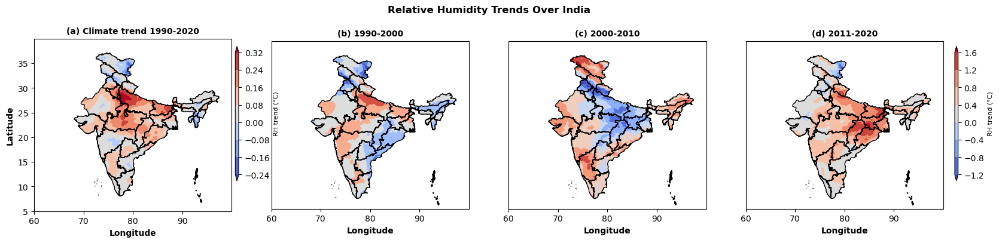

In [26]:
sst_rate1 = np.where(mask == 1, sst_rate1, np.nan)
sst_rate2 = np.where(mask == 1, sst_rate2, np.nan)
sst_rate3 = np.where(mask == 1, sst_rate3, np.nan)
sst_rate4 = np.where(mask == 1, sst_rate4, np.nan)

# Levels for contour plotting
levels3 = np.arange(0.01, 0.11, 0.01)
levels4 = np.arange(-1, 1.15, 0.025)

# Create a gridspec
fig = plt.figure(figsize=(19, 5))
gs = gridspec.GridSpec(1, 4, width_ratios=[1, 1, 1, 1])

# Plotting sst_rate1 (1990-2020)
ax5 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
ax5.add_feature(india_feature)
pcm5 = ax5.contourf(lons, lats, sst_rate1, transform=ccrs.PlateCarree(), cmap='coolwarm', extend='both')
ax5.set_title('(a) Climate trend 1990-2020', fontsize=10, fontweight='bold')
ax5.set_xlabel('Longitude', fontweight='bold')
ax5.set_ylabel('Latitude', fontweight='bold')
ax5.set_xticks(np.arange(60, 100, 10))
ax5.set_yticks(np.arange(5, 35.1, 5))
ax5.set_facecolor('white')
# Plotting sst_rate2 (1990-2000)
ax6 = fig.add_subplot(gs[0, 1], projection=ccrs.PlateCarree())
ax6.add_feature(india_feature)
pcm6 = ax6.contourf(lons, lats, sst_rate2, transform=ccrs.PlateCarree(), cmap='coolwarm', extend='both')
ax6.set_title('(b) 1990-2000', fontsize=10, fontweight='bold')
ax6.set_xlabel('Longitude', fontweight='bold')
ax6.set_xticks(np.arange(60, 100, 10))
ax6.set_facecolor('white')
# Plotting sst_rate3 (2000-2010)
ax7 = fig.add_subplot(gs[0, 2], projection=ccrs.PlateCarree())
ax7.add_feature(india_feature)
pcm7 = ax7.contourf(lons, lats, sst_rate3, transform=ccrs.PlateCarree(), cmap='coolwarm', extend='both')
ax7.set_title('(c) 2000-2010', fontsize=10, fontweight='bold')
ax7.set_xlabel('Longitude', fontweight='bold')
ax7.set_facecolor('white')
ax7.set_xticks(np.arange(60, 100, 10))
ax7.set_facecolor('white')
# Plotting sst_rate4 (2011-2020)
ax8 = fig.add_subplot(gs[0, 3], projection=ccrs.PlateCarree())
ax8.add_feature(india_feature)
pcm8 = ax8.contourf(lons, lats, sst_rate4, transform=ccrs.PlateCarree(), cmap='coolwarm', extend='both')
ax8.set_title('(d) 2011-2020', fontsize=10, fontweight='bold')
ax8.set_xlabel('Longitude', fontweight='bold')
ax8.set_xticks(np.arange(60, 100, 10))
ax8.set_facecolor('white')
# Colorbar
#cbar = fig.colorbar(pcm5, ax=[ax5, ax6, ax7, ax8], shrink=0.6)
#cbar.set_label('Temperature trend (°C)', fontsize=8)

# Colorbars
cbar3 = fig.colorbar(pcm5, ax=[ax5], orientation='vertical', pad=0.02, aspect=40, extend='both')
cbar3.set_label('RH trend (°C)', fontsize=8)
cbar3_ax = cbar3.ax
# fig.subplots_adjust(bottom=0.15)  # Adjust the bottom margin to create space for the colorbar
cbar3_ax.set_position([0.277, 0.31296, 0.07, 0.45])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

cbar4 = fig.colorbar(pcm8, ax=[ax6, ax7, ax8], orientation='vertical', pad=0.02, aspect=40, extend='both')
cbar4.set_label('RH trend (°C)', fontsize=8)
cbar4_ax = cbar4.ax
# fig.subplots_adjust(bottom=0.15)  # Adjust the bottom margin to create space for the colorbar
cbar4_ax.set_position([0.91, 0.31296, 0.07, 0.45])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

# Adjustments
plt.tight_layout()
plt.subplots_adjust(top=0.9, bottom=0.1, left=0.1, right=0.9, hspace=0.2, wspace=0.2)
q = plt.suptitle('Relative Humidity Trends Over India', fontsize=12, fontweight='bold')
q.set_position([0.5, 0.9, 0.2, 0.42834])
# Show plot
plt.show()


C:\Users\S Narayanaswami\AppData\Local\Temp\ipykernel_7164\274915266.py:68: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


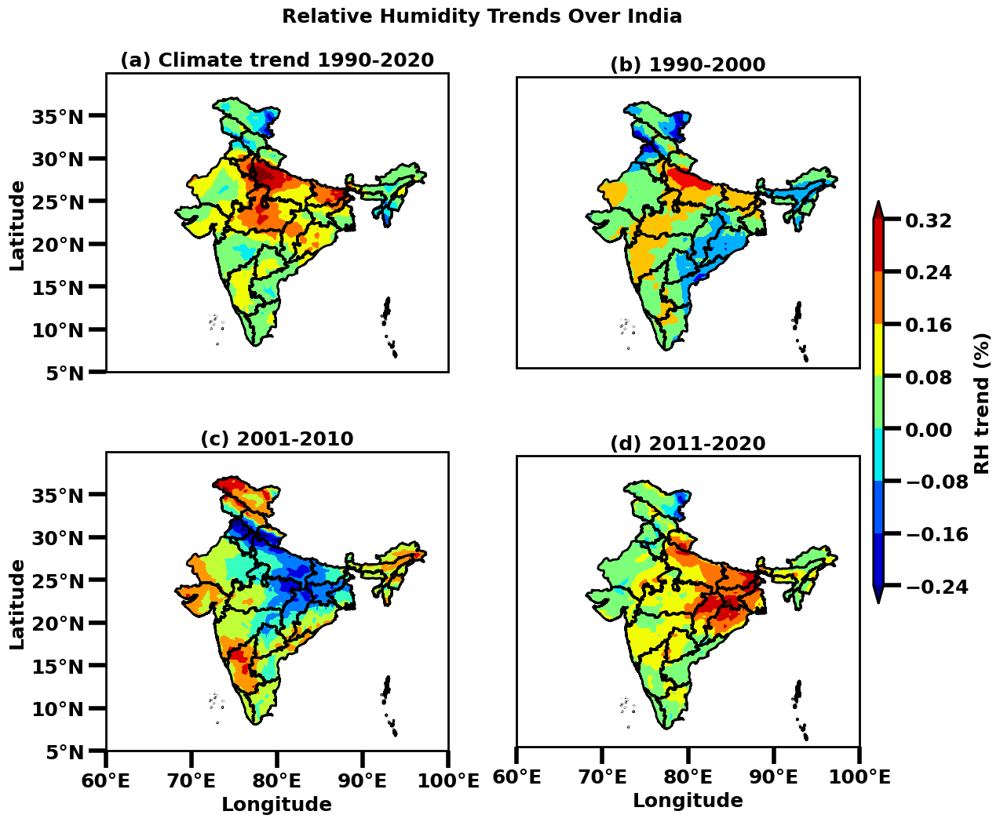

In [51]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

# Assuming `lons`, `lats`, `sst_rate1`, `sst_rate2`, `sst_rate3`, `sst_rate4`, and `india_feature` are defined

# Create a gridspec
fig = plt.figure(figsize=(12, 12))
gs = fig.add_gridspec(2, 2, wspace=0.2, hspace=0.012)

# Plotting sst_rate1 (1990-2020)
ax5 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
ax5.add_feature(india_feature)
pcm5 = ax5.contourf(lons, lats, sst_rate1, transform=ccrs.PlateCarree(), cmap='jet', extend='both')
ax5.set_title('(a) Climate trend 1990-2020', fontsize=18, fontweight='bold')
#ax5.set_xlabel('Longitude', fontweight='bold')
ax5.set_ylabel('Latitude', fontweight='bold')
#ax5.set_xticks(np.arange(60, 100, 10))
#ax5.set_yticks(np.arange(5, 35.1, 5))
ax5.set_facecolor('white')

# Plotting sst_rate2 (1990-2000)
ax6 = fig.add_subplot(gs[0, 1], projection=ccrs.PlateCarree())
ax6.add_feature(india_feature)
pcm6 = ax6.contourf(lons, lats, sst_rate2, transform=ccrs.PlateCarree(), cmap='jet', extend='both')
ax6.set_title('(b) 1990-2000', fontsize=18, fontweight='bold')
#ax6.set_xlabel('Longitude', fontweight='bold')
#ax6.set_xticks(np.arange(60, 100, 10))
ax6.set_facecolor('white')

# Plotting sst_rate3 (2000-2010)
ax7 = fig.add_subplot(gs[1, 0], projection=ccrs.PlateCarree())
ax7.add_feature(india_feature)
pcm7 = ax7.contourf(lons, lats, sst_rate3, transform=ccrs.PlateCarree(), cmap='jet', extend='both')
ax7.set_title('(c) 2001-2010', fontsize=18, fontweight='bold')
ax7.set_xlabel('Longitude', fontweight='bold')
ax7.set_xticks(np.arange(60, 100, 10))
ax7.set_facecolor('white')

# Plotting sst_rate4 (2011-2020)
ax8 = fig.add_subplot(gs[1, 1], projection=ccrs.PlateCarree())
ax8.add_feature(india_feature)
pcm8 = ax8.contourf(lons, lats, sst_rate4, transform=ccrs.PlateCarree(), cmap='jet', extend='both')
ax8.set_title('(d) 2011-2020', fontsize=18, fontweight='bold')
ax8.set_xlabel('Longitude', fontweight='bold')
ax8.set_xticks(np.arange(60, 100, 10))
ax8.set_facecolor('white')

# Colorbar
cbar3 = fig.colorbar(pcm5, ax=[ax5, ax6, ax7, ax8], orientation='vertical', pad=0.02, aspect=40)
cbar3.set_label('RH trend (%)', fontsize=18)
cbar3_ax = cbar3.ax
cbar3_ax.set_position([0.915, 0.296, 0.07, 0.42834])  # (L-R, moving T-B, bar width,CBAR LEN)   Adjust the position and size of the colorbar

# Set axis ticks and labels for specific subplots
axes = [ax5, ax6, ax7, ax8]
for ax in axes:
    if ax in [ax7, ax8]:  # Row 1
        ax.set_xlabel('Longitude', fontsize=18, fontweight='bold')
        ax.set_xticks(np.arange(60, 100.1, 10))
        ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)))
    if ax in [ax5, ax7]:  # Column 0
        ax.set_ylabel('Latitude', fontsize=18, fontweight='bold')
        ax.set_yticks(np.arange(5, 35.1, 5))
        ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)))

# Adjustments
plt.tight_layout()
plt.subplots_adjust(top=0.9, bottom=0.1, left=0.1, right=0.9, hspace=0.2, wspace=0.2)
q = plt.suptitle('Relative Humidity Trends Over India', fontsize=18, fontweight='bold')
q.set_position([0.5, 0.93])

# Set rcParams for the entire figure
plt.rcParams["font.weight"] = "bold"
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams['xtick.labelsize'] = 18
plt.rcParams['ytick.labelsize'] = 18
plt.rcParams["axes.linewidth"] = 2
plt.rcParams["patch.linewidth"] = 2
plt.rcParams['xtick.major.size'] = 16 
plt.rcParams['ytick.major.size'] = 16  
plt.rcParams['xtick.major.width'] = 4
plt.rcParams['ytick.major.width'] = 4
plt.rcParams['axes.titlesize'] = 22  # For axes titles
plt.rcParams['figure.titlesize'] = 22  # For overall figure title

# Show plot
plt.show()

In [1]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import Point
from shapely.ops import unary_union
from cartopy.io.shapereader import Reader
from cartopy.feature import ShapelyFeature
from netCDF4 import Dataset as netcdf
from scipy.stats import ttest_1samp

# Define a function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Define the shapefile for India
india_shapefile = Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
india_feature = ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Load the dataset
d1 = xr.open_dataset(r'C:\summer_project\heat_stress\ws_daily.nc')

# Extract variables from the dataset
utci = d1['ws'][:] - 273.16  # Convert temperature from Kelvin to Celsius
lons = d1['longitude'].values
lats = d1['latitude'].values

# Divide data into different time periods
sst1 = d1['ws'][0:3782, :, :]
sst2 = d1['ws'][0:1342, :, :]
sst3 = d1['ws'][1343:2562, :, :]
sst4 = d1['ws'][2563:3782, :, :]

nctime1 = d1['time'][0:3782]
nctime2 = d1['time'][0:1342]
nctime3 = d1['time'][1343:2562]
nctime4 = d1['time'][2563:3782]

# Extract dimensions
nt1, nlat1, nlon1 = sst1.shape
nt2, nlat2, nlon2 = sst2.shape
nt3, nlat3, nlon3 = sst3.shape
nt4, nlat4, nlon4 = sst4.shape

ngrd = nlon1 * nlat1  # Total number of grid points

# Reshape the data for linear regression
sst1_values = sst1.values.reshape((nt1, ngrd), order='F')
sst2_values = sst2.values.reshape((nt2, ngrd), order='F')
sst3_values = sst3.values.reshape((nt3, ngrd), order='F')
sst4_values = sst4.values.reshape((nt4, ngrd), order='F')

x1 = np.linspace(1, nt1, nt1)
x2 = np.linspace(1, nt2, nt2)
x3 = np.linspace(1, nt3, nt3)
x4 = np.linspace(1, nt4, nt4)

# Arrays to store the calculated slopes
sst_rate1 = np.empty((ngrd, 1))
sst_rate1[:, :] = np.nan
sst_rate2 = np.empty((ngrd, 1))
sst_rate2[:, :] = np.nan
sst_rate3 = np.empty((ngrd, 1))
sst_rate3[:, :] = np.nan
sst_rate4 = np.empty((ngrd, 1))
sst_rate4[:, :] = np.nan

significant_areas1 = []
significant_areas2 = []
significant_areas3 = []
significant_areas4 = []

# Perform linear regression and calculate annual change (trend)
for i in range(ngrd):
    y1 = sst1_values[:, i]
    y2 = sst2_values[:, i]
    y3 = sst3_values[:, i]
    y4 = sst4_values[:, i]
    
    if not np.ma.is_masked(y1):
        z1 = np.polyfit(x1, y1, 1)
        slope1 = z1[0]
        p_value1 = ttest_1samp(y1 - slope1 * x1, 0).pvalue
        if p_value1 < 0.25:  # 90% confidence level
            sst_rate1[i, 0] = slope1 * 122.0  # Convert slope to annual change
            significant_areas1.append((i % nlon1, i // nlon1))
        else:
            sst_rate1[i, 0] = np.nan

    if not np.ma.is_masked(y2):
        z2 = np.polyfit(x2, y2, 1)
        slope2 = z2[0]
        p_value2 = ttest_1samp(y2 - slope2 * x2, 0).pvalue
        if p_value2 < 0.25:  # 90% confidence level
            sst_rate2[i, 0] = slope2 * 122.0  # Convert slope to annual change
            significant_areas2.append((i % nlon2, i // nlon2))
        else:
            sst_rate2[i, 0] = np.nan

    if not np.ma.is_masked(y3):
        z3 = np.polyfit(x3, y3, 1)
        slope3 = z3[0]
        p_value3 = ttest_1samp(y3 - slope3 * x3, 0).pvalue
        if p_value3 < 0.25:  # 90% confidence level
            sst_rate3[i, 0] = slope3 * 122.0  # Convert slope to annual change
            significant_areas3.append((i % nlon3, i // nlon3))
        else:
            sst_rate3[i, 0] = np.nan
    if not np.ma.is_masked(y4):
        z4 = np.polyfit(x4, y4, 1)
        slope4 = z4[0]
        p_value4 = ttest_1samp(y4 - slope4 * x4, 0).pvalue
        if p_value3 < 0.25:  # 90% confidence level
            sst_rate4[i, 0] = slope4 * 122.0  # Convert slope to annual change
            significant_areas4.append((i % nlon4, i // nlon3))
        else:
            sst_rate4[i, 0] = np.nan

# Reshape the results to grid shape
sst_rate1 = sst_rate1.reshape((nlat1, nlon1), order='F')
sst_rate2 = sst_rate2.reshape((nlat2, nlon2), order='F')
sst_rate3 = sst_rate3.reshape((nlat3, nlon3), order='F')
sst_rate4 = sst_rate4.reshape((nlat4, nlon4), order='F')



C:\ProgramData\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated
  "class": algorithms.Blowfish,


In [5]:
# Create a mask for India region
mask = np.zeros((len(lats), len(lons)), dtype=int)

for i in range(len(lats)):
    for j in range(len(lons)):
        if is_inside_india(lats[i], lons[j], india_polygon):
            mask[i, j] = 1
#        #else:
            #mask[i, j] = 0  # PlateCarree projection
# Apply mask to temperature rate arrays
#sst_rate1 = sst_rate1.where(mask == 1, np.nan)

sst_rate1 = np.where(mask == 1, sst_rate1, np.nan)
sst_rate2 = np.where(mask == 1, sst_rate2, np.nan)
sst_rate3 = np.where(mask == 1, sst_rate3, np.nan)
sst_rate4 = np.where(mask == 1, sst_rate4, np.nan)

In [11]:
sst_rate4

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

C:\Users\S Narayanaswami\AppData\Local\Temp\ipykernel_9028\1721245181.py:76: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


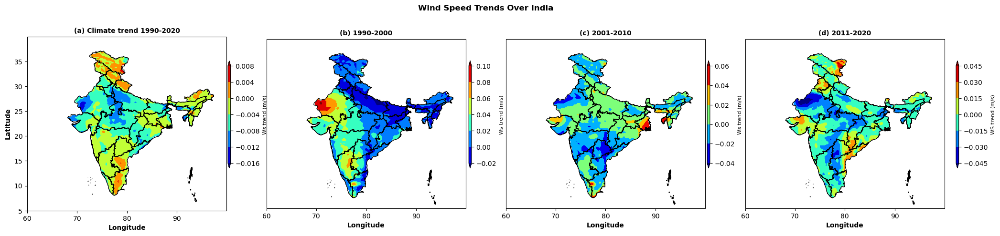

In [45]:
# Levels for contour plotting
levels3 = np.arange(1, 8.1, 1)
levels4 = np.arange(1, 10.1, 1)

# Create a gridspec
fig = plt.figure(figsize=(24, 5))
gs = gridspec.GridSpec(1, 4, width_ratios=[1, 1, 1, 1])

# Plotting sst_rate1 (1990-2020)
ax5 = fig.add_subplot(gs[0, 0], projection=ccrs.PlateCarree())
ax5.add_feature(india_feature)
pcm5 = ax5.contourf(lons, lats, sst_rate1, transform=ccrs.PlateCarree(), cmap='jet', extend='both')
ax5.set_title('(a) Climate trend 1990-2020', fontsize=10, fontweight='bold')
ax5.set_xlabel('Longitude', fontweight='bold')
ax5.set_ylabel('Latitude', fontweight='bold')
ax5.set_xticks(np.arange(60, 100, 10))
ax5.set_yticks(np.arange(5, 35.1, 5))
ax5.set_facecolor('white')

# Plotting sst_rate2 (1990-2000)
ax6 = fig.add_subplot(gs[0, 1], projection=ccrs.PlateCarree())
ax6.add_feature(india_feature)
pcm6 = ax6.contourf(lons, lats, sst_rate2, transform=ccrs.PlateCarree(), cmap='jet', extend='both')
ax6.set_title('(b) 1990-2000', fontsize=10, fontweight='bold')
ax6.set_xlabel('Longitude', fontweight='bold')
#ax6.set_ylabel('Latitude', fontweight='bold')
ax6.set_xticks(np.arange(60, 100, 10))
#ax6.set_yticks(np.arange(5, 35.1, 5))
ax6.set_facecolor('white')

# Plotting sst_rate3 (2000-2010)
ax7 = fig.add_subplot(gs[0, 2], projection=ccrs.PlateCarree())
ax7.add_feature(india_feature)
pcm7 = ax7.contourf(lons, lats, sst_rate3, transform=ccrs.PlateCarree(), cmap='jet', extend='both')
ax7.set_title('(c) 2001-2010', fontsize=10, fontweight='bold')
ax7.set_xlabel('Longitude', fontweight='bold')
#ax7.set_ylabel('Latitude', fontweight='bold')
ax7.set_xticks(np.arange(60, 100, 10))
#ax7.set_yticks(np.arange(5, 35.1, 5))
ax7.set_facecolor('white')

# Plotting sst_rate4 (2011-2020)
ax8 = fig.add_subplot(gs[0, 3], projection=ccrs.PlateCarree())
ax8.add_feature(india_feature)
pcm8 = ax8.contourf(lons, lats, sst_rate4, transform=ccrs.PlateCarree(), cmap='jet', extend='both')
ax8.set_title('(d) 2011-2020', fontsize=10, fontweight='bold')
ax8.set_xlabel('Longitude', fontweight='bold')
#ax8.set_ylabel('Latitude', fontweight='bold')
ax8.set_xticks(np.arange(60, 100, 10))
#ax8.set_yticks(np.arange(5, 35.1, 5))
#ax8.set_facecolor('white')
ax8.set_facecolor('white')

# Colorbars
cbar1 = fig.colorbar(pcm5, ax=[ax5], orientation='vertical', pad=0.02, aspect=40)
cbar1.set_label('Ws trend (m/s)', fontsize=8)
cbar1_ax = cbar1.ax
cbar1_ax.set_position([0.275, 0.31296, 0.07, 0.45])
# Colorbars
cbar2 = fig.colorbar(pcm6, ax=[ax6], orientation='vertical', pad=0.02, aspect=40)
cbar2.set_label('Ws trend (m/s)', fontsize=8)
cbar2_ax = cbar2.ax
cbar2_ax.set_position([0.4850751, 0.31296, 0.07, 0.45])
# Colorbars
cbar3 = fig.colorbar(pcm7, ax=[ax7], orientation='vertical', pad=0.02, aspect=40)
cbar3.set_label('Ws trend (m/s)', fontsize=8)
cbar3_ax = cbar3.ax
cbar3_ax.set_position([0.693, 0.31296, 0.07, 0.45])

cbar4 = fig.colorbar(pcm8, ax=[ax8], orientation='vertical', pad=0.02, aspect=40)
cbar4.set_label('WS trend (m/s)', fontsize=8)
cbar4_ax = cbar4.ax
cbar4_ax.set_position([0.91, 0.31296, 0.07, 0.45])

# Adjustments
plt.tight_layout()
plt.subplots_adjust(top=0.9, bottom=0.1, left=0.1, right=0.9, hspace=0.2, wspace=0.2)
q = plt.suptitle('Wind Speed Trends Over India', fontsize=12, fontweight='bold')
q.set_position([0.5, 0.999, 0.2, 0.42834])

# Show plot
plt.show()



In [49]:
dk = xr.open_dataset(r'C:\summer_project\heat_stress\utci_daily_anomaly.nc')
print(dk.variables)

Frozen({'time': <xarray.IndexVariable 'time' (time: 3782)>
array(['1990-03-01T00:00:00.000000000', '1990-03-02T00:00:00.000000000',
       '1990-03-03T00:00:00.000000000', ..., '2020-06-28T11:30:00.000000000',
       '2020-06-29T11:30:00.000000000', '2020-06-30T11:30:00.000000000'],
      dtype='datetime64[ns]')
Attributes:
    standard_name:  time
    axis:           T, 'lon': <xarray.IndexVariable 'lon' (lon: 161)>
array([ 60.  ,  60.25,  60.5 ,  60.75,  61.  ,  61.25,  61.5 ,  61.75,  62.  ,
        62.25,  62.5 ,  62.75,  63.  ,  63.25,  63.5 ,  63.75,  64.  ,  64.25,
        64.5 ,  64.75,  65.  ,  65.25,  65.5 ,  65.75,  66.  ,  66.25,  66.5 ,
        66.75,  67.  ,  67.25,  67.5 ,  67.75,  68.  ,  68.25,  68.5 ,  68.75,
        69.  ,  69.25,  69.5 ,  69.75,  70.  ,  70.25,  70.5 ,  70.75,  71.  ,
        71.25,  71.5 ,  71.75,  72.  ,  72.25,  72.5 ,  72.75,  73.  ,  73.25,
        73.5 ,  73.75,  74.  ,  74.25,  74.5 ,  74.75,  75.  ,  75.25,  75.5 ,
        75.75,  76.  ,  76

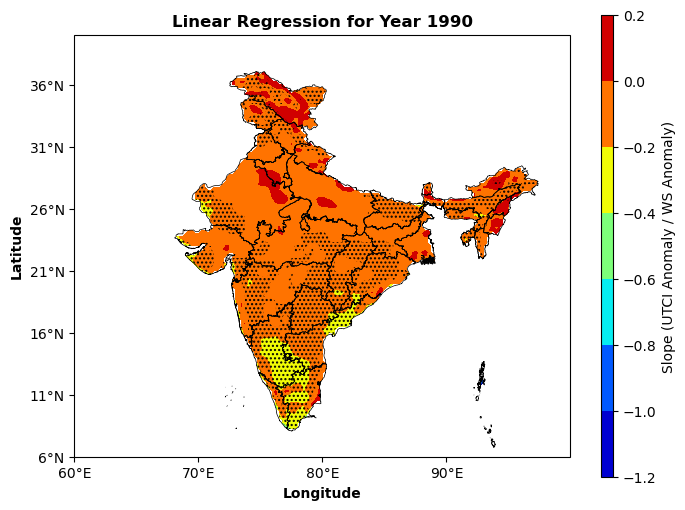

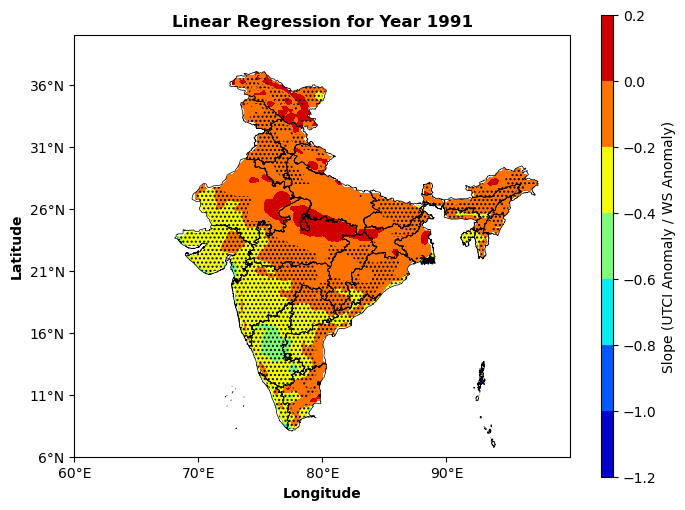

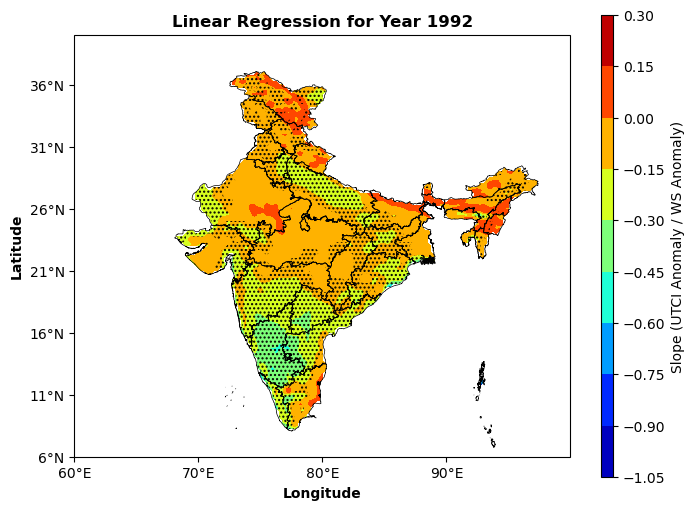

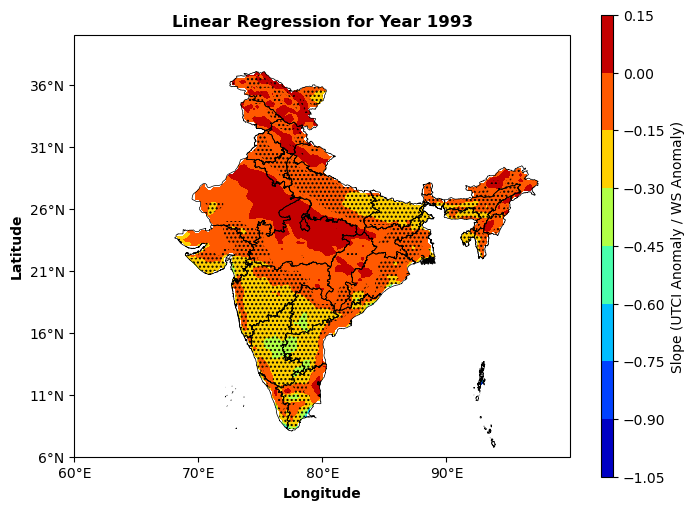

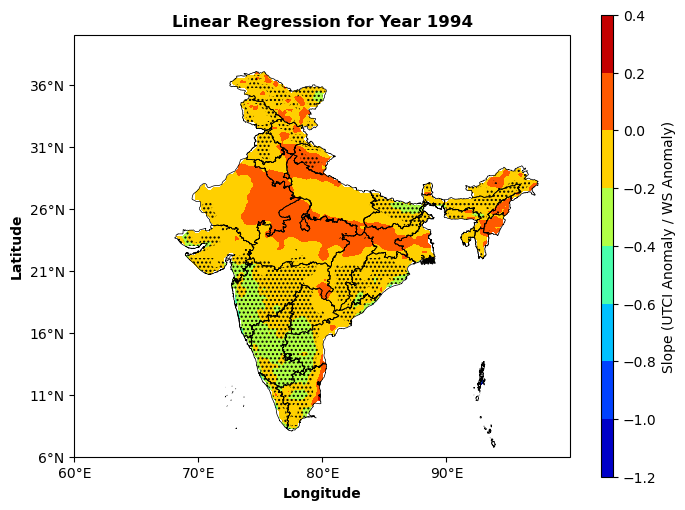

...

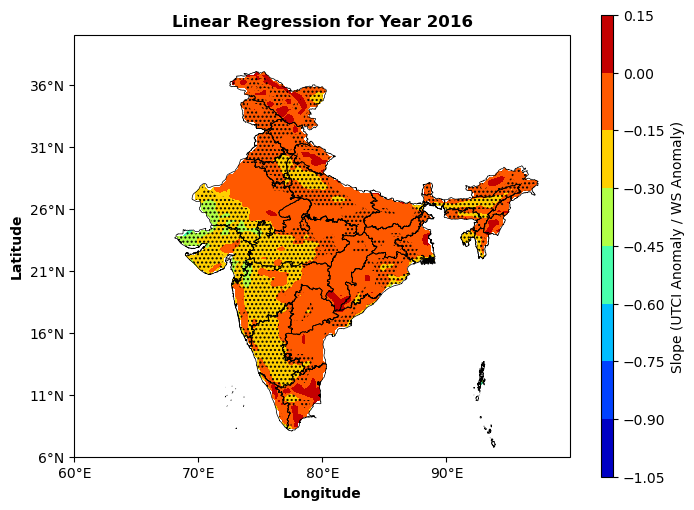

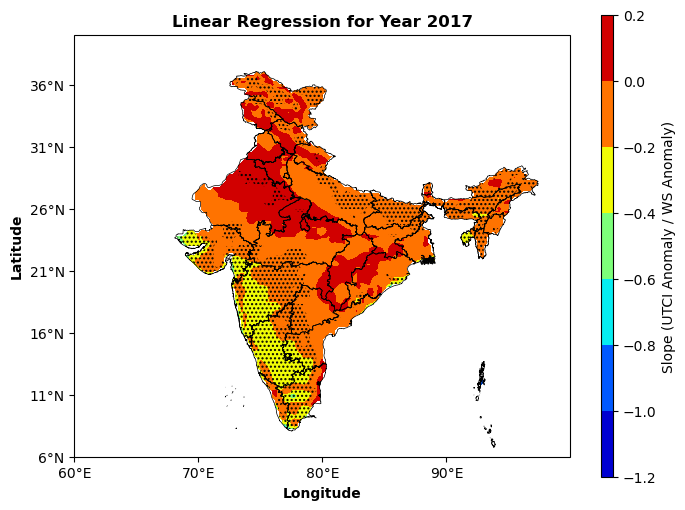

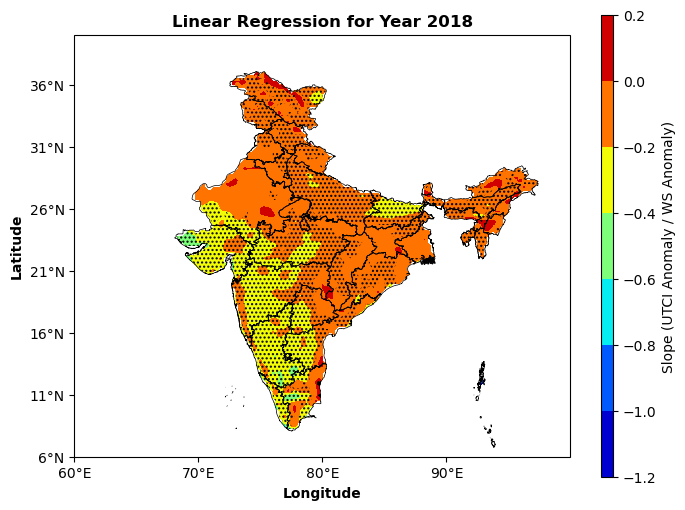

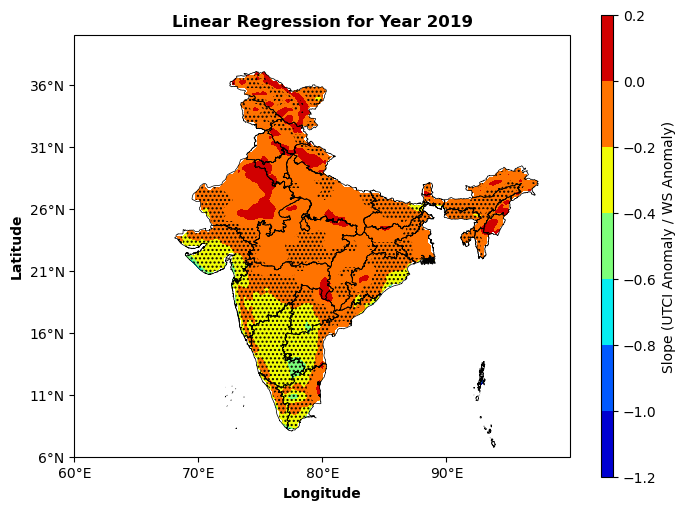

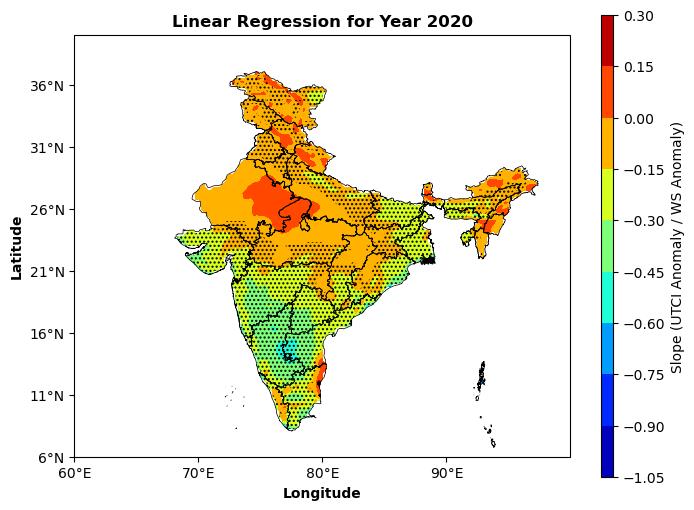

In [51]:
import xarray as xr
import numpy as np
from scipy.stats import linregress
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from shapely.geometry import Point
from shapely.ops import unary_union
from cartopy.io import shapereader as shpreader

# Load the shapefile for India
india_shapefile = shpreader.Reader(r'C:\summer_project\Admin2.shp')
india_geometries = list(india_shapefile.geometries())
india_polygon = unary_union(india_geometries)
shp = cfeature.ShapelyFeature(india_geometries, ccrs.PlateCarree(), facecolor='none', edgecolor='black')

# Function to check if a point is inside India
def is_inside_india(lat, lon, india_polygon):
    point = Point(lon, lat)
    return india_polygon.contains(point)

# Load the datasets
ds1 = xr.open_dataset(r'C:\summer_project\heat_stress\ws_daily_anomaly.nc')
ds2 = xr.open_dataset(r'C:\summer_project\heat_stress\utci_daily_anomaly.nc')

ds1 = ds1['ws'].sel(longitude=slice(60, 100), latitude=slice(6, 40))
ds2 = ds2['utci'].sel(lon=slice(60, 100), lat=slice(6, 40))

# Get coordinates
lats = ds2['lat'].values
lons = ds2['lon'].values

# Create a mask for India
mask = np.zeros((len(lats), len(lons)), dtype=int)
for i, lat in enumerate(lats):
    for j, lon in enumerate(lons):
        if is_inside_india(lat, lon, india_polygon):
            mask[i, j] = 1

# Get the years from the time dimension
years = ds1['time.year'].values
unique_years = np.unique(years)



C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were not used by contour: 'shrink'
  result = super().contourf(*args, **kwargs)
C:\Users\S Narayanaswami\AppData\Roaming\Python\Python311\site-packages\cartopy\mpl\geoaxes.py:1655: UserWarning: The following kwargs were 

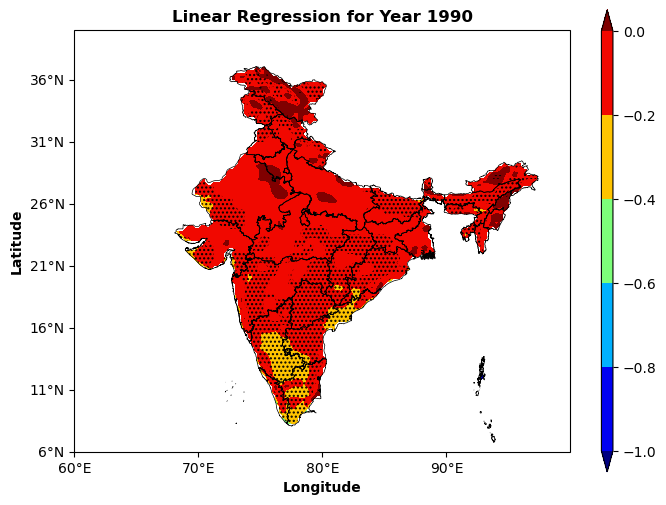

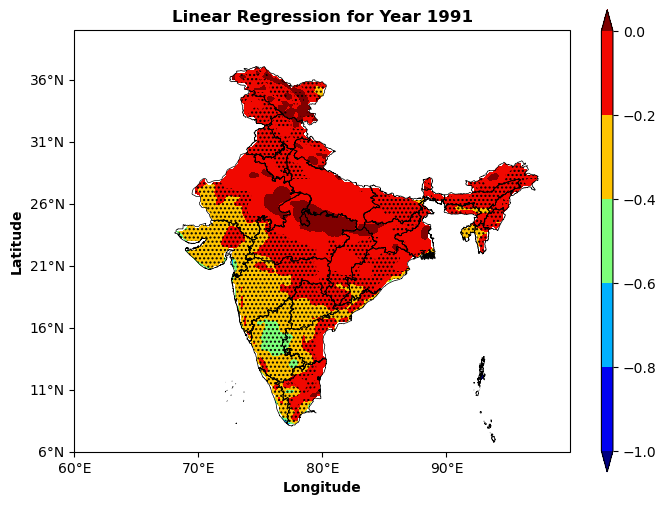

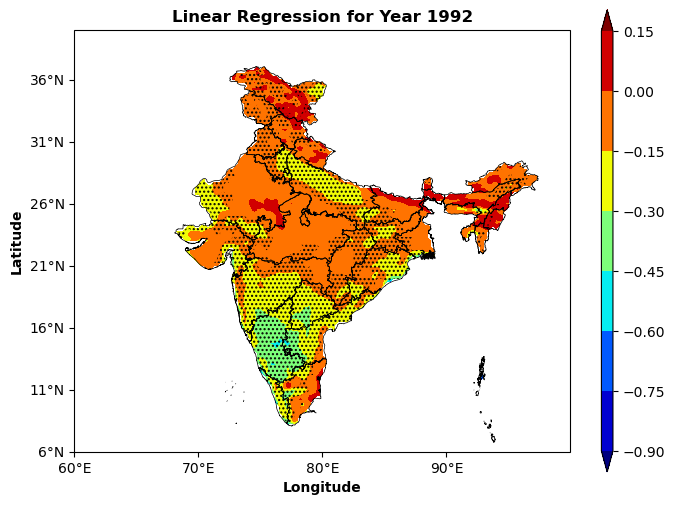

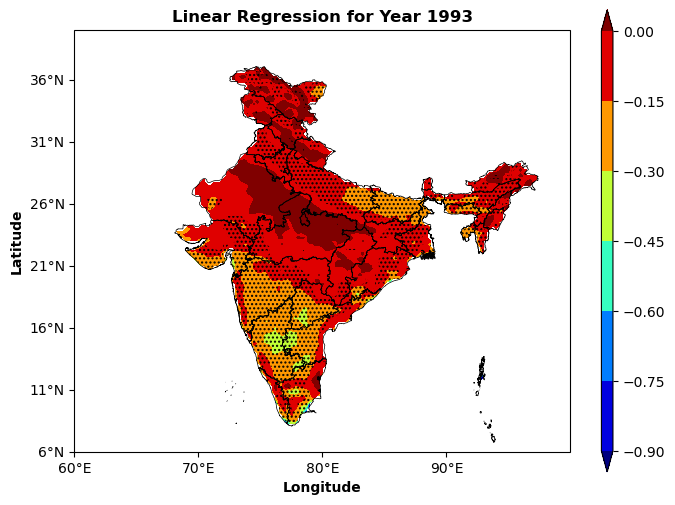

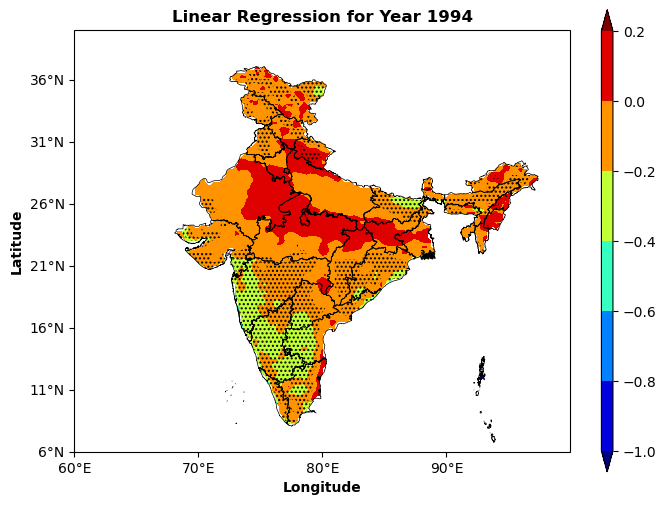

...

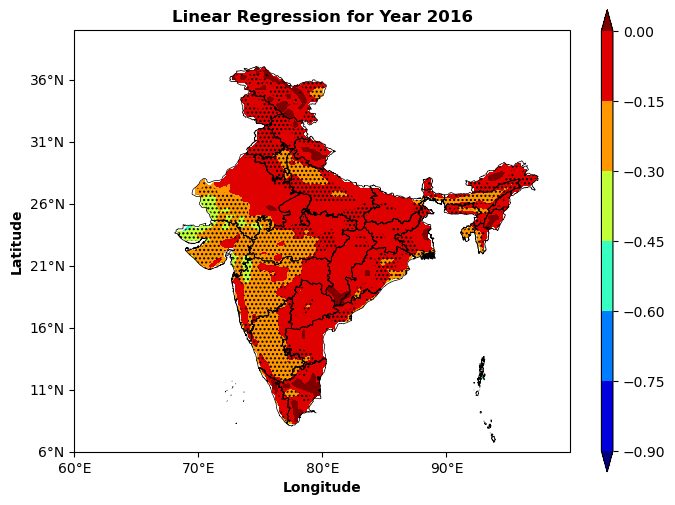

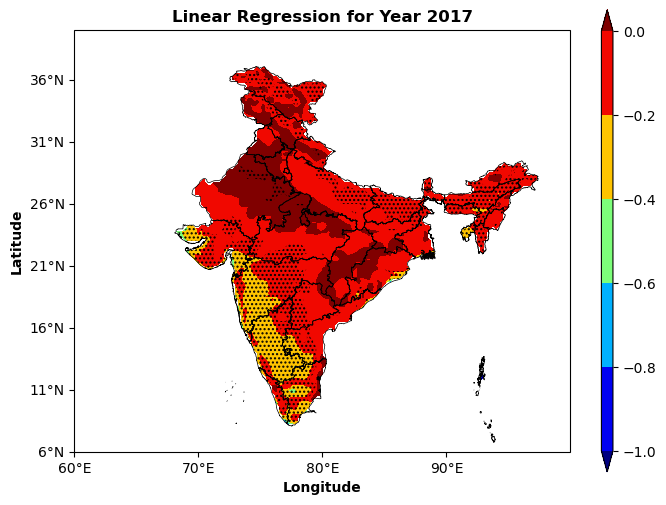

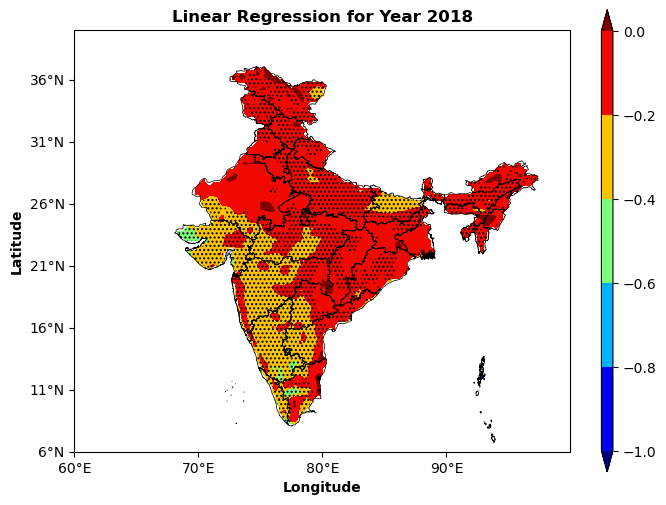

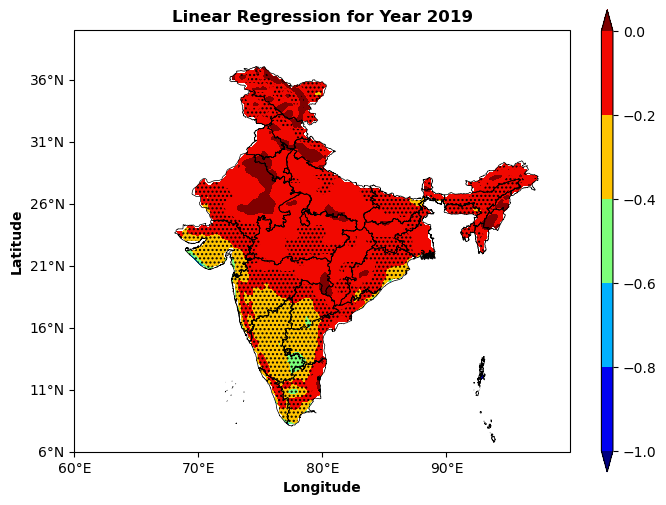

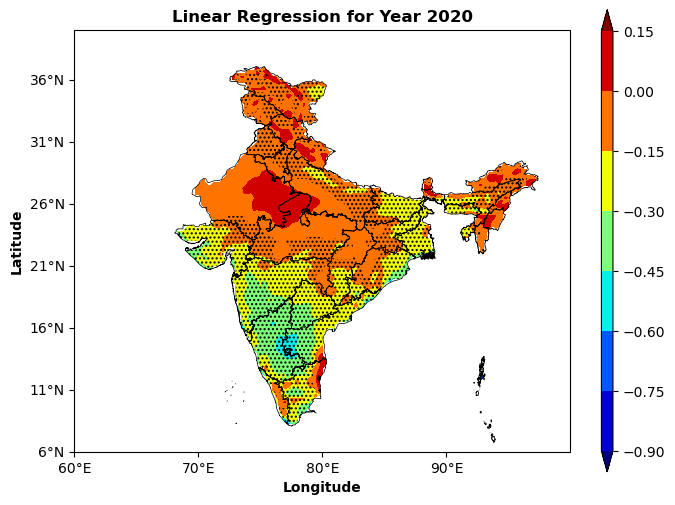

In [92]:
# Loop through each year and create individual plots
for year in unique_years:
    du1 = ds2.sel(time=str(year))
    dw1 = ds1.sel(time=str(year))
    
    # Initialize arrays to store results
    slope = np.zeros((len(lats), len(lons)))
    intercept = np.zeros((len(lats), len(lons)))
    r_value = np.zeros((len(lats), len(lons)))
    p_value = np.zeros((len(lats), len(lons)))
    std_err = np.zeros((len(lats), len(lons)))
    
    # Perform linear regression and store results
    for i in range(len(lats)):
        for j in range(len(lons)):
            slope[i, j], intercept[i, j], r_value[i, j], p_value[i, j], std_err[i, j] = linregress(du1[:, i, j], dw1[:, i, j])
    
    # Apply significance mask and replace non-significant p-values with NaN, and significant ones with 1
    p_value[p_value > 0.01] = np.nan
    p_value[~np.isnan(p_value)] = 1
    
    # Apply the mask to slopes and p-values
    slope = np.where(mask == 1, slope, np.nan)
    p_value = np.where(mask == 1, p_value, np.nan)
    
    # Plotting
    fig, ax = plt.subplots(1, 1, subplot_kw={'projection': ccrs.PlateCarree()}, figsize=(8, 6))
    ax.add_feature(shp, linewidth=0.5)
    pcm = ax.contourf(lons, lats, slope, cmap='jet', extend ='both', shrink=0.75)
    ax.contourf(lons, lats, p_value, hatches=['....'], alpha=0)
    ax.set_title(f'Linear Regression for Year {year}', fontsize=12, weight='bold')
    ax.set_xlabel('Longitude', fontweight='bold')
    ax.set_ylabel('Latitude', fontweight='bold')
    ax.set_xticks(np.arange(60, 100, 10), crs=ccrs.PlateCarree())
    ax.set_yticks(np.arange(6, 40, 5), crs=ccrs.PlateCarree())
    ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: '{:.0f}°E'.format(x)))
    ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda y, _: '{:.0f}°N'.format(y)))
    
    cbar = plt.colorbar(pcm, ax=ax, orientation='vertical', pad=0.05, aspect=40)
    #cbar.set_label('utci(°c)')
    #cbar.set_label('utci(°c)')
    # Add text to the plot
    #ax.text(2, 0.5, 'The spatial variation of change in HI due to the presence of aerosols. Dots indicate the statistical significance of the Student’s t-test at a 90% level.', fontsize=9, color='k', bbox=dict(facecolor='white', alpha=0.5))
  
    #plt.show()
    # Save the plot if needed
    plt.savefig(f'C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_ws_{year}.png', dpi=350)


In [90]:
from PIL import Image
import os

def make_gif(image_paths, output_path, duration=2000):
    """
    Create a GIF animation from a list of image paths.
    
    :param image_paths: List of paths to the image files.
    :param output_path: Path to save the output GIF.
    :param duration: Duration for each frame in milliseconds.
    """
    # Open images and store them in a list
    images = [Image.open(image_path) for image_path in image_paths]
    
    # Save as a GIF
    images[0].save(
        output_path,
        save_all=True,
        append_images=images[1:],
        duration=duration,
        loop=0
    )
    print(f"GIF saved at {output_path}")

# Example usage
if __name__ == "__main__":
    # List of image paths
    image_paths = [
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_1990.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_1991.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_1992.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_1993.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_1994.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_1995.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_1996.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_1997.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_1998.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_1999.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2000.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2001.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2002.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2003.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2004.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2005.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2006.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2007.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2008.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2009.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2010.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2011.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2012.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2013.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2014.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2015.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2016.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2017.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2018.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2019.png",
        "C:/summer_project/sumr_work_fig/utci_WS_regs/regression_utci_rh_2020.png",
    ]

    # Output GIF path
    output_gif_path = "C:/summer_project/sumr_work_fig/animation.gif"
    
    # Create the GIF
    make_gif(image_paths, output_gif_path, duration=2000)


GIF saved at C:/summer_project/sumr_work_fig/animation.gif


In [102]:
from PIL import Image
import os

def make_gif(image_paths, output_path, duration=2000):
    """
    Create a GIF animation from a list of image paths.
    
    :param image_paths: List of paths to the image files.
    :param output_path: Path to save the output GIF.
    :param duration: Duration for each frame in milliseconds.
    """
    # Open images and store them in a list
    images = [Image.open(image_path) for image_path in image_paths]
    
    # Save as a GIF
    images[0].save(
        output_path,
        save_all=True,
        append_images=images[1:],
        duration=duration,
        loop=0
    )
    print(f"GIF saved at {output_path}")

# Example usage
if __name__ == "__main__":
    # Generate list of image paths for years 1990 to 2020
    base_path = "C:/summer_project/sumr_work_fig/utci_rh_regs"
    image_paths = [f"{base_path}/regressio_utci_rh_{year}.png" for year in range(1990, 2021)]

    # Output GIF path
    output_gif_path = "C:/summer_project/sumr_work_fig/utci_rh_regs/utci_rh_linear_regssion1990-20animation.gif"
    
    # Create the GIF
    make_gif(image_paths, output_gif_path, duration=2000)


GIF saved at C:/summer_project/sumr_work_fig/utci_rh_regs/utci_rh_linear_regssion1990-20animation.gif
